In [ ]:
# libraries for querying astro images and processing them
from astroquery.alma import Alma
from astroquery.skyview import SkyView
from astropy.io import fits
from astropy.visualization import astropy_mpl_style
from astropy.modeling import models, fitting
from astropy.convolution import convolve, interpolate_replace_nans
from astropy.convolution import Gaussian2DKernel
from astropy.stats import sigma_clip, sigma_clipped_stats
import os
import skimage
from skimage.filters import *
import numpy as np
from skimage import io, exposure, morphology, filters, feature
from skimage.feature import blob_dog, blob_log, blob_doh
import cv2
from math import sqrt
import scipy.optimize as opt
import statmorph
import photutils
import scipy.ndimage as ndi
import pandas as pd
from scipy import ndimage

# plotting libraries
from matplotlib import pylab
import pylab as py
import matplotlib.pyplot as plt
from matplotlib import colors
import seaborn as sns

# libraries for machine learning
from sklearn import decomposition
from sklearn import preprocessing


# random libraries
import time
import math
import warnings
import pickle

import multiprocessing as mp

plt.style.use(astropy_mpl_style)
sns.reset_orig()

In [3]:
with open('sersic_fits', 'rb') as f:
    sersic_fits = pickle.load(f)
    
# get residual

i = 0

for galaxy, data in sersic_fits.items():
    
    original = data[0]
    model = data[1]
    residual = original - model
    sersic_fits[galaxy].append(residual)
    print(original)
# fig, axes = plt.subplots(25, 8, figsize=(25, 40), sharex=True, sharey=True)
# ax = axes.ravel()

i = 0

# for galaxy, model in sersic_fits.items():
    
#     norm = colors.LogNorm()
#     profile = model[1]
# #     ax[i].set_title(galaxy)
# #     ax[i].imshow(profile, cmap='gray', norm=norm)
    
#     print(i, end='\r')
#     i += 1
#     if i == 200:
#         break
    
# plt.tight_layout()
# plt.show()

[[ 0.07556152  0.00771332  0.05706787 ... -0.01036072 -0.06591797
   0.01431274]
 [-0.01696777  0.02005005 -0.06628418 ...  0.04516602  0.01431274
  -0.02270508]
 [ 0.03857422 -0.04779053  0.00772095 ...  0.03283691 -0.04119873
  -0.01036072]
 ...
 [-0.00431061  0.02658081  0.02038574 ...  0.01464844  0.07641602
  -0.01004028]
 [-0.01048279  0.05126953 -0.01048279 ... -0.034729    0.07641602
   0.02084351]
 [-0.02282715  0.03894043 -0.0166626  ... -0.0038681   0.07641602
   0.0146637 ]]
[[ 3.04565430e-02  1.20697021e-02  1.20697021e-02 ... -9.20410156e-02
  -6.27899170e-03 -3.07922363e-02]
 [-4.30908203e-02 -9.82666016e-02  1.20697021e-02 ...  1.21154785e-02
   2.43530273e-02 -3.07922363e-02]
 [-6.14624023e-02  1.81884766e-02  1.20697021e-02 ... -4.30297852e-02
  -1.85241699e-02 -6.14013672e-02]
 ...
 [ 4.89501953e-02  3.67431641e-02  6.08825684e-03 ... -5.54323196e-05
  -7.36083984e-02 -7.36083984e-02]
 [ 7.34863281e-02 -7.36083984e-02  4.28466797e-02 ... -1.22985840e-02
  -5.51757812

[[-0.010849    0.02157593 -0.01733398 ...  0.00215149 -0.08215332
   0.07348633]
 [ 0.0345459  -0.00436401 -0.02380371 ...  0.11242676 -0.04974365
   0.02810669]
 [ 0.02157593  0.00860596  0.04101562 ...  0.01512146  0.04754639
  -0.01730347]
 ...
 [ 0.01519775 -0.02368164  0.04760742 ... -0.03662109 -0.00422668
  -0.05603027]
 [ 0.07995605  0.06054688  0.05407715 ...  0.02816772 -0.01069641
   0.00874329]
 [-0.01072693  0.02816772  0.00223541 ... -0.0171814   0.00874329
   0.0022583 ]]
[[-0.02105713  0.06518555  0.04364014 ...  0.01669312 -0.04797363
  -0.05511475]
 [-0.00668335  0.0579834  -0.03540039 ... -0.04077148 -0.0838623
  -0.06231689]
 [ 0.14404297  0.07226562 -0.03540039 ... -0.02642822  0.03106689
  -0.06231689]
 ...
 [ 0.00033426 -0.09301758  0.02191162 ... -0.04095459 -0.04089355
  -0.01934814]
 [ 0.05780029  0.0793457   0.00035954 ... -0.04095459 -0.01219177
  -0.06243896]
 [ 0.00751495 -0.02120972  0.01472473 ...  0.01654053 -0.01937866
  -0.11987305]]
[[-0.12463379 -0.

[[ 0.08520508 -0.08093262 -0.11547852 ...  0.11169434 -0.01977539
  -0.01977539]
 [ 0.08520508  0.0229187  -0.00478363 ...  0.00100327 -0.00592804
  -0.03363037]
 [ 0.02984619  0.00906372  0.05059814 ...  0.07019043 -0.0612793
  -0.08203125]
 ...
 [ 0.06384277  0.08459473  0.04998779 ... -0.06170654 -0.03405762
  -0.02716064]
 [ 0.02236938  0.01542664 -0.05371094 ...  0.01437378  0.01437378
   0.06286621]
 [ 0.0569458  -0.03295898 -0.03295898 ...  0.0559082  -0.01330566
  -0.02023315]]
[[-0.00093365 -0.05981445 -0.03363037 ... -0.00642395  0.00667572
   0.00668335]
 [ 0.07104492 -0.03363037  0.02523804 ...  0.02630615 -0.01950073
   0.01977539]
 [ 0.02523804 -0.03363037  0.01217651 ...  0.03936768  0.059021
  -0.05877686]
 ...
 [-0.05285645  0.02566528 -0.06591797 ...  0.02670288  0.0136261
   0.00708771]
 [-0.00704956 -0.03973389  0.05181885 ...  0.03326416 -0.01254272
  -0.01254272]
 [-0.03320312  0.02566528  0.04528809 ...  0.00708008  0.05944824
   0.00055408]]
[[ 0.06628418 -0.040

[[-0.01580811  0.0489502  -0.02874756 ... -0.0023613   0.04296875
  -0.034729  ]
 [-0.02227783  0.03601074 -0.00283813 ... -0.02178955  0.0300293
   0.04943848]
 [-0.00284576 -0.00284195  0.00363922 ...  0.01705933  0.02355957
  -0.00883484]
 ...
 [ 0.07507324  0.06213379  0.05566406 ...  0.04315186  0.03018188
  -0.021698  ]
 [-0.02215576 -0.06109619  0.10107422 ... -0.021698    0.01721191
   0.02371216]
 [-0.02865601  0.01675415  0.00378036 ...  0.01721191  0.03668213
  -0.03466797]]
[[ 0.05493164 -0.00395966  0.01565552 ...  0.04168701 -0.04986572
  -0.03024292]
 [ 0.04840088  0.03527832 -0.04974365 ... -0.01063538  0.02859497
   0.04168701]
 [ 0.02874756 -0.02359009 -0.04974365 ...  0.01551819 -0.0171814
   0.04168701]
 ...
 [ 0.00901794  0.00247955 -0.03674316 ... -0.02371216 -0.0171814
  -0.06298828]
 [ 0.02209473 -0.00405884  0.04168701 ...  0.01553345  0.00898743
  -0.03024292]
 [-0.01715088 -0.02368164  0.04168701 ... -0.03024292 -0.0171814
  -0.03024292]]
[[-0.0657959  -0.001

[[ 0.02703857 -0.04473877 -0.03759766 ...  0.00577545 -0.02294922
  -0.04443359]
 [ 0.03417969  0.04138184  0.06298828 ...  0.00576782 -0.04449463
   0.03448486]
 [-0.00886536  0.02703857 -0.02322388 ... -0.01577759  0.02011108
   0.01295471]
 ...
 [ 0.01977539  0.01977539  0.06994629 ... -0.0446167   0.02716064
   0.02716064]
 [ 0.0413208  -0.00175858  0.05566406 ... -0.00155067  0.04870605
  -0.0446167 ]
 [-0.02328491 -0.00175667  0.01977539 ...  0.01998901 -0.05895996
  -0.01589966]]
[[ 0.02175903 -0.01678467  0.05383301 ...  0.03485107 -0.00369644
  -0.06799316]
 [ 0.01531982  0.00891113  0.04101562 ... -0.01654053 -0.05511475
   0.00915527]
 [ 0.00248337  0.01533508 -0.01036072 ...  0.05413818  0.02200317
  -0.01654053]
 ...
 [-0.09375     0.07312012  0.00895691 ...  0.00917053 -0.04217529
  -0.04217529]
 [ 0.02178955 -0.01029968  0.02178955 ... -0.0229187   0.03485107
  -0.10644531]
 [-0.01029968  0.0153656   0.02819824 ... -0.01008606  0.00275803
   0.00275803]]
[[ 0.01443481 -0

[[ 0.01173401  0.06140137  0.0401001  ... -0.05999756 -0.08129883
   0.03222656]
 [-0.08056641  0.05432129  0.03302002 ...  0.01095581  0.05352783
   0.06774902]
 [-0.0166626   0.02593994  0.0401001  ... -0.03161621  0.01803589
  -0.01034546]
 ...
 [ 0.02560425  0.12524414  0.01849365 ...  0.00349426  0.00349045
  -0.01785278]
 [-0.09533691  0.0682373  -0.04553223 ...  0.08886719  0.08166504
  -0.04632568]
 [-0.00284576  0.09667969 -0.02420044 ...  0.05328369 -0.00362778
   0.0177002 ]]
[[-0.03405762  0.07385254  0.03070068 ... -0.0196228   0.03076172
  -0.06286621]
 [ 0.0091095  -0.04125977 -0.04125977 ...  0.06677246 -0.02682495
  -0.00523376]
 [ 0.00191116 -0.01968384 -0.04846191 ... -0.0196228  -0.01243591
  -0.0196228 ]
 ...
 [-0.03436279 -0.05603027 -0.07043457 ...  0.04504395 -0.02713013
  -0.04876709]
 [-0.06323242 -0.04156494 -0.05603027 ...  0.05950928 -0.04156494
   0.00174522]
 [-0.06323242 -0.04882812 -0.01992798 ... -0.00547028 -0.01989746
  -0.00547028]]
[[-1.34277344e-0

[[ 0.04864502 -0.00056267  0.04248047 ... -0.03137207  0.07312012
   0.0239563 ]
 [-0.01286316 -0.01286316  0.04248047 ... -0.019104    0.01165771
   0.0239563 ]
 [-0.0682373   0.0178833   0.06091309 ... -0.019104    0.0670166
  -0.019104  ]
 ...
 [-0.00694275 -0.01309204  0.02380371 ...  0.00521088  0.04827881
  -0.0501709 ]
 [-0.00694275  0.06072998 -0.04388428 ... -0.00709534  0.04827881
  -0.0378418 ]
 [-0.05615234 -0.08081055 -0.12988281 ...  0.01135254 -0.01940918
   0.09130859]]
[[ 0.0369873  -0.06018066  0.0925293  ...  0.0239563  -0.0246582
   0.0447998 ]
 [-0.04632568 -0.01852417  0.05090332 ... -0.04547119  0.07946777
   0.0239563 ]
 [ 0.04394531 -0.00463867 -0.11572266 ...  0.0378418   0.07946777
   0.11425781]
 ...
 [-0.0322876  -0.0044632   0.02331543 ... -0.01751709 -0.03137207
   0.03112793]
 [-0.08093262  0.03723145  0.07189941 ...  0.01721191  0.01724243
   0.03808594]
 [-0.03918457  0.03723145  0.01638794 ... -0.01748657  0.00334549
   0.04504395]]
[[ 0.04107666  0.0

[[ 0.01992798 -0.0249939  -0.0249939  ...  0.05230713 -0.0054245
  -0.0054245 ]
 [ 0.00067616  0.00067616  0.01992798 ... -0.03753662  0.03308105
  -0.0054245 ]
 [-0.01858521  0.06481934  0.04559326 ...  0.02023315  0.05230713
   0.03948975]
 ...
 [-0.05688477  0.00095463 -0.06970215 ... -0.03729248 -0.03085327
  -0.01797485]
 [ 0.05236816  0.00738525  0.05236816 ...  0.0141449  -0.04370117
  -0.01797485]
 [ 0.05877686 -0.03118896 -0.05047607 ... -0.05010986  0.02700806
  -0.02441406]]
[[ 0.0557251  -0.03265381  0.0241394  ... -0.01394653 -0.00133896
  -0.05181885]
 [-0.02633667 -0.03265381 -0.02633667 ...  0.01757812  0.08068848
  -0.00133896]
 [ 0.03674316  0.03045654 -0.08312988 ... -0.00764465 -0.00133705
   0.00496674]
 ...
 [-0.0262146  -0.01992798 -0.00731659 ...  0.0113678  -0.04541016
   0.03030396]
 [ 0.01161194 -0.00100517 -0.0136261  ... -0.03283691  0.0113678
  -0.03283691]
 [-0.03253174  0.04315186 -0.0136261  ... -0.07702637 -0.05175781
   0.03662109]]
[[ 0.01882935  0.0

[[-1.32751465e-02  2.79541016e-02  5.54199219e-02 ...  9.61914062e-02
   1.09863281e-01  2.05688477e-02]
 [ 1.17309570e-01  8.28857422e-02  9.66796875e-02 ... -4.12597656e-02
  -2.75268555e-02  2.05688477e-02]
 [ 1.10351562e-01  7.60498047e-02  8.28857422e-02 ...  3.43017578e-02
   2.74353027e-02  4.11987305e-02]
 ...
 [ 5.20706177e-04  6.92138672e-02  6.23168945e-02 ...  6.17675781e-02
   6.88171387e-03  1.37481689e-02]
 [ 1.10351562e-01  5.18798828e-04  4.85839844e-02 ...  1.09863281e-01
   2.05993652e-02  4.11987305e-02]
 [ 4.85839844e-02 -8.17871094e-02  4.85839844e-02 ... -6.83593750e-03
   1.03027344e-01  1.75833702e-05]]
[[-0.0748291   0.00455475 -0.06158447 ... -0.08325195 -0.0435791
   0.00270844]
 [-0.11450195 -0.01528931  0.01115417 ... -0.07666016 -0.00389099
   0.09533691]
 [ 0.00456238 -0.04174805 -0.00207138 ...  0.16137695  0.02255249
   0.04901123]
 ...
 [ 0.03143311  0.01818848 -0.02151489 ... -0.08276367 -0.04974365
   0.04943848]
 [-0.0016346   0.06445312 -0.0148925

[[-0.05023193 -0.01992798  0.05889893 ...  0.0055542  -0.01261902
  -0.10961914]
 [ 0.01037598 -0.03808594  0.01039124 ...  0.02978516  0.03588867
   0.04797363]
 [ 0.00431061  0.03460693 -0.06835938 ...  0.04797363  0.03588867
   0.00556946]
 ...
 [-0.00782776  0.01641846  0.04675293 ...  0.10253906 -0.01870728
   0.06616211]
 [-0.06237793  0.04071045  0.02249146 ... -0.06115723  0.07226562
  -0.02478027]
 [ 0.11340332 -0.05029297 -0.05023193 ...  0.04797363 -0.00658417
  -0.05511475]]
[[ 0.02383423 -0.01647949 -0.01647949 ...  0.06555176  0.05218506
  -0.00828552]
 [ 0.03729248 -0.04333496 -0.00975037 ...  0.00513458 -0.04858398
  -0.02172852]
 [ 0.10449219  0.00367737  0.00367737 ...  0.07226562 -0.01499939
  -0.01499939]
 ...
 [-0.05065918 -0.03048706 -0.01705933 ... -0.00222015  0.09179688
   0.03137207]
 [ 0.07702637  0.07702637  0.07702637 ...  0.06494141  0.00450897
  -0.04248047]
 [ 0.00307465 -0.03051758 -0.00362015 ...  0.01119995  0.08508301
   0.03808594]]
[[-0.0083313  -0

[[ 0.04101562 -0.07336426  0.00736237 ... -0.0211792  -0.00773621
   0.01916504]
 [ 0.01411438 -0.03302002  0.00736237 ... -0.05480957  0.00571442
   0.08642578]
 [-0.08679199  0.06115723  0.00063133 ... -0.0211792  -0.0010128
   0.01243591]
 ...
 [-0.07324219  0.08825684 -0.04632568 ... -0.02774048  0.10681152
   0.00588226]
 [-0.10681152  0.06811523 -0.03283691 ... -0.06140137 -0.06811523
  -0.02102661]
 [ 0.00754547  0.01426697 -0.1472168  ... -0.01428223 -0.00756073
   0.01261902]]
[[ 1.6503906e-01  1.5869141e-01  2.5439453e-01 ... -3.8391113e-02
  -8.6069107e-05 -2.5634766e-02]
 [ 1.2695312e-01  1.2695312e-01  1.2048340e-01 ...  6.2942505e-03
  -8.6069107e-05  1.9073486e-02]
 [ 1.2695312e-01  6.2988281e-02  6.2988281e-02 ... -5.1147461e-02
   5.1025391e-02  3.1860352e-02]
 ...
 [ 2.4877930e-01  2.3583984e-01  2.3583984e-01 ... -1.2588501e-02
  -1.2588501e-02  8.9477539e-02]
 [ 2.4877930e-01  3.6376953e-01  2.8076172e-01 ... -1.2588501e-02
   2.5695801e-02  1.8048286e-04]
 [ 5.0390

[[ 0.01989746  0.02639771  0.02639771 ... -0.01228333 -0.03833008
   0.0333252 ]
 [ 0.03942871  0.01989746  0.05249023 ...  0.00074291 -0.01226807
  -0.02529907]
 [ 0.05895996  0.02639771 -0.04522705 ...  0.00074196 -0.01226807
   0.02026367]
 ...
 [-0.00302124  0.01773071  0.07312012 ...  0.02026367  0.00722504
  -0.01882935]
 [-0.00301743  0.01773071 -0.03759766 ...  0.03979492  0.00722504
  -0.0123291 ]
 [ 0.09387207  0.05236816 -0.08605957 ... -0.02536011  0.03326416
   0.00722504]]
[[-0.02423096 -0.03082275  0.06774902 ... -0.03753662 -0.03753662
  -0.00463867]
 [-0.03082275 -0.04394531 -0.01766968 ...  0.00194359 -0.01121521
  -0.07702637]
 [-0.0703125   0.04150391  0.07434082 ...  0.03485107  0.06115723
   0.05456543]
 ...
 [ 0.05474854  0.10754395  0.03491211 ... -0.04449463  0.04150391
   0.00180244]
 [-0.0112915   0.03491211  0.05474854 ... -0.00481415 -0.00481415
  -0.01142883]
 [ 0.02832031  0.07458496 -0.01791382 ...  0.0480957   0.08117676
  -0.0246582 ]]
[[-0.00749207 -0

[[-0.02749634  0.0098877   0.01611328 ...  0.04504395  0.01443481
  -0.04675293]
 [ 0.02233887  0.01611328  0.01611328 ... -0.00390625  0.0083313
  -0.06506348]
 [-0.07116699 -0.03997803 -0.02749634 ... -0.04675293 -0.05285645
   0.01443481]
 ...
 [ 0.10681152  0.00274277  0.00273895 ...  0.02667236  0.05731201
   0.00830078]
 [ 0.07006836  0.07006836  0.08239746 ...  0.00218582 -0.05297852
   0.08178711]
 [ 0.04559326  0.03948975 -0.02789307 ...  0.01445007 -0.05297852
  -0.0100708 ]]
[[-0.00759125 -0.0491333  -0.03533936 ...  0.00346756 -0.10827637
   0.04296875]
 [-0.00066662 -0.03527832 -0.02838135 ... -0.02941895 -0.0557251
   0.04296875]
 [ 0.01318359 -0.05609131  0.02011108 ... -0.02944946 -0.06231689
  -0.0557251 ]
 ...
 [-0.00052452  0.02719116  0.02026367 ...  0.06134033 -0.00108337
   0.07519531]
 [ 0.00640869 -0.01437378 -0.07678223 ... -0.0218811   0.01971436
   0.05438232]
 [ 0.01333618 -0.02130127  0.06182861 ... -0.02880859  0.0682373
   0.03356934]]
[[ 0.01956177  0.00

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[ 0.00730133  0.06219482  0.02102661 ...  0.01306152  0.06103516
   0.04730225]
 [-0.07507324  0.06219482 -0.01329041 ... -0.0006485   0.06103516
   0.06787109]
 [ 0.0072937  -0.03387451 -0.03387451 ... -0.04864502  0.04046631
   0.04046631]
 ...
 [-0.04840088 -0.04840088 -0.03466797 ...  0.00563049  0.00563049
  -0.02182007]
 [-0.0826416   0.04760742 -0.01412964 ... -0.02182007  0.03991699
  -0.02185059]
 [-0.01412964  0.07495117  0.07495117 ... -0.00810242 -0.0904541
  -0.0904541 ]]
[[ 0.0123291   0.05145264  0.02536011 ...  0.00564575 -0.00087452
  -0.00087452]
 [-0.02026367 -0.02026367  0.0123291  ... -0.07910156  0.09692383
  -0.00087452]
 [ 0.01885986 -0.01374817  0.04492188 ... -0.07910156 -0.05950928
   0.04473877]
 ...
 [-0.02667236  0.07116699 -0.0201416  ...  0.01220703 -0.03997803
  -0.07910156]
 [-0.05926514 -0.0723877   0.04510498 ... -0.03997803 -0.02038574
  -0.06604004]
 [ 0.04510498 -0.0723877   0.0581665  ... -0.00735474  0.0447998
  -0.00083351]]
[[-0.0213623   0.0

[[ 0.01309204  0.04522705  0.0131073  ... -0.02423096  0.00793457
  -0.02420044]
 [ 0.01309204  0.05810547 -0.01901245 ... -0.01135254  0.02722168
  -0.02420044]
 [ 0.03240967  0.0131073  -0.05755615 ... -0.00492096 -0.01133728
  -0.01133728]
 ...
 [-0.0116272  -0.03729248  0.07189941 ...  0.00239182  0.04736328
   0.07312012]
 [-0.05657959 -0.03729248  0.05908203 ... -0.04260254 -0.11328125
  -0.11328125]
 [ 0.02694702  0.02694702 -0.06298828 ...  0.10522461 -0.10046387
  -0.0168457 ]]
[[ 0.06799316  0.05407715  0.04022217 ...  0.00944519  0.06481934
   0.00247574]
 [ 0.05413818  0.06103516  0.01251221 ...  0.08569336  0.03717041
   0.04406738]
 [ 0.04724121  0.07495117  0.02639771 ... -0.01133728  0.00942993
   0.00247574]
 ...
 [-0.02185059 -0.00108719 -0.00804138 ...  0.07897949  0.03042603
   0.03735352]
 [ 0.01278687 -0.00801086 -0.04962158 ... -0.01109314  0.02349854
   0.04425049]
 [ 0.03356934 -0.04266357 -0.02880859 ...  0.00970459 -0.04571533
  -0.01803589]]
[[ 0.01383972  0

[[ 0.0324707   0.05218506  0.01931763 ... -0.00699615 -0.03979492
  -0.03979492]
 [ 0.04559326 -0.02661133  0.01931763 ... -0.03979492 -0.12524414
  -0.04638672]
 [ 0.01277161 -0.02661133  0.07836914 ...  0.0061264   0.01269531
  -0.05291748]
 ...
 [ 0.01928711  0.00617218  0.00617218 ...  0.01269531  0.01925659
  -0.02670288]
 [-0.02661133  0.00617218  0.06518555 ... -0.00043774  0.01268005
  -0.02670288]
 [ 0.07177734  0.01928711  0.05206299 ... -0.03326416 -0.00043917
   0.0061264 ]]
[[ 0.5332031   0.5830078   0.69140625 ...  0.0390625   0.00316238
   0.01754761]
 [ 0.56933594  0.62597656  0.74902344 ... -0.07592773 -0.06872559
  -0.08312988]
 [ 0.7050781   0.7558594   0.77734375 ...  0.03192139  0.01036072
   0.04632568]
 ...
 [ 0.02987671  0.02987671 -0.0368042  ... -0.07019043  0.00317764
   0.06311035]
 [ 0.06982422  0.02319336  0.04321289 ...  0.06982422 -0.09008789
   0.02316284]
 [ 0.02319336 -0.01011658  0.07653809 ...  0.04980469 -0.03015137
  -0.01681519]]
[[-0.01296997 -0

[[-0.01693726  0.0222168  -0.08215332 ...  0.03985596  0.02682495
   0.00073147]
 [ 0.03527832  0.00915527 -0.01696777 ...  0.04638672 -0.04492188
  -0.03186035]
 [-0.02346802  0.00914001  0.01568604 ...  0.05291748 -0.01231384
  -0.07751465]
 ...
 [-0.04455566  0.00118637 -0.02496338 ...  0.00576782 -0.00730896
  -0.03997803]
 [-0.04455566  0.02075195  0.00115204 ...  0.02532959 -0.02038574
   0.01223755]
 [ 0.00117111 -0.05761719 -0.02496338 ... -0.03344727 -0.02038574
  -0.01387024]]
[[-0.00704193  0.01281738  0.02606201 ... -0.03985596 -0.07299805
  -0.05310059]
 [-0.04675293  0.01281738  0.03271484 ... -0.07299805 -0.00673676
   0.00650787]
 [ 0.03930664  0.07897949  0.02606201 ... -0.07299805  0.00650787
  -0.05969238]
 ...
 [ 0.01980591  0.01980591 -0.08618164 ... -0.00648499  0.02001953
  -0.09912109]
 [ 0.02642822  0.04626465 -0.01992798 ... -0.03961182 -0.00647736
  -0.00647736]
 [ 0.09265137  0.03967285  0.03967285 ...  0.01338196 -0.00647736
   0.02664185]]
[[ 0.05047607  0

[[-0.0194397   0.01399231  0.00061893 ... -0.08007812  0.02035522
   0.06048584]
 [-0.01274109  0.00062561 -0.05957031 ...  0.00697327  0.02703857
  -0.05328369]
 [ 0.0006361   0.04077148  0.04077148 ...  0.01367188  0.03375244
  -0.09338379]
 ...
 [-0.07617188 -0.0088501  -0.01556396 ...  0.00108528 -0.07922363
   0.0010891 ]
 [ 0.05169678 -0.05596924 -0.04925537 ...  0.00109291  0.07470703
   0.0010891 ]
 [-0.02233887 -0.05596924  0.03826904 ... -0.03234863 -0.0925293
  -0.00559235]]
[[-0.04193115 -0.08679199  0.05432129 ...  0.03460693 -0.02957153
  -0.02960205]
 [ 0.00299072  0.06072998  0.03503418 ... -0.03594971  0.00250244
   0.00250626]
 [-0.06109619 -0.02267456  0.06713867 ... -0.02954102 -0.00390244
   0.07946777]
 ...
 [-0.07873535  0.00461578 -0.00179672 ... -0.0345459  -0.11157227
  -0.04736328]
 [ 0.03030396  0.03030396 -0.06591797 ... -0.08581543  0.06811523
  -0.01528931]
 [-0.08520508 -0.08520508 -0.06591797 ...  0.05529785  0.03601074
   0.09375   ]]
[[-0.09936523  0.

[[ 0.02407837  0.05926514 -0.04632568 ...  0.015625    0.02264404
  -0.00549316]
 [-0.01815796 -0.03222656 -0.03930664 ... -0.00547791 -0.04064941
  -0.13208008]
 [ 0.02407837 -0.00409698 -0.01818848 ...  0.06481934 -0.04766846
   0.00153542]
 ...
 [ 0.00271988  0.02944946 -0.05743408 ...  0.05023193 -0.00606537
  -0.04125977]
 [-0.02401733 -0.01733398  0.02944946 ... -0.07641602  0.05023193
   0.05023193]
 [ 0.02276611  0.06958008 -0.03741455 ...  0.01504517 -0.06945801
  -0.02017212]]
[[ 0.02835083 -0.02920532 -0.02279663 ... -0.0163269  -0.00355911
  -0.00993347]
 [-0.04199219 -0.04199219  0.10510254 ... -0.00355911  0.034729
   0.00282288]
 [-0.01000977  0.06665039 -0.02279663 ... -0.02270508 -0.02908325
  -0.0035553 ]
 ...
 [-0.0098877   0.03479004  0.07946777 ...  0.13061523  0.09228516
   0.0604248 ]
 [-0.00987244 -0.06091309  0.03479004 ...  0.00299835 -0.02252197
  -0.02252197]
 [-0.03540039  0.05395508 -0.03540039 ...  0.00299835  0.1114502
  -0.0161438 ]]
[[-3.2165527e-02 -6

[[ 0.00696564  0.02072144 -0.0274353  ... -0.00814819  0.07434082
   0.01245117]
 [-0.02053833  0.06884766 -0.03430176 ...  0.0262146   0.01245117
  -0.0012989 ]
 [ 0.01383972 -0.01367188 -0.00679779 ... -0.00814819 -0.00816345
   0.01245117]
 ...
 [ 0.01864624 -0.04473877 -0.0657959  ...  0.01036072  0.01034546
   0.05255127]
 [-0.03765869  0.07495117 -0.03063965 ... -0.01074219 -0.04589844
   0.10180664]
 [ 0.07495117  0.01159668 -0.03063965 ... -0.01779175 -0.02481079
  -0.05297852]]
[[-0.01278687 -0.01278687 -0.07067871 ... -0.03875732  0.00621033
  -0.01950073]
 [ 0.02575684  0.03863525  0.04504395 ... -0.01307678 -0.01950073
   0.01263428]
 [ 0.03863525  0.01292419 -0.01278687 ...  0.01907349 -0.00021887
  -0.0066452 ]
 ...
 [-0.02023315  0.00759888  0.00063992 ... -0.05175781 -0.0324707
   0.01246643]
 [-0.02023315  0.10498047  0.10498047 ...  0.03173828  0.03173828
   0.0703125 ]
 [-0.00631714  0.02151489 -0.02719116 ...  0.02529907 -0.00037718
   0.09594727]]
[[-6.8603516e-02 

[[-0.00441742 -0.02526855 -0.02526855 ... -0.01092529  0.00296783
  -0.01092529]
 [ 0.01644897 -0.0113678  -0.02526855 ...  0.00297165  0.00991821
   0.00991821]
 [ 0.0581665  -0.0670166  -0.03222656 ... -0.0526123  -0.01785278
  -0.01785278]
 ...
 [ 0.08605957 -0.02508545  0.00967407 ... -0.01760864  0.01019287
   0.01019287]
 [ 0.08605957  0.04443359  0.00967407 ... -0.05236816 -0.12890625
   0.05187988]
 [ 0.03051758 -0.01812744 -0.03894043 ... -0.01760864 -0.00370407
   0.03106689]]
[[-0.05395508 -0.05395508  0.02288818 ... -0.00299454 -0.02224731
  -0.02224731]
 [ 0.05493164 -0.02835083 -0.07958984 ...  0.04833984  0.00341415
  -0.01583862]
 [-0.05395508  0.01647949 -0.07958984 ... -0.00941467  0.03546143
  -0.02224731]
 ...
 [ 0.02246094  0.00323868  0.00323868 ...  0.0670166   0.0670166
   0.21435547]
 [ 0.07373047  0.00323868  0.03527832 ...  0.04144287  0.0670166
   0.12475586]
 [-0.02880859  0.03527832  0.06085205 ...  0.04144287  0.0670166
   0.06066895]]
[[ 0.02740479 -0.06

[[-0.02871704  0.01544189  0.00912476 ... -0.01748657  0.00772095
  -0.03643799]
 [ 0.00914001  0.01544189  0.09741211 ... -0.04272461  0.03924561
   0.00770569]
 [-0.03503418 -0.00979614  0.05957031 ... -0.00489044  0.01402283
   0.02664185]
 ...
 [-0.01620483 -0.04772949  0.02792358 ...  0.00761414  0.03283691
   0.01390076]
 [-0.01620483 -0.03509521 -0.02252197 ... -0.05541992  0.07067871
  -0.0491333 ]
 [ 0.02792358  0.05944824 -0.00990295 ...  0.06433105  0.01391602
  -0.16894531]]
[[ 4.6337891e-01  8.0566406e-01  1.0273438e+00 ...  1.3000488e-02
   6.6894531e-02 -1.3977051e-02]
 [ 3.1542969e-01  5.8398438e-01  1.8203125e+00 ... -4.0954590e-02
   2.6458740e-02  2.6458740e-02]
 [ 4.1650391e-01  1.0214844e+00  2.2500000e+00 ... -2.0721436e-02
   3.3203125e-02  6.0180664e-02]
 ...
 [-4.1015625e-02 -1.4175415e-02 -7.4768066e-04 ...  1.4678955e-02
  -4.8599243e-03  1.6555786e-03]
 [-1.2841797e-01 -7.4672699e-04 -7.4768066e-04 ... -4.8675537e-03
   1.6536713e-03  2.1209717e-02]
 [ 5.973

[[-0.01574707  0.03985596  0.03985596 ... -0.02276611 -0.01580811
  -0.00886536]
 [ 0.02597046  0.03985596  0.06072998 ...  0.01199341 -0.02972412
   0.0050354 ]
 [-0.00185394 -0.00185394 -0.02270508 ...  0.05371094  0.15112305
   0.10241699]
 ...
 [-0.02264404  0.11633301  0.109375   ...  0.05371094  0.03289795
  -0.03656006]
 [-0.02264404  0.07458496  0.01208496 ...  0.03289795  0.06066895
  -0.02270508]
 [ 0.15112305  0.07458496  0.06762695 ... -0.02270508  0.01898193
  -0.00880432]]
[[ 0.05834961 -0.07629395 -0.0223999  ...  0.06433105  0.06433105
  -0.02316284]
 [ 0.03814697 -0.03588867 -0.0022316  ...  0.04412842  0.0037384
  -0.01644897]
 [-0.00222778 -0.00222778  0.03143311 ... -0.01644897 -0.01644897
   0.05755615]
 ...
 [-0.00300217 -0.00300217  0.05084229 ...  0.05004883 -0.03741455
   0.05004883]
 [ 0.0171814   0.12487793  0.00371552 ...  0.04333496  0.0567627
  -0.09130859]
 [-0.00300598 -0.02993774  0.0037117  ... -0.03741455 -0.04418945
   0.0567627 ]]
[[-6.0577393e-03 -

[[ 0.04046631 -0.01751709 -0.03686523 ... -0.01724243  0.07299805
  -0.01080322]
 [ 0.05975342 -0.09484863  0.00179863 ...  0.04718018  0.0085144
   0.02783203]
 [-0.01754761  0.046875   -0.01109314 ...  0.0085144   0.02783203
  -0.00436401]
 ...
 [-0.03057861 -0.05633545  0.02093506 ... -0.07531738  0.02764893
  -0.03674316]
 [ 0.03381348 -0.11425781 -0.0305481  ...  0.12414551  0.0083313
  -0.03027344]
 [ 0.02093506 -0.0177002  -0.06274414 ... -0.01097107  0.04693604
   0.05340576]]
[[ 0.01766968  0.02993774 -0.01303101 ...  0.06665039  0.03588867
   0.01745605]
 [-0.01916504 -0.10510254  0.01150513 ... -0.05010986  0.02975464
   0.02359009]
 [-0.00076294 -0.00076294 -0.06213379 ... -0.05010986  0.03588867
   0.02975464]
 ...
 [ 0.04193115  0.01733398 -0.05041504 ...  0.04772949 -0.12451172
  -0.00762177]
 [ 0.06652832  0.01733398 -0.0196228  ...  0.04772949 -0.07531738
   0.06005859]
 [ 0.02346802  0.06652832 -0.0196228  ... -0.04455566 -0.07531738
   0.04156494]]
[[ 0.03460693 -0.0

[[-0.04284668  0.09143066 -0.00927734 ...  0.01081848  0.01751709
   0.01751709]
 [ 0.03100586  0.01086426 -0.02270508 ...  0.04437256 -0.00932312
  -0.04290771]
 [ 0.07800293 -0.03613281 -0.05627441 ... -0.00932312 -0.02947998
   0.00410461]
 ...
 [ 0.04437256 -0.04290771 -0.00933838 ... -0.05639648 -0.01608276
   0.01075745]
 [-0.02947998 -0.02276611 -0.04290771 ...  0.02420044 -0.00266266
  -0.0093689 ]
 [-0.00933838 -0.00933838 -0.01605225 ...  0.01748657  0.03091431
   0.01748657]]
[[ 0.04901123  0.00866699  0.00193977 ...  0.01489258  0.00817871
   0.02160645]
 [-0.02493286  0.02883911 -0.01821899 ...  0.03503418  0.06195068
   0.00144196]
 [ 0.00866699  0.01538086  0.04901123 ...  0.03503418 -0.00527954
   0.05523682]
 ...
 [ 0.12268066  0.04205322 -0.02511597 ...  0.14892578  0.12219238
   0.06848145]
 [ 0.03533936  0.10253906  0.05554199 ...  0.07519531  0.08190918
   0.06170654]
 [ 0.0958252  -0.01167297  0.05548096 ...  0.05499268  0.14892578
   0.03485107]]
[[ 0.03820801  0

[[ 0.02038574  0.12988281  0.00667572 ...  0.07495117 -0.02774048
   0.00650787]
 [ 0.12316895  0.11633301  0.11633301 ...  0.02020264 -0.00719452
   0.02020264]
 [ 0.02038574  0.08886719  0.04779053 ...  0.06811523  0.02020264
   0.02020264]
 ...
 [ 0.08898926  0.02731323  0.02731323 ...  0.10253906  0.08874512
   0.02713013]
 [-0.03436279  0.02044678 -0.02749634 ... -0.02081299  0.02029419
   0.08874512]
 [ 0.0546875   0.02044678  0.02044678 ...  0.06140137  0.0682373
   0.13671875]]
[[-0.05761719  0.04083252  0.0211792  ...  0.10070801  0.05474854
  -0.01742554]
 [ 0.04083252 -0.01821899  0.02774048 ...  0.05474854 -0.01087952
   0.08764648]
 [ 0.01460266 -0.03790283 -0.01821899 ...  0.05474854  0.10070801
   0.02850342]
 ...
 [ 0.17236328  0.16577148  0.17895508 ...  0.06152344  0.14038086
   0.07470703]
 [ 0.23803711  0.15917969  0.07385254 ...  0.00900269 -0.01068115
   0.06811523]
 [ 0.26416016  0.1459961   0.15917969 ...  0.02871704  0.01557922
   0.09436035]]
[[-0.04467773 -0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[ 0.10693359  0.00242996  0.02859497 ... -0.05255127 -0.08093262
   0.03253174]
 [ 0.10693359  0.00897217 -0.07592773 ...  0.02545166 -0.00291443
  -0.05969238]
 [-0.02368164 -0.06945801 -0.06945801 ...  0.02545166  0.03253174
   0.01837158]
 ...
 [-0.12646484  0.06286621 -0.04162598 ... -0.01011658 -0.05981445
  -0.07397461]
 [-0.06121826  0.00409698  0.00409698 ... -0.03143311  0.0040741
  -0.07397461]
 [-0.00895691 -0.00895691  0.0171814  ... -0.09533691  0.03955078
  -0.01721191]]
[[-0.03857422  0.09960938  0.06665039 ... -0.00576782 -0.03210449
  -0.03210449]
 [-0.10437012 -0.03198242 -0.05175781 ... -0.04528809  0.0534668
  -0.01234436]
 [-0.10437012 -0.01882935 -0.04516602 ... -0.03210449  0.01397705
   0.0534668 ]
 ...
 [-0.03204346 -0.01231384  0.00739288 ...  0.0401001   0.0401001
   0.00724792]
 [ 0.05340576  0.08630371  0.0402832  ...  0.07958984 -0.06506348
   0.05981445]
 [-0.03863525  0.00082397 -0.03863525 ...  0.02038574  0.01382446
  -0.03875732]]
[[-0.00390625  0.01

[[ 0.00474548 -0.02008057  0.00475311 ...  0.03179932 -0.07617188
   0.05718994]
 [ 0.01095581 -0.02627563 -0.00145149 ...  0.05084229  0.06347656
   0.00637817]
 [ 0.0357666   0.04199219  0.02337646 ...  0.01907349  0.06994629
  -0.05078125]
 ...
 [-0.02645874  0.08532715  0.04803467 ...  0.01733398  0.0049057
   0.04833984]
 [ 0.02319336 -0.04510498  0.06665039 ... -0.05712891  0.02972412
   0.01733398]
 [-0.00784302 -0.00162888  0.04803467 ...  0.11035156  0.01730347
   0.11035156]]
[[ 1.38244629e-02  1.19060278e-05 -2.76184082e-02 ... -3.47290039e-02
   1.36108398e-02  6.70623779e-03]
 [ 6.91223145e-03  5.52368164e-02  3.45458984e-02 ... -8.30078125e-02
   4.11987305e-02 -2.78015137e-02]
 [ 2.07214355e-02 -2.76184082e-02  6.91223145e-03 ...  6.70623779e-03
   2.05078125e-02 -4.16259766e-02]
 ...
 [-4.13208008e-02  4.83398438e-02  7.16447830e-05 ...  1.36871338e-02
  -7.00378418e-03  6.88476562e-02]
 [ 1.38702393e-02  4.83398438e-02  1.38702393e-02 ...  6.79016113e-03
   4.12597656e

[[-0.02062988  0.00630951 -0.02734375 ... -0.0006752  -0.00740814
   0.01953125]
 [-0.06774902 -0.02062988  0.02651978 ...  0.05316162  0.03973389
   0.00605774]
 [ 0.02651978  0.00631714  0.01304626 ...  0.06665039  0.05322266
   0.01953125]
 ...
 [-0.08764648  0.0335083   0.0604248  ... -0.04754639  0.04669189
  -0.00043821]
 [-0.02035522  0.02001953 -0.01364136 ... -0.03405762  0.05340576
  -0.07446289]
 [-0.04730225  0.04022217  0.0604248  ...  0.01974487 -0.04754639
  -0.05426025]]
[[ 4.4580078e-01  5.0390625e-01  6.5234375e-01 ...  3.4606934e-02
  -6.7504883e-02 -1.9897461e-02]
 [ 7.4902344e-01  8.1347656e-01  9.9414062e-01 ... -4.0344238e-02
   2.0965576e-02  2.0965576e-02]
 [ 1.3945312e+00  1.3808594e+00  1.1562500e+00 ... -6.2637329e-03
   3.4606934e-02 -4.7119141e-02]
 ...
 [-6.3232422e-02  5.6648254e-04  5.1635742e-02 ... -4.0222168e-02
   3.4729004e-02 -4.0222168e-02]
 [-3.7719727e-02  2.6092529e-02 -9.5214844e-02 ...  7.4462891e-03
   2.1057129e-02 -6.1798096e-03]
 [-5.047

[[ 0.05664062  0.02883911  0.04968262 ...  0.05480957 -0.05218506
  -0.05218506]
 [ 0.11230469  0.04968262  0.08447266 ...  0.01200867 -0.00225449
  -0.00226212]
 [ 0.11230469  0.00799561  0.08447266 ... -0.03790283 -0.03079224
  -0.00939941]
 ...
 [-0.01292419 -0.00596619  0.10522461 ...  0.01855469 -0.01705933
   0.00429535]
 [ 0.09130859  0.03570557  0.03570557 ...  0.02566528 -0.06689453
   0.00429535]
 [ 0.01487732 -0.02682495  0.02877808 ...  0.02566528  0.03991699
   0.04699707]]
[[ 0.01589966 -0.00367737  0.08129883 ...  0.02310181  0.12109375
   0.19946289]
 [ 0.09423828  0.05511475 -0.04937744 ...  0.07531738  0.05578613
   0.25830078]
 [-0.02981567 -0.03631592 -0.04937744 ... -0.01611328  0.06884766
   0.1538086 ]
 ...
 [ 0.02929688 -0.11437988  0.08154297 ... -0.11376953 -0.01574707
  -0.02227783]
 [ 0.08813477  0.11425781  0.09460449 ...  0.00384903  0.06262207
   0.02346802]
 [-0.02947998  0.00971985  0.03582764 ...  0.05615234 -0.00921631
   0.02999878]]
[[-0.03186035 -0

[[ 0.0269165   0.02011108 -0.06835938 ...  0.07202148 -0.10656738
  -0.03509521]
 [ 0.01332092  0.03375244  0.01333618 ... -0.07080078 -0.03509521
   0.02203369]
 [ 0.0201416   0.05419922 -0.000278   ... -0.01367188  0.05773926
  -0.02081299]
 ...
 [ 0.05383301  0.00634003  0.00634003 ... -0.05621338  0.00090599
   0.04370117]
 [-0.09545898  0.06060791 -0.01402283 ... -0.00622559  0.03662109
  -0.06335449]
 [-0.04119873  0.09460449 -0.06835938 ... -0.04193115  0.00804138
  -0.02050781]]
[[-0.03997803 -0.02554321 -0.0904541  ...  0.02630615  0.00466156
   0.00466919]
 [ 0.01773071 -0.00390625 -0.01831055 ... -0.00255966 -0.06030273
   0.0118866 ]
 [-0.01112366 -0.03277588  0.0682373  ... -0.01699829  0.05517578
  -0.03143311]
 ...
 [ 0.04675293  0.00352478 -0.06860352 ...  0.05529785 -0.00235748
   0.0480957 ]
 [ 0.01794434 -0.09741211 -0.02529907 ... -0.04559326  0.01925659
  -0.009552  ]
 [ 0.00351715  0.00352478  0.03234863 ...  0.00484467 -0.05999756
  -0.05279541]]
[[ 0.02224731  0

[[ 0.00482941  0.05401611 -0.04437256 ...  0.07507324 -0.00225449
   0.03991699]
 [ 0.03295898  0.01889038  0.08911133 ...  0.004776   -0.00225449
  -0.01629639]
 [ 0.00482941  0.02590942  0.01889038 ...  0.004776    0.004776
  -0.01629639]
 ...
 [-0.06207275 -0.02865601 -0.03533936 ... -0.00923157 -0.00923157
   0.08203125]
 [ 0.04486084  0.01812744  0.07824707 ...  0.06799316  0.06799316
   0.04693604]
 [ 0.05151367  0.01812744 -0.07543945 ...  0.11706543 -0.04431152
  -0.00221634]]
[[-0.00129128 -0.00129509  0.02664185 ...  0.15185547  0.08203125
   0.08898926]
 [-0.02224731  0.03356934  0.03356934 ...  0.02612305  0.012146
   0.00515747]
 [-0.00828552  0.01266479 -0.03619385 ... -0.02975464  0.012146
   0.00515747]
 ...
 [-0.02270508 -0.00875854  0.01913452 ... -0.00222015  0.08850098
   0.0256958 ]
 [ 0.10986328  0.10986328  0.08190918 ...  0.10253906  0.08154297
   0.06060791]
 [ 0.01913452  0.01913452 -0.03668213 ...  0.10253906  0.1652832
   0.12341309]]
[[-0.00580597 -0.034362

[[ 0.00247574  0.01596069  0.12390137 ... -0.07958984  0.04846191
   0.06872559]
 [ 0.06994629 -0.04473877 -0.03125    ... -0.07958984 -0.01222229
  -0.02572632]
 [-0.00428772  0.04968262  0.04968262 ...  0.08886719 -0.01223755
   0.06860352]
 ...
 [ 0.05999756  0.05999756  0.034729   ... -0.06359863  0.02429199
   0.04937744]
 [-0.04724121 -0.03466797  0.034729   ... -0.02590942  0.09326172
   0.01800537]
 [ 0.00320816  0.01583862 -0.02203369 ...  0.0682373  -0.0196228
   0.04309082]]
[[ 0.03338623  0.01242065  0.01242065 ... -0.00830078 -0.07116699
   0.03363037]
 [ 0.04034424 -0.01551819 -0.01551819 ...  0.01266479  0.00567627
   0.01965332]
 [-0.03649902  0.05432129  0.01242065 ... -0.00830078  0.02664185
   0.0056839 ]
 ...
 [ 0.03344727 -0.02243042 -0.0014801  ...  0.01971436  0.01971436
  -0.00820923]
 [ 0.01947021 -0.02941895 -0.02941895 ... -0.00123215  0.01272583
   0.02670288]
 [ 0.00550079 -0.02941895 -0.02243042 ... -0.00820923  0.01272583
   0.03369141]]
[[ 0.06408691  0.

[[-0.00971985 -0.02368164  0.03216553 ...  0.04754639  0.03430176
   0.01449585]
 [-0.01669312  0.01123047  0.03216553 ... -0.08459473  0.00127983
   0.00788879]
 [ 0.04614258 -0.0027504  -0.04467773 ... -0.01193237 -0.00533295
  -0.01194763]
 ...
 [ 0.01763916  0.00368881  0.03161621 ...  0.06085205 -0.09118652
  -0.03826904]
 [-0.00329208  0.04559326  0.01065063 ... -0.03167725  0.06750488
   0.00135803]
 [-0.02426147 -0.02426147 -0.01727295 ...  0.0211792   0.0211792
   0.00135803]]
[[-0.01641846  0.02462769  0.00409698 ...  0.02352905 -0.01063538
  -0.05847168]
 [-0.03009033 -0.00273514  0.05200195 ...  0.00987244 -0.03796387
  -0.05847168]
 [ 0.02462769 -0.01641846 -0.01641846 ... -0.05163574 -0.02432251
   0.00302124]
 ...
 [-0.03723145  0.01760864  0.00389481 ... -0.07263184  0.02334595
  -0.07263184]
 [ 0.00390625 -0.0715332   0.01075745 ...  0.0302124  -0.00408936
   0.03704834]
 [-0.00294113  0.00390244 -0.0166626  ... -0.0246582   0.0302124
  -0.01095581]]
[[-0.07739258  0.0

[[ 0.02963257  0.06860352 -0.08093262 ...  0.14135742  0.12194824
   0.08947754]
 [ 0.07519531 -0.06787109  0.0491333  ...  0.06994629  0.08288574
  -0.0145874 ]
 [ 0.06860352  0.08166504  0.07519531 ...  0.04388428 -0.02108765
   0.06335449]
 ...
 [ 0.02288818 -0.05517578 -0.04864502 ...  0.02416992  0.01116943
  -0.02786255]
 [-0.09423828 -0.02264404 -0.08117676 ...  0.01115417 -0.03436279
  -0.08642578]
 [ 0.02288818  0.04241943 -0.02264404 ...  0.03717041  0.01116943
  -0.07336426]]
[[ 0.01391602 -0.00531769 -0.01173401 ...  0.02050781  0.01408386
   0.01408386]
 [-0.02456665  0.00750732 -0.02453613 ... -0.00514984  0.01408386
  -0.03079224]
 [-0.06298828  0.07165527 -0.04376221 ... -0.05004883  0.03973389
   0.04614258]
 ...
 [-0.03125     0.03955078 -0.08276367 ...  0.          0.
   0.        ]
 [-0.02481079 -0.01193237  0.07177734 ...  0.          0.
   0.        ]
 [ 0.02667236  0.0138092   0.04602051 ...  0.          0.
   0.        ]]
[[ 0.00279999  0.00279617  0.07849121 ..

[[-0.04638672  0.03570557 -0.03955078 ...  0.03485107  0.02111816
  -0.03369141]
 [-0.01217651  0.04943848 -0.08752441 ...  0.02111816 -0.04742432
  -0.04742432]
 [ 0.04943848  0.00149918 -0.03271484 ...  0.02111816  0.0279541
  -0.04052734]
 ...
 [ 0.06958008 -0.01254272  0.06958008 ... -0.0133667   0.05505371
   0.0892334 ]
 [ 0.06958008 -0.01252747  0.03540039 ... -0.0133667   0.05505371
  -0.04760742]
 [ 0.02853394  0.00115204  0.00115204 ... -0.00653076  0.01399231
   0.02767944]]
[[ 0.02905273 -0.03137207 -0.04486084 ...  0.00174904 -0.0184021
  -0.07214355]
 [-0.04486084  0.0559082  -0.01797485 ...  0.06219482 -0.03851318
   0.01516724]
 [-0.01124573  0.02233887 -0.00453949 ... -0.04522705  0.01516724
   0.01516724]
 ...
 [ 0.04876709  0.03533936 -0.08569336 ... -0.01870728  0.03509521
   0.02835083]
 [-0.01171875  0.00172615 -0.01843262 ... -0.03887939 -0.07922363
   0.00145149]
 [ 0.0218811   0.00843811  0.0218811  ...  0.02160645 -0.05236816
  -0.01200867]]
[[ 0.01635742 -0.0

[[ 0.07568359  0.02728271 -0.04193115 ... -0.03631592  0.04669189
  -0.02252197]
 [ 0.02035522  0.02728271 -0.0557251  ...  0.00518036  0.02593994
   0.02593994]
 [ 0.06188965  0.04107666  0.0272522  ...  0.00518036 -0.02944946
   0.07434082]
 ...
 [ 0.01953125 -0.01502991  0.01953125 ...  0.03216553 -0.02316284
  -0.02316284]
 [ 0.02645874 -0.01502991 -0.02194214 ...  0.03216553  0.00449371
   0.08056641]
 [ 0.01260376  0.02642822  0.02642822 ... -0.02316284 -0.00243378
   0.02523804]]
[[-0.02172852 -0.0091095   0.0413208  ... -0.03411865  0.00370789
  -0.05303955]
 [ 0.02871704  0.03503418  0.00979614 ... -0.03411865  0.02261353
   0.07299805]
 [ 0.03503418  0.01611328  0.00349426 ...  0.03521729 -0.02151489
   0.01000977]
 ...
 [-0.00318146 -0.00317764  0.02200317 ... -0.0153656   0.0413208
   0.07910156]
 [-0.04724121  0.01571655  0.01571655 ...  0.0098114   0.0223999
   0.02871704]
 [-0.02206421  0.03460693  0.01571655 ...  0.03497314 -0.06567383
   0.00352859]]
[[-0.03607178 -0.0

[[-0.00566101  0.01454163 -0.00566101 ...  0.0148468   0.00137329
  -0.01885986]
 [ 0.01452637 -0.05279541 -0.05279541 ...  0.0148468  -0.03234863
   0.04858398]
 [-0.07299805 -0.05279541 -0.05279541 ...  0.00810242 -0.02560425
  -0.02560425]
 ...
 [-0.04016113  0.00702667  0.00028896 ...  0.0070343   0.04071045
   0.03399658]
 [ 0.00701904  0.00701904  0.04071045 ... -0.01319885 -0.0064621
   0.03399658]
 [-0.08740234  0.07446289 -0.03344727 ...  0.04071045  0.04071045
   0.01374817]]
[[ 0.05584717  0.01292419 -0.0657959  ... -0.02938843  0.03503418
   0.00642395]
 [-0.00140572  0.01292419  0.02008057 ... -0.05084229  0.02075195
   0.00643158]
 [ 0.0272522   0.00576019 -0.00139618 ...  0.03503418  0.07080078
  -0.00788879]
 ...
 [ 0.09191895 -0.03710938  0.01303101 ...  0.04956055  0.00653076
   0.0423584 ]
 [-0.00130653 -0.05145264 -0.0657959  ... -0.02932739 -0.0723877
  -0.10095215]
 [ 0.00585938  0.04888916 -0.03710938 ... -0.04364014  0.06384277
  -0.05084229]]
[[ 0.04058838 -0.0

[[ 0.05566406  0.01472473 -0.01257324 ...  0.0826416   0.00072098
   0.06896973]
 [ 0.02838135 -0.0262146   0.08984375 ...  0.03485107  0.04168701
  -0.01974487]
 [ 0.03521729  0.00107574 -0.01940918 ...  0.04168701  0.00072002
   0.06213379]
 ...
 [ 0.09265137  0.03042603 -0.03179932 ... -0.02658081 -0.01293945
   0.06219482]
 [-0.02490234 -0.03875732 -0.02490234 ... -0.0402832   0.0826416
   0.03485107]
 [ 0.00967407  0.02349854 -0.00415802 ... -0.01293945  0.06896973
   0.00753784]]
[[ 0.02978516 -0.00386429 -0.01733398 ... -0.03048706  0.0637207
   0.0637207 ]
 [ 0.03649902 -0.05096436  0.03649902 ... -0.03048706 -0.03048706
  -0.01029968]
 [-0.05096436  0.02978516  0.05670166 ... -0.02377319 -0.03048706
  -0.03723145]
 ...
 [ 0.00295639 -0.00376511  0.05004883 ... -0.09765625 -0.01693726
  -0.03710938]
 [ 0.02313232 -0.02392578 -0.01048279 ... -0.01693726  0.01672363
  -0.02365112]
 [ 0.00968933  0.00968933 -0.01048279 ... -0.04388428  0.01672363
  -0.01693726]]
[[ 0.0793457   0.0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[-0.0380249  -0.01121521 -0.01121521 ...  0.08251953  0.03552246
   0.00868225]
 [ 0.0625      0.0625     -0.01119995 ...  0.01539612 -0.00473785
   0.04223633]
 [-0.06481934  0.04241943 -0.06481934 ...  0.0489502  -0.00473785
   0.00196838]
 ...
 [ 0.02236938 -0.0380249   0.10290527 ...  0.02209473 -0.05847168
  -0.03833008]
 [ 0.08947754  0.12963867 -0.05145264 ... -0.05175781 -0.05847168
   0.02206421]
 [ 0.08947754  0.09619141  0.12304688 ...  0.04223633 -0.02490234
  -0.01818848]]
[[-0.07897949  0.07849121  0.02838135 ... -0.03619385  0.07104492
  -0.02902222]
 [ 0.02838135  0.0069046  -0.00740814 ... -0.01473999  0.00672913
  -0.0218811 ]
 [ 0.02120972  0.04980469  0.00689697 ... -0.01473999  0.04248047
  -0.03619385]
 ...
 [ 0.04980469 -0.00763702  0.01390076 ...  0.02804565 -0.05804443
   0.02087402]
 [-0.06506348  0.02825928 -0.07946777 ...  0.04241943  0.02087402
  -0.02218628]
 [ 0.02108765  0.01390076  0.0569458  ...  0.01370239  0.01370239
   0.01368713]]
[[ 0.01368713 -0

[[-6.75048828e-02 -3.35083008e-02 -1.31072998e-02 ...  1.36413574e-02
   6.84356689e-03 -4.75463867e-02]
 [-6.75048828e-02  4.12597656e-02  1.02416992e-01 ... -6.74438477e-03
   5.43823242e-02 -2.03552246e-02]
 [ 2.76489258e-02 -4.70581055e-02 -3.35083008e-02 ...  2.72216797e-02
  -5.43212891e-02  6.83593750e-03]
 ...
 [ 1.22558594e-01  6.14013672e-02 -6.47735596e-03 ...  6.66809082e-03
   1.34582520e-02  1.34429932e-02]
 [ 1.22558594e-01  4.78515625e-02  1.38854980e-02 ... -3.40576172e-02
   5.41992188e-02  6.66046143e-03]
 [-2.68249512e-02 -2.00500488e-02  4.10156250e-02 ... -1.21355057e-04
   1.34429932e-02 -2.72827148e-02]]
[[-0.02938843  0.02761841 -0.01672363 ... -0.04901123 -0.00469971
  -0.0173645 ]
 [ 0.02127075  0.03393555 -0.08007812 ... -0.05535889 -0.0173645
   0.02062988]
 [ 0.05932617  0.05297852 -0.07373047 ... -0.01101685  0.02697754
   0.02062988]
 ...
 [ 0.05291748  0.03393555 -0.04217529 ... -0.09985352  0.01423645
   0.00155067]
 [ 0.00221634  0.02755737  0.0718994

[[-0.01399231  0.02471924  0.06982422 ...  0.03723145 -0.00790405
   0.03723145]
 [-0.03979492 -0.0269165   0.01824951 ...  0.03723145  0.04370117
   0.06311035]
 [ 0.00535583 -0.07202148  0.03115845 ... -0.0272522  -0.0272522
  -0.10473633]
 ...
 [-0.04650879 -0.02075195 -0.03363037 ...  0.08837891  0.01748657
  -0.05987549]
 [ 0.06298828  0.01144409 -0.014328   ... -0.10498047 -0.00830078
   0.01745605]
 [ 0.06945801  0.03079224  0.00500488 ...  0.07543945 -0.00185966
   0.0110321 ]]
[[ 0.01959229  0.01316833  0.01316833 ...  0.00038147  0.00038147
  -0.0446167 ]
 [-0.00608826  0.07092285  0.03240967 ... -0.02529907 -0.01246643
  -0.06384277]
 [-0.02532959  0.04522705 -0.00608826 ... -0.03814697 -0.05743408
  -0.06384277]
 ...
 [ 0.05828857  0.05828857  0.07116699 ... -0.03533936 -0.02896118
   0.03503418]
 [-0.03814697  0.00044012  0.07116699 ...  0.04785156  0.04785156
   0.03503418]
 [ 0.03900146  0.05828857 -0.01882935 ...  0.04785156 -0.0161438
   0.05426025]]
[[-0.04315186 -0.0

[[-0.00452423  0.08422852  0.0637207  ...  0.07067871  0.01605225
  -0.0044632 ]
 [ 0.01596069  0.05010986  0.03643799 ... -0.04547119  0.043396
   0.05706787]
 [-0.01818848 -0.05230713  0.00914001 ... -0.03863525  0.00237656
   0.00921631]
 ...
 [-0.01782227  0.00950623  0.00950623 ... -0.01766968 -0.01766968
  -0.04498291]
 [ 0.0163269  -0.01098633 -0.02462769 ...  0.03018188 -0.01766968
  -0.03131104]
 [-0.03149414 -0.01098633  0.07092285 ...  0.03018188 -0.01766968
   0.03704834]]
[[ 1.8463135e-02  5.8059692e-03 -1.0192871e-01 ... -5.6579590e-02
   1.3989258e-01  5.7495117e-02]
 [-5.1269531e-02 -7.6538086e-02  5.6518555e-02 ...  3.8452148e-02
  -1.8554688e-02  6.7977905e-03]
 [-3.8574219e-02  1.1352539e-01  5.0170898e-02 ... -5.8898926e-03
   5.7495117e-02  1.3137817e-02]
 ...
 [-2.5482178e-02 -4.4494629e-02  1.8951416e-02 ... -7.5317383e-02
  -1.1795044e-02  1.9927979e-02]
 [-8.3684921e-05  3.8024902e-02 -1.9134521e-02 ...  7.2402954e-03
   1.9927979e-02 -1.8127441e-02]
 [-2.54821

In [5]:
import sys
print(sys.getsizeof(sersic_fits))

1310808


In [7]:
# fig, axes = plt.subplots(20, 8, figsize=(25, 40), sharex=False, sharey=False)
# ax = axes.ravel()

def crop_center(img, mask_constant, rad):
    x, y = img.shape
    rmask = mask_constant * rad
    
    while rmask > y/2 or rmask > x/2:
        mask_constant -= 1
        rmask = mask_constant * rad
         
    startx = x//2 - rmask
    starty = y//2 - rmask   
    endx = startx + (rmask * 2)
    endy = starty + (rmask * 2)

    return img[starty:endy, startx:endx]


MASK_CONSTANT = 1
FINAL_RESOLUTION_PIXELS = 100    


counter = mp.Value('i', 0)
    
def process(processed_galaxies, galaxy, model):

    global counter
    print(counter.value, end='\r', flush=True)
    print('')
    with counter.get_lock():
        counter.value += 1
    
    masked_image = model[0].copy()
    residual = model[4].copy()
    morph = model[2]
    
    # sersic_fits[galaxy] = [original_img_data, image_model, morph, best_cent, residual]
            
        
    # sigma clipping
    sigmean, sigmed, sigstd = sigma_clipped_stats(masked_image, sigma=3)
    masked_image = masked_image - sigmean
    sigmeanres, sigmedres, sigstdres = sigma_clipped_stats(residual, sigma=3)
    residual = residual - sigmeanres
    
    # translation to center
    sersic_xc = morph.sersic_xc
    sersic_yc = morph.sersic_yc
    xc, yc = model[3][0], model[3][1]

    transx = 150//2 - sersic_xc
    transy = 150//2 - sersic_yc

    masked_image = ndimage.shift(masked_image, (transy, transx), cval=0)
    residual = ndimage.shift(residual, (transy, transx), cval=0)
    

    # rotation
    angle = morph.sersic_theta
    masked_image = ndimage.rotate(masked_image, angle*180/math.pi, cval=0)
    residual = ndimage.rotate(residual, angle*180/math.pi, cval=0)

#     # stretch image along y axis
    r80 = round(morph.r80)
    r50 = round(morph.rhalf_ellip)
    
#     ellipticity = morph.sersic_ellip
#     r80_minor = r80*(1 - ellipticity)
#     new_y = (masked_image.shape[1]**2)/r80_minor
#     y_factor = masked_image.shape[1]/r80_minor
#     masked_image = skimage.transform.rescale(masked_image, (y_factor, 1))
    
#   # gaussian smoothing
#     masked_image = ndimage.gaussian_filter(masked_image, sigma=1)
    

    masked_image = crop_center(masked_image, MASK_CONSTANT, r80) 
    residual = crop_center(residual, MASK_CONSTANT, r80)
    
    try:
        zoom_factor_x = FINAL_RESOLUTION_PIXELS/round(masked_image.shape[0])
    except:
        zoom_factor_x = 1
        
    try:
        zoom_factor_y = FINAL_RESOLUTION_PIXELS/round(masked_image.shape[1])
    except:
        zoom_factor_y = 1
    
    masked_image = ndimage.zoom(masked_image, (zoom_factor_x, zoom_factor_y))
    residual = ndimage.zoom(residual, (zoom_factor_x, zoom_factor_y))
    
    
    model.append(masked_image)
    model.append(residual)
    processed_galaxies[galaxy] = model[2:]

pool = mp.Pool(mp.cpu_count()-4)
manager = mp.Manager()
processed_galaxies = manager.dict()

pool.starmap(process, [(processed_galaxies, galaxy, model) for galaxy, model in sersic_fits.items()])

# plt.tight_layout()
# plt.show()

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
3333

35
36
37
38
38

41
41
43
43
45
45
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
68
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
84
86
87
87
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
105
107
108
109
109
111
111
113
113
115
116
117
118

120
121
122
123
124
125
125
127
128
129
129
131
131
133
133
135
136
137
138
139
140
141
142
142
144

146
147
148
149

151
152
153
154

156
157
158
159

160
162
163
164164

164
167
168
169

170
171
173
174
174
176
176
178
179
180
181
182
183
184
185
185
186
188
189
190
191

193
194
194
196
197
198
199
200
201
201
202
204
205
206
206
208
209
210
211
211
213
214

216
216
217
219

221
221
223
224
225
226
226
227
229
230
230
232
232
233
234
236
237
238
239
239
241
241
242
244
244
246
247
248
249
249
250
252
252
253
255
256
257
258

260
261
262
262
264
264
266
267
268
269
270
271

272
274
275
276
276
277
279
280
280
281
283
284
285
2

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1346
1347
1348
1349
1350

1352
1353
1354
1355
1356
1356
1358
1359
1360
1360
1362
1363
1363
1365
1366
1367
1368
1368
1370
1370
1372
1373
1374
1375
1376
1377
1377
1379
1380
1381
1382
1383
1384
13841385

1387
1388
1388
1390
1391
1392
1393
1394
1395
1396
1396
1398
1399
1399
1401
1402

1403
1404
1406

1407
1409
1410
1411
1411
1413
1413
1415
1415
1416
1418
1419
1419
1421
1422
1422
1423
1425
1426
1427
1428

1430
1431
1432
1433
1434
1435
1436
1437
1438
1439
1440
1440
1442
1443
1444
1445
1446
1447
1448
1449
1450
1451
1452
1453
1454
1454
1455
1457
1457
1459
1460
1461
1461
1462
1464

1465
1467
1468
1469
1470
1471
1471
1473
1474
1475
1476
147614761477


1480
1481
1482
1483
1484
1485
1486
14861487

1489
1490
1490
1492
1493
1494
1495
1496
1497

1498
1500
1501
1502
1503

1504
1505
1506
1508
1509

151015111511


1513
1515
1516
1517
1518
1519

1521
1522
1523
1524
1525
1525
1527
1528
1528
1530
1531
1532
1533

1535
1536
1537
1537
1539
1540
1540
1542
1543
1544
1545
15451546

1547
1548
1550
1551
1552
1552


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2640

2641
2643
2643
2645
2646
2647
2648
2649
2650
26502650

2653

2655
2656
2657
2658
2659
2660
2660
2662
2663

2665

2667
2668
2669
2670

2671
2673
2674

2676
2677
2678
2679
2679
2681
26822682

2684
2685
2686

2688
2689
2690
2691

2693
2693
2695
2696
2697
2698

2700
27012701

2701
2704

2705
2707
2708

2710

2712
2713
2714
2715
2716

2718

2720
2721
2722
27232723
2723

2726
2727

2729
2730
2730
2732
2733
2734
2734
2736
2737

2739
2740

2741
2743
2744

2746
2747
2748
2749
2750

2751
2753

2755
2756
2757
2757
2758
2760
2761
2761
2763
2764

2766
2767
2768
2769
2769
27712771

2772
2774
2775

2776
2778
2779
2780
2781
2782
2783
2784
2785
2786

2788
27892789

2791
2792
2792
2794

2796
2797
2798
2798
2800
2800
2801
2803
2804
2805
2805
2807
2808

2810
2811
2812

2813
2814
2816

2817
2819
2820
2820
2822
2823
2823
2824
2825
2826
2828
2829
2830
2831
2831
2833
2833
2835

2836
2838
2839
2840

2842
2842
2843
2845
2846
2847
2848
2848
2849
2851

2853
2854
2855
2856
2857
2858
2859

2860
2862
2863
2864

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3871
3872
3873
3873

3876
3877
3878
3879
3879
3881
3881
3883
3884
3885
3886

3888
3888
3889
3891
3892
3893
3894
3895

3897
3898
3898
3900
3901
3902
3903
3903
3904
3905
3907

3908
3910
3911
3912
3912
3914
3915
3915
3917
3917
3919
3920
3921
3921
3923
3924
3925
39263926
3927



3931
3931
3932
3934
3935
3936

3938
3939
3940
3941

3942
3944
3945
3946
3947
3948
3948
3949
3950
3952
3953
3954
3955
3956
3956
3958
3959
3960
3961
3962
3963
3964
3965
3966
3966
3968
3969
3970
3970
3972
3973
3974
3974
3976
3977
3977
3979
3980
3981
3982
3983
3983
3985
3986
3986
3988
3989
3990
3991
3992
3993
3994
3994
3996
3997
3998
3999
4000
4001
4002
4002
4004
4005
4005
4007
4008
4009
4009
4011
4012
4012
4014
4015
4015
4017
4018
4018
4020
4021
4021
4022
4024
40254025

4027
4028
4028
4029
4031
4031
4033
4034
4035
4036
4037
4037
4038
4040

4042
4042
4044
4045
4046
4047
4048
4048
4049
4051

4052
4054
4055
4056
4057
4058
4058
4060
4061
4062
4063
4063
4064
4066
4066
4067
4069
4070
4071
4072
4072
4073
4075
4076
4076
4078


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



5154
5155
5156
5157
5157
5159
5159
5161
5161
5163
5164
5165
5166
5167
5167
5169
5170
5170
5172
5173
5174
5175

5177
5177
5178
5180
5181
5182
5183

5185
5186

5188
51885189

5190
5192
5193

5195
5196
5197
5198
5198
5200

5201
5203
5203
5205
5206
5207
5207
5208
5210

5212
5213
5213
5215
5216
5217
5217
52195219

5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5233
5235
5235
5237
5238
5238
5240
5241
5242
5243
5244
5245

5247
5248
5249
5250
5251
5252
5253
5253
5255
5256
5257
5258
5259
5260
5261
5262

5264
5264
5266
5267

5267
5269
5270
5271

5273
5273
5275
5276
5277
5278
5279
5280

5282
5283
5284
5285
5286
5286
5288

5289
5290
5292
5293
5294
5295
5296
5296
5297
5299
5299
5300
5301
5303
5304

5306
5306
5308
5309
5310
5311

5313
5314

5316
5317
5318
5319
5320
5320
5322
5323
5323
5324
5327
5328

5330
5331
5332
5333
5333
5335

5337

5339
5339
5341
5342
5343
5344

5345
5347
5347
5349
5350
5351
5351
5353
5353
5354
5355
5356
5358
5359
5359
5361
5362
5363
5364
5365
5366
5366
5368
5

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6487

6489
6490
6491
6492
6493

6495
6496
6497
6498
6499
6500
6500
6502
6503
6504
6505
6505
6506
6507
6509
6509
6511
6511
6512
6513
6514
6516
6517
6517
6519
6520
6520
6521
6523

6524
6525
6527
6528
6529

6530
6531
6532
6533
6535
6536
6537

6538
6539
65406541

6543
6544

6545
6547

6549
6549
6551
6551
6553
6554
6555
6556
6557
6558
6559
6560
6561
6561
6562
6563
6565
6566
6567
6568
6568
6570
6571
6572
6572
6574
6575
6576
6577
6578
6579
6580
6580
6582
6583
6583
6585
6586
6587
6588
6589
6590
6591
6592
6593
6594
6594
6596
6597
6598
6599
6600
6601
6602
6603
6604
6605
6606
6607
6608
6609
6610
6610
6612
6613
6614
6614
6616

6617
6619
6620
6621
6622
6622
6624
6624
6626
6627
6628
6628
6630
6631
6632
6633
6634
6635
6635
6637
6637
6639
6639
6641
6642
6643
6643
6645
6646
6646
66476648

6648
6651

6653
6654
6655
6655
6656
6658

66596659

6660
6663
6664
6665
6666
6667
6668
6669
6669
6671
6672
6673

6675
6675
6677
6678
6679
6680
6680
6681
6682
6684
6685
6686

6688
6689
6689
6691
66926692


6693
6695
66

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




8456
8456
8458
8459
8459
8460
8462
8463
8464
8465
8465
8467
8468
8468
8470
8471
8472
8473

8475
8476
8477
8478

8480
8481
8482
8483
8484

8486
8486
8488
8489
8489
8491
8491
8492
8494

8495
8497

8499
8499
8500
8502
8503
8504
8505
8506
8506
8507
8509
8509
8510
8512
8513

8515
85168516

8517
8519
8520
8521

8523
8523
8524
8526
8526
8528
8529
8530
8531
8532
8532
8534
8535
8535
8536
8538

8539
8541
8542
8542
8543
8544
8546
8547
8548
8549
8550
8551
8552

8554
8555
8556
8557
8558
8559
8560
8560
8561
8563
8564
8564
8566
8567
8568
8569
8570
8571
8572
8573
8574
8575
8576
8577
8578

8580
8580
8582
8583

8584

8586
8587
8587
8589
8589
8591
8591
8592
8594
8595
8596
8597
8598
8598
8600
8600
8601
8603
8603
8605
8606
8607
8608
8609
8610
8611
8611
8613
8613
8615
8616
8617
8618
8619
8619

8622
8622
8624
8625
8626
8627
8628
8629
8629
8631
8632
8633
8633
8635
8636
8637
8638
8639
8640
8641
8641
8643

8645
8645
8648
8649
8650
8650
8652
8652
8653
8655
8656
8656
8658

8660
8661
8662
8662
8663
8665
8666
8667

10183
10184
10185
10185
10187
10187
10188
10190
10191
10192
10193
10194
10195
10196

10197
10199
10199
10200
10202
10203
10204
10205
10205
10207
10208
10209

10211
10211
10212
10214
10215
10216
10217
10218
10218
10220
10220
10221
10222
10223
10225
10226
10227
10228
10229
10229
10231
10232
10233
10233
10235
10236
10237
10238
10239
10240
10241
10242
10243
10244
10245
10246
10247
10248
10249
10249
10251
10252

10254
10255
10256
10256
10258
10258
10260
10261
10262
10263
10264
1026510265

10267
10268
10268
10270
10271
10272
10273
10274
10275
10275
10277
10278
10278
10280
10281
10281
10282
10283
10285
10286
10287
10288
10289
10290
10291
10291
10293
10294
10295
10295
10297
10298
10299
10300
10301
10302
10302
10304
10305
10306
10306
10308
10309
10310
10311
10312
10313
10314
10315
10316
10317
10318
10319
10320
10321
10322
10323

10325
10326
10326
10328
10329
10330

10331
10333
10334
10335
10336
10336
10338
10339
10339
10340
10342
10343
10344
10345
10345
10346
10348
10348
10350
10351
10352
10352

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



10628
10629
10630
10631
10632
10632
10633
10635
10635
10637
10638
10639
10640
10640
10642
10643
10644
10645
10646
10647

10649
10649
10651
10652
10653
10654

1065610656

10656
10659
10660
10661
10661
10663
10664
10665

10667
10667
10669

10671
10672
10673
10674
10675

10677
10678
10678
10680
10681
10682
10683

10684
10686
10687
10688

10690
10690

10693
10694
10695
10695
10696
10698
10698
10699
10701
10702
10702
10704

10706
10707
10708
10709
10710
10711
10712

10714
10715
10716
10717
10718
10718
10720
10721
10721
10723
10724
10725
10726
10726
10728
10729
10730
10731
10732
10733
1073410734

10736
10737
10738
10739
10740
10741

10743
10744
10745
10745
10747
10748
10749
1074910750

10750
10753
10753
10755

10757
10758
10759
10760
10761
10762
10763
10764
10765
10766

10768
10769
10770
10771
10771
10772
10773
10774
10776
10777
10778
10779
10779
10781

10781
10783
10784
10786
10787
10788
10788
10790
10791

10793
10794
10795
10796
10797
10798
10798
10799
10801
10802

10804

10806
10806
10808

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




11917
11919
11920
11921
11922
11923

11925

1192711927


11929
11931
11932
11933
11934
11934
11936

11938

11940
11941
11942
11943
11944
11945

11947
11948
11948
11950
11951
11952
11952
11954
11955
11956
11957
11958
11959
11960

11962
119631196311963
11963
11963


11968
11969
11970
11971
11972

11973
11974
11976
11977
1197711978

11980
11980
11982
11983
11984
11985
11986
11986

11989

11991
11992
11992
11994
11995
11996
11997
11998

11999
12001
12002

12004
12004
12006

1200712007

12008
12011
12012
12013
12014
12014
12016
12017
12018
12019

12021

12022
12023
12024
12026

12028
12028
12029
12031
12031
12033
12034
12035
12036
12037

12039

12041
1204212042

12044
12045
12046
12047
1204712048

12048
12051
12052
12053
12054
12055
12056
12057
12058
12059

12061
12062
12063

12065
12066
12067
12068

12070
12071
12072
12073

12074
12075
12076
1207812078

12080
12081
12082
12083
12084
12085
12086
12087

12089
12090
12090
12092

12093
12095
12096

12097
12099
12100
12101
1210212102

12102
12

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




13218
13218
13220
13221
13222

13224
13225

13227
13228
13229
1322913230


13233
13233
13235
13236
13236
13238

13240
13240
13242
13243
13243
13244
13246

13247
13248
13250
13250
13251
13253
13254
13254
13256
13256
13258
13259
13260
13261
13262
13262

13265
13265
13267
13268

13270

13271
13273
13273
13274
13276
13276

13279
13279
13281

13282
13283
13284
13286

13288
13289

13291
13291
13293

13295
13296
13297
13298
13299
13300
13300
13302

1330413304

13306
13307
13308
13308
13310
13310
13312

13314
13315
13315
13317
13318
13319
13320
1332113321

13321
13324

13326
13327
13328
13329
13330
13331
1333213332

13334
13335
13336
13336
1333813338


13340
13341
13343
13343
13344
1334613346

13346
13349
13350
13350
13352
13352
13354
13354
13355
13356
13358

13359
13361

13363

13365
133651336513365


13367
13370
13370
13371
13373
13373
13375
13375
13377

13378
13380
1338113381



13383
13385
13387
13387
13389
1339013390

13392
13392
13394
13394
13395
13397

13399
13399
13401
13402
13403
134

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




14535

14537
14538
14539
14540

14540
14542
14544
14545
14546
14547
14548
14548
14550

14552

14554
14554
14555
14557
14558
14559
14560
14561
14562
14563
14563
14565
14566
14567
14567
14568
1457014570
14570

14573
14574
14575
14576
14577
14577
14579
14580

14582
14583
14583
14585
14586
14587
14588
14589
14590

14592
14593

14595
14596

14598

14599
14601
14602
14602
14604
14604
1460614606

14606
14609
14610
14611

14612
14614
14615
14616
14617
14618

14619
14621

14623
14624
14625
14626

14627
14629
14630
14631
14632
14633
14633
14634
14636
14637
14638
14639
14640

14642
14643
14644
14645
14646
14647

14649
14650
14651
14652
14653
14654
14654
14656
14657
14657
14659
14660
14661

14663
14664
14665
14666
14666

14669
14670
14671
14672
14673
14674
14675

146761467714677


14680
14680
14682
14683
14684
14685
14686

14688
14689
14690
14690
14692
14692
14693
14695
14696
14697

14699

14701
14701
14702
14704
14705
14706
14707

14709

14710
14712
14713
14713
14715
14716

14718
14719
14720
147

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



15770
15771
15772

15774
15775
15775

15777
15779
15780
15781
15781
15782
15784
15784
15786
15787
15788
15789
15790
15791
15792

15794
15795
15796
15797
15798
15799
15799
15800
15801
15802

15803
1580515805

1580615806

15810
15811
15812
15813
15813
15814
15816
15816

15819
15820
15820
15821
15823

15825

15826
15828
15829
158291583015830


15832
15834
15834
15835
15837
15837
15839
15840

15842
15843
15843
15845

15847

15848
15850

15850
15853
15854
15855
15856

15858

15860
15860

15863

15865

15866
15868

15869
15871
15871
15873

15874
15875
15877
15878
15878
15879
15881
15881

15884

15885
15886
15887
15888
15889
15890
15892
15892

15894
15895
15897
15898
15898
15899
15901
15901
15903
15904

15905
15907
15907
15909

15911

15913

15915

15917
15917
15919
15919
15921
15921
15923
15924

15926

15926
15929
15930

15932
15933
15933
15934
1593615936


15939
15940

15941
15943
15944
15945
15946
15947
15947
15948
15950
15951
15952

15953
15955
15955
15957
15957
15958
15960
15961

15963



IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




17696
17697
17698
17699
17700

17702
17703

17705
17705
17707
17708
17708
17709
17711
17712
17713

17715
17716
17717
17718
17719
17719
17721
17722
17723
17724

17724
17726
17727
17729
17729
17731
17732
17733
17734
17734
17736

17737
17738
17739
17741
17742
17743
17743
17745
17746
17747

17748
17749
17751
17752
17753
17754
17755
1776517756

17758
17759
17759
17761

17762
17763

17766
17767
17768
17769
17769
17771
17772
17773

17775
17776
17777
17778
17778
17780
17781

17783
17784
17785

17787
17788
17788
17790
17790
17792
17793
17794
17794
17796
17797

17799
17799
17800
17802
17803
17804
17804
17806

17808
17808
17810
17811
17812
17813
17814
17814
17815
17816
17817
17818
17819
17821
17821
17823
17823
17825
17826
17826
17828
17829

17830
17831
17833
17833
17835
17836
178371783717837

17837
17839
17840

17842
17844
17845
17846
17847
17848
17849

17850
17851
17852
17854
17855
17856
17857
17857
17859
17860
1786117861
17861

17864

17866
17867
17868

17869
17871
17872
17873

17874
17876
178

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



19057
19059
19060
19061
19062
19062
19063
19064
19066
19066
19068
19069
19070
19070
19071
19072
19074
19075
19076
19077
19078
19079
19080
19081
19082

19084
19085
19086
19086
19087
19088
19090

19092
19093
19094
19095
19096
19096
19097
19099
19099
19100
19102
19103
19104
19105
19106

19108
19109
19110
19110
19111
19112
19114
19115
19116
19117
19117
19119

19121
19121
19122
19124
19125
19126
19127
19127
19129
19129
19130
19132

19134
19134
19136
1913619137

19139
19140
19141

19142
19144
19145

19147
19148
19148
19150
19151
19152
19153
1915319154

19156
19156
19157
19158
19160
19160
19162

19164
19164
19165
19166
19167
19169
19169
19170
19172
19173
19173
19174
19176
19177
19177
19179

19181
19182

19184
19185

19186
19187
19189

19191
19192
19192
19193
19195
19195
19196
19198
19199
19200
19201
19201
19202
19204
19205
19206
19207
19208
19209
19210

19212
19212
19214
19215
19215
19216
19218
19219
19219
19221
19221
19223
19223
19225

19227
19228
19229
19229
19230
1923119232

19233
19235
19

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





20445

20447
20447
20449
20450
20451
20451
20452
20453
20455
20455
20457
20458
20459
20460
20461
20462
2046320463
20463

20465
20467
20467
20469
20470
20471
20472
20473

20475

20476
20478
20479

20481
20482
20483
20484
20485
20485
20486
20487
20489
20490
2049120491

20491
20494
20495
20495
20496
20498
20499
20500
20500
20501
20502
20504
20505

20507

20509
20510
20511
20511
20513
20513
20515
20516
20517
20518
20519
20520

205222052220522

20522

20526
20526
20528
20529
205302052920530


20533
20534

20536
20536

20539
20540
20540
20541
20542
20543
2054520545

20547
20547
20549
20550
2055020550

20553
20554
20554
20556
20556
20557
20559
2056020560


20563
20563
20565
20565
20567

20569
20570
20571
20572
20573
20574
20574
20575
20577

20579

20581
20582
20583

20584
20586

20588

20590
20591
20592
20592
20594

20595
20597
20597

20600
20600
20602
20603

20605
20606
20607

20608
20610
20611

20613
20614
20614

20617
20618
20619
20620
20621
20622
20623
20623
20624
20626
20627
20628
2062

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



21797
21797
21798
21800
21800
21802
21803
21804
21804
21806

21807
21808
21809
21811
21811
21813
21814
21815
21816
2181621817

21818
21820
21821

21823
21824
21825
21826

21828
21829
21829
21831
2183221832

21834
21835
21835
21837
21838
21839
21840
21840
21842
21843

21845

21846
21847
21848
21850
21851
21852
21852
21854
21855
21855
21856
21858
21859

21861
21862
21863

21865
21866
21867
21867
21869
21870
21871
21871
21873
21874

21876
21877
21878

21880
21881
21881
21883
21883
21885
21886
21887
21888
21889

21890
21891
21892
21894
21895
21896
21897
21898
21899
21899
21901
21901
21902
21904
21905
21906
21907
21907
2190921909

21911
21911
21913
21914
21915
21915
21917
21918
21919
21919
21920
21922
21923
21924
21924
21926
21927
21928
21928
21929
21931
21931
21932
21933
21934
21936
21937

21938
21940
21940
21942
21943
21944
21945
21945
21946
21947
21948
21950
21951
21952
21953
21953
21955
21956
21957
21958
21959
21959
21961
21961
21962
21964
21965
21966
21967
21968
21968
21970
21970
21972

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



23253
23254
23255
23256
23257
23257
23258
23259
23261
23262

23264
23265
23265
23267
23267
23269
2327023270

23272
23273
23274
23275
23276
23277
23277
23278
23280
23281
2328223282

23284
23284
23286

23288
23288
23290
23291
23292

23294

23295
23297
23298
23299
23300
23301
23302
23303

23305
23305
23307
23308
23309
23310
23310
23312
23312
23314
23315

23316
23317
23319
23319
23321

23323
23324

23325
23326
23328
23329

23331
23332
23332
23334

23335
23337

23339
23340
23340
23342
23343
23343
23345

23347
23348
23349
23350
23351
23351
23353
23354
23354
23356
23356
23358
23359
23359
23361

23362
23364
23364
23366
23367
23367

23369
23371
23371
23373

23375
23376

23378
23379
23380
23381
23382
23383
23384
23385
23386
23386
23387
23389
2338923390

23392
23393
23394
23395
23395
23397
23397
23399
2340023400

23401
23403
23404
23405

23406
23407
23409
23409
23410
23412
23413
23413
23414
23416
23417
23418

23420

23422
23422
23424
23424
23426
23427

23429

23431
23431
23433
23433
23435
23436



IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [8]:
processed_galaxies = dict(processed_galaxies)


In [6]:
print(processed_galaxies)

{}


In [9]:
import os

directory = 'processed_images_pickle'

for radec, image in processed_galaxies.items():
    
    with open('processed_images_pickle/{}.pickle'.format(radec), 'wb') as f:
        pickle.dump(image, f, pickle.HIGHEST_PROTOCOL)
        

In [2]:
import os

directory = 'processed_images_pickle'

processed_galaxies = {}

for filename in os.listdir(directory):
    f = os.path.join(directory, filename)
    # checking if it is a file
    if os.path.isfile(f):
        with open(f, 'rb') as file:
            img = pickle.load(file)
            gal = filename.replace('.pickle', '')
            processed_galaxies[gal] = img

[<statmorph.statmorph.SourceMorphology object at 0x7ff5f1b064d0>, array([71.36117571, 74.85941897]), array([[ 0.029978  , -0.00883469,  0.07496201, ...,  0.03601976,
        -0.04782744, -0.09288622],
       [-0.05401679,  0.04916253,  0.02974866, ..., -0.04806834,
         0.02948467,  0.03609435],
       [ 0.0298548 ,  0.07485199, -0.03490507, ...,  0.05508376,
         0.04232164,  0.06183347],
       ...,
       [ 0.02977111, -0.04136061, -0.05436558, ...,  0.05552419,
         0.04271754, -0.00880234],
       [ 0.00405493, -0.0089911 , -0.02200808, ..., -0.01535616,
        -0.01529477, -0.00230738],
       [-0.06032513, -0.00883655, -0.03470659, ...,  0.10733399,
        -0.028117  , -0.0344597 ]]), array([], shape=(100, 0), dtype=float32), array([[ 5.95477292e-02,  5.52316157e-02,  1.90432970e-01, ...,
         5.91986748e-02,  3.44345952e-05,  5.49769245e-02],
       [ 6.11209398e-02,  6.02091187e-02,  1.86509817e-01, ...,
         5.84553213e-02,  4.93248924e-03,  5.08487949e-

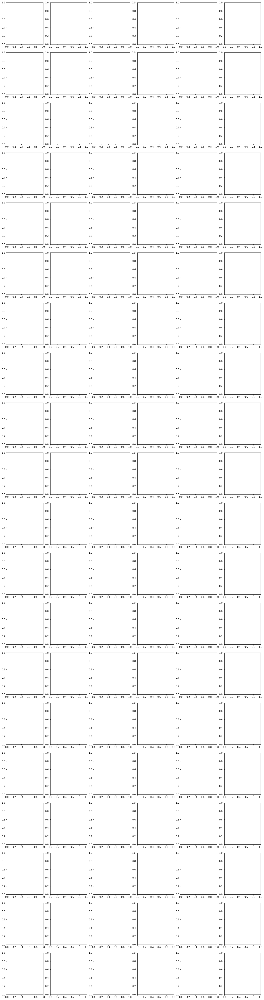

In [7]:
fig, axes = plt.subplots(20, 6, figsize=(20, 80))
ax = axes.ravel()

i = 0

for galaxy, item in processed_galaxies.items():
    orig = item
    print(orig)
    i += 1
    if i == 120:
        break
    
    

In [3]:
# data augmentation

import albumentations as A
import copy

transform = A.Compose([A.HorizontalFlip(p=0.7),
                       A.VerticalFlip(p=0.7),
                      ]
)

full_data = {}
residual_full_data = {}

i = 0


# sersic_fits[galaxy] = [original_img_data, image_model, theta, rhalfellip, rmaj, rhalf_circ, r20, r50, r80, 
                        # rmax_circ, rmax_ellip, rpetro_circ, rpetro_ellip, ellip, rmin, sersic_xc, 
                        # sersic_yc, cent_xc, cent_yc, best_cent, residual, processed_img, processed_residual]

for galaxy, model in processed_galaxies.items():
    img = model[-2]
    transformed_img = transform(image=img)['image']
    full_data[galaxy] = img
    name = galaxy + '_xyflipped'
    full_data[name] = transformed_img
    print(i, end='\r')
    
    res = model[-1]
    residual_full_data[galaxy + '_res'] = res
    transformed_res = transform(image=res)['image']
    residual_full_data[galaxy + '_xyflipped_res'] = transformed_res
    
    i += 1

In [4]:
with open('full_data.pickle', 'wb') as f:
    pickle.dump(full_data, f, pickle.HIGHEST_PROTOCOL)
    

In [5]:
with open('residual_full_data.pickle', 'wb') as f:
    pickle.dump(residual_full_data, f, pickle.HIGHEST_PROTOCOL)
    

In [2]:
with open('full_data.pickle', 'rb') as f:
    full_data = pickle.load(f)

In [2]:
with open('residual_full_data.pickle', 'rb') as f:
    residual_full_data = pickle.load(f)

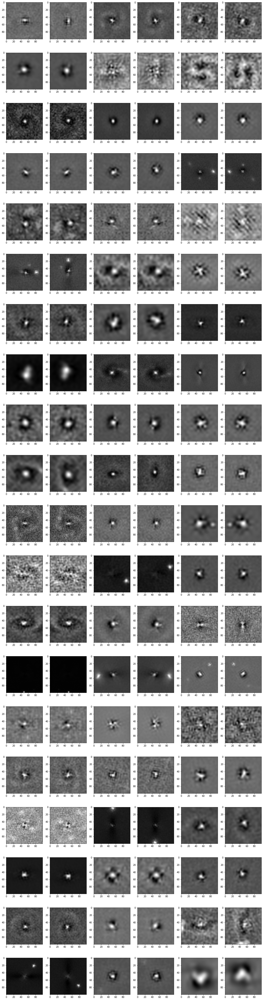

In [50]:
fig, axes = plt.subplots(20, 6, figsize=(20, 80))
ax = axes.ravel()

i = 0
for galaxy, image in residual_full_data.items():
    ax[i].imshow(image, cmap='gray')
    i+=1
    if i == 120:
        break

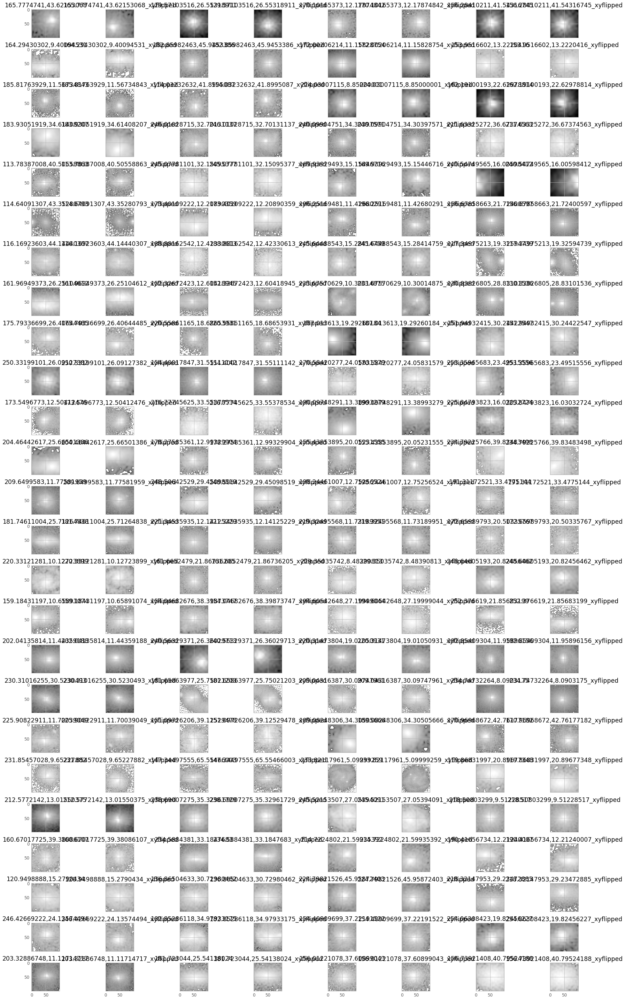

In [3]:
fig, axes = plt.subplots(25, 8, figsize=(25, 40), sharex=True, sharey=True)
ax = axes.ravel()

i = 0

for galaxy, original_img_data in full_data.items():
    # norm = colors.LogNorm(original_img_data.mean() + 0.5 * original_img_data.std(), original_img_data.max(), clip='True')
    norm = colors.LogNorm()
    ax[i].set_title(galaxy)
    ax[i].imshow(original_img_data, norm=norm, cmap='gray')
    
    print(i, end='\r')
    i += 1
    if i == 200:
        break

plt.tight_layout()
plt.show()

In [3]:
## code for flattening and conducting PCA on images

# clear ram of processed_galaxies usage
processed_galaxies = 0

# create data matrix

data_list = []
error_data_list = []

# sersic_fits[galaxy] = [original_img_data, image_model, theta, rhalfellip, rmaj, rhalf_circ, r20, r50, r80, 
                      # rmax_circ, rmax_ellip, rpetro_circ, rpetro_ellip, ellip, rmin, residual, 
                      # processed_image, processed_residual]

i = 0
        
for galaxy, item in full_data.items():
    try:
        img = item

#         preprocess and scale each image's pixel values
        transformer = preprocessing.MinMaxScaler(feature_range=(1, 2)).fit(img)
        img_scaled = transformer.transform(img)
        img_scaled = np.log(img_scaled)

        img_min = img.min()
    
        if img_min < 0:
            img_scaled = img - img_min
            print(img_min)
        else:
            img_scaled = img
                                                                                              
        data_row = img_scaled.flatten()
        data_list.append(data_row)
        
    except:
        error_data_list.append(galaxy)
        
    print(i, end='\r')
    i += 1
    
data_matrix = np.vstack(data_list)


-0.08572254
-0.08572254
-0.037855454
-0.037855454
-0.06336829
-0.06336829
-0.0066460026
-0.0066460026
-0.06875501
-0.06875501
-0.14703582
-0.14703582
-0.11193937
-0.11193937
-0.049624257
-0.049624257
-0.034501333
-0.034501333
-0.04402644
-0.04402644
-0.022863185
-0.022863185
-0.10664524
-0.10664524
-0.09115012
-0.09115012
-0.078724876
-0.078724876
-0.056242555
-0.056242555
-0.1047214
-0.1047214
-0.034329485
-0.034329485
-0.0728664
-0.0728664
-0.08409912
-0.08409912
-0.07321187
-0.07321187
-0.036985476
-0.036985476
-0.043929398
-0.043929398
-0.044559535
-0.044559535
-0.09445288
-0.09445288
-0.032634765
-0.032634765
-0.07619505
-0.07619505
-0.12123752
-0.12123752
-0.067086995
-0.067086995
-0.05791442
-0.05791442
-0.06864988
-0.06864988
-0.048158836
-0.048158836
-0.059250794
-0.059250794
-0.10196453
-0.10196453
-0.1239947
-0.1239947
-0.07659476
-0.07659476
-0.06915199
-0.06915199
-0.060432203
-0.060432203
-0.043717287
-0.043717287
-0.08524644
-0.08524644
-0.056684267
-0.056684267
-0.12362

-0.004887573
-0.035989936
-0.035989936
-0.103528835
-0.103528835
-0.11633969
-0.11633969
-0.060175635
-0.060175635
-0.030519765
-0.030519765
-0.02324332
-0.02324332
-0.10199819
-0.10199819
-0.08592202
-0.08592202
-0.07435558
-0.07435558
-0.10465788
-0.10465788
-0.12956005
-0.12956005
-0.07090186
-0.07090186
-0.01191957
-0.01191957
-0.033206016
-0.033206016
-0.080040224
-0.080040224
-0.080125794
-0.080125794
-0.022266999
-0.022266999
-0.030968856
-0.030968856
-0.084128655
-0.084128655
-0.054989357
-0.054989357
-0.0373602
-0.0373602
-0.19432266
-0.19432266
-0.025219312
-0.025219312
-0.12544365
-0.12544365
-0.0079562655
-0.0079562655
-0.038100306
-0.038100306
-0.10185473
-0.10185473
-0.040013544
-0.040013544
-0.09637491
-0.09637491
-0.030443083
-0.030443083
-0.08432893
-0.08432893
-0.06373848
-0.06373848
-0.1258013
-0.1258013
-0.13905558
-0.13905558
-0.06987462
-0.06987462
-0.10507594
-0.10507594
-0.07925572
-0.07925572
-0.08459094
-0.08459094
-0.10624526
-0.10624526
-0.07199914
-0.071999

-0.05669429
-0.05669429
-0.043742012
-0.043742012
-0.08229777
-0.08229777
-0.1419512
-0.1419512
-0.14073582
-0.14073582
-0.07017673
-0.07017673
-0.03516884
-0.03516884
-0.09006742
-0.09006742
-0.061753113
-0.061753113
-0.06624585
-0.06624585
-0.008390499
-0.008390499
-0.08442312
-0.08442312
-0.05663331
-0.05663331
-0.0935627
-0.0935627
-0.06933935
-0.06933935
-0.10990803
-0.10990803
-0.046906598
-0.046906598
-0.054334793
-0.054334793
-0.10661769
-0.10661769
-0.030061455
-0.030061455
-0.06544407
-0.06544407
-0.011721878
-0.011721878
-0.068204574
-0.068204574
-0.10310836
-0.10310836
-0.17666183
-0.17666183
-0.052148435
-0.052148435
-0.043389346
-0.043389346
-0.07974886
-0.07974886
-0.057337083
-0.057337083
-0.0625772
-0.0625772
-0.0015665552
-0.0015665552
-0.02924445
-0.02924445
-0.079014905
-0.079014905
-0.11786213
-0.11786213
-0.11354944
-0.11354944
-0.08008627
-0.08008627
-0.060875077
-0.060875077
-0.08696252
-0.08696252
-0.10715288
-0.10715288
-0.007289296
-0.007289296
-0.06922445
-0

-0.13379994
-0.14943492
-0.14943492
-0.10878307
-0.10878307
-0.054356333
-0.054356333
-0.061322905
-0.061322905
-0.052593436
-0.052593436
-0.094920695
-0.094920695
-0.042528246
-0.042528246
-0.026929447
-0.026929447
-0.07912455
-0.07912455
-0.061687
-0.061687
-0.10738735
-0.10738735
-0.09489935
-0.09489935
-0.02160995
-0.02160995
-0.063988954
-0.063988954
-0.14447902
-0.14447902
-0.08265363
-0.08265363
-0.027964039
-0.027964039
-0.0048702634
-0.0048702634
-0.08252029
-0.08252029
-0.04635196
-0.04635196
-0.025142072
-0.025142072
-0.057331547
-0.057331547
-0.104514785
-0.104514785
-0.05123095
-0.05123095
-0.015502186
-0.015502186
-0.07125416
-0.07125416
-0.068347484
-0.068347484
-0.07493654
-0.07493654
-0.039136305
-0.039136305
-0.12360516
-0.12360516
-0.045964252
-0.045964252
-0.13774912
-0.13774912
-0.08211944
-0.08211944
-0.007568825
-0.007568825
-0.11790914
-0.11790914
-0.18264027
-0.18264027
-0.08792999
-0.08792999
-0.047862202
-0.047862202
-0.06746008
-0.06746008
-0.03772773
-0.037

-0.08992821
-0.08992821
-0.08222489
-0.08222489
-0.07383094
-0.07383094
-0.03674066
-0.03674066
-0.06657602
-0.06657602
-0.067724764
-0.067724764
-0.0832975
-0.0832975
-0.19674775
-0.19674775
-0.04380823
-0.04380823
-0.041377738
-0.041377738
-0.11094449
-0.11094449
-0.035987735
-0.035987735
-0.021855218
-0.021855218
-0.105790004
-0.105790004
-0.09171273
-0.09171273
-0.07420074
-0.07420074
-0.053617407
-0.053617407
-0.10104631
-0.10104631
-0.024182351
-0.024182351
-0.023621762
-0.023621762
-0.06306353
-0.06306353
-0.053239573
-0.053239573
-0.059215154
-0.059215154
-0.019249415
-0.019249415
-0.10541103
-0.10541103
-0.15251504
-0.15251504
-0.057470836
-0.057470836
-0.059719097
-0.059719097
-0.10411267
-0.10411267
-0.04145937
-0.04145937
-0.10389918
-0.10389918
-0.07533541
-0.07533541
-0.03890067
-0.03890067
-0.09277671
-0.09277671
-0.0052479557
-0.0052479557
-0.061132036
-0.061132036
-0.058610436
-0.058610436
-0.11518097
-0.11518097
-0.08665288
-0.08665288
-0.06331818
-0.06331818
-0.07794

-0.12700932
-0.088013366
-0.088013366
-0.053544283
-0.053544283
-0.03851885
-0.03851885
-0.022299824
-0.022299824
-0.081716605
-0.081716605
-0.007975066
-0.007975066
-0.020069066
-0.020069066
-0.05790625
-0.05790625
-0.027046328
-0.027046328
-0.115256
-0.115256
-0.0758147
-0.0758147
-0.11823173
-0.11823173
-0.052289862
-0.052289862
-0.0020393338
-0.0020393338
-0.048315354
-0.048315354
-0.085496075
-0.085496075
-0.021992223
-0.021992223
-0.03142792
-0.03142792
-0.09142238
-0.09142238
-0.03726489
-0.03726489
-0.031697653
-0.031697653
-0.08869602
-0.08869602
-0.03466767
-0.03466767
-0.05420684
-0.05420684
-0.07352935
-0.07352935
-0.03899102
-0.03899102
-0.08681548
-0.08681548
-0.042811614
-0.042811614
-0.03233257
-0.03233257
-0.029667217
-0.029667217
-0.06874745
-0.06874745
-0.10163423
-0.10163423
-0.01793655
-0.01793655
-0.08076551
-0.08076551
-0.08887018
-0.08887018
-0.09833044
-0.09833044
-0.063075006
-0.063075006
-0.003738525
-0.003738525
-0.06930304
-0.06930304
-0.012921056
-0.012921

-0.10378665
-0.17361888
-0.17361888
-0.13953811
-0.13953811
-0.101624995
-0.101624995
-0.042658243
-0.042658243
-0.111771055
-0.111771055
-0.064867906
-0.064867906
-0.069602266
-0.069602266
-0.015714549
-0.015714549
-0.05080756
-0.05080756
-0.05396116
-0.05396116
-0.007363296
-0.007363296
-0.025430454
-0.025430454
-0.14429541
-0.14429541
-0.085519716
-0.085519716
-0.097989626
-0.097989626
-0.13819525
-0.13819525
-0.10539831
-0.10539831
-0.026575437
-0.026575437
-0.06236854
-0.06236854
-0.06364485
-0.06364485
-0.06390226
-0.06390226
-0.054754827
-0.054754827
-0.013960792
-0.013960792
-0.04427933
-0.04427933
-0.14482445
-0.14482445
-0.034368295
-0.034368295
-0.08243434
-0.08243434
-0.021961365
-0.021961365
-0.0855954
-0.0855954
-0.071815535
-0.071815535
-0.026143283
-0.026143283
-0.11303353
-0.11303353
-0.04205935
-0.04205935
-0.04777141
-0.04777141
-0.105137356
-0.105137356
-0.03691576
-0.03691576
-0.027763698
-0.027763698
-0.101573914
-0.101573914
-0.018679043
-0.018679043
-0.085898355

-0.11493968
-0.11493968
-0.013828493
-0.013828493
-0.07815478
-0.07815478
-0.085305735
-0.085305735
-0.06679459
-0.06679459
-0.123191245
-0.123191245
-0.0924689
-0.0924689
-0.025827287
-0.025827287
-0.06398715
-0.06398715
-0.031127876
-0.031127876
-0.06589346
-0.06589346
-0.12932156
-0.12932156
-0.056056138
-0.056056138
-0.097390994
-0.097390994
-0.09135388
-0.09135388
-0.08069196
-0.08069196
-0.011992457
-0.011992457
-0.05444434
-0.05444434
-0.011964285
-0.011964285
-0.07444078
-0.07444078
-0.13417031
-0.13417031
-0.11856433
-0.11856433
-0.011294978
-0.011294978
-0.052531283
-0.052531283
-0.072923735
-0.072923735
-0.04541676
-0.04541676
-0.106842436
-0.106842436
-0.10125463
-0.10125463
-0.07554092
-0.07554092
-0.0714716
-0.0714716
-0.18022633
-0.18022633
-0.071374685
-0.071374685
-0.13326058
-0.13326058
-0.00044348557
-0.00044348557
-0.037552767
-0.037552767
-0.1589968
-0.1589968
-0.065939486
-0.065939486
-0.06868515
-0.06868515
-0.014310956
-0.014310956
-0.006206443
-0.006206443
-0.0

-0.0615782
-0.04285539
-0.04285539
-0.04638832
-0.04638832
-0.0828762
-0.0828762
-0.031994995
-0.031994995
-0.10131754
-0.10131754
-0.07315988
-0.07315988
-0.06648036
-0.06648036
-0.116815954
-0.116815954
-0.10148287
-0.10148287
-0.12737088
-0.12737088
-0.046039443
-0.046039443
-0.15060976
-0.15060976
-0.112163454
-0.112163454
-0.07572439
-0.07572439
-0.08156518
-0.08156518
-0.12198769
-0.12198769
-0.033683136
-0.033683136
-0.07729071
-0.07729071
-0.04895977
-0.04895977
-0.089035705
-0.089035705
-0.054193635
-0.054193635
-0.053757634
-0.053757634
-0.09914451
-0.09914451
-0.046963066
-0.046963066
-0.07950408
-0.07950408
-0.089310266
-0.089310266
-0.11828549
-0.11828549
-0.043826025
-0.043826025
-0.044790804
-0.044790804
-0.11975785
-0.11975785
-0.006414746
-0.006414746
-0.08023065
-0.08023065
-0.024079239
-0.024079239
-0.25469202
-0.25469202
-0.09614823
-0.09614823
-0.031461187
-0.031461187
-0.091045305
-0.091045305
-0.06436476
-0.06436476
-0.0738355
-0.0738355
-0.07354789
-0.07354789
-

-0.08624098
-0.049452852
-0.049452852
-0.049927928
-0.049927928
-0.11910391
-0.11910391
-0.06546583
-0.06546583
-0.072979994
-0.072979994
-0.028193494
-0.028193494
-0.052075293
-0.052075293
-0.03955825
-0.03955825
-0.061502315
-0.061502315
-0.103979565
-0.103979565
-0.08375173
-0.08375173
-0.024286015
-0.024286015
-0.04575948
-0.04575948
-0.074644886
-0.074644886
-0.10122359
-0.10122359
-0.18939544
-0.18939544
-0.050764047
-0.050764047
-0.053448435
-0.053448435
-0.030756915
-0.030756915
-0.062250823
-0.062250823
-0.021139676
-0.021139676
-0.07725876
-0.07725876
-0.15759501
-0.15759501
-0.1001987
-0.1001987
-0.03907403
-0.03907403
-0.065090984
-0.065090984
-0.0316022
-0.0316022
-0.03336429
-0.03336429
-0.0055825175
-0.0055825175
-0.022429561
-0.022429561
-0.021189881
-0.021189881
-0.06496903
-0.06496903
-0.04424935
-0.04424935
-0.104564995
-0.104564995
-0.0827315
-0.0827315
-0.10611129
-0.10611129
-0.09982227
-0.09982227
-0.07361183
-0.07361183
-0.043442655
-0.043442655
-0.10099115
-0.1

-0.029930273
-0.1192486
-0.1192486
-0.049262267
-0.049262267
-0.08395215
-0.08395215
-0.07998437
-0.07998437
-0.08308801
-0.08308801
-0.11488613
-0.11488613
-0.06417986
-0.06417986
-0.033017013
-0.033017013
-0.08483918
-0.08483918
-0.04877041
-0.04877041
-0.1100566
-0.1100566
-0.08082537
-0.08082537
-0.07237211
-0.07237211
-0.1390545
-0.1390545
-0.006685219
-0.006685219
-0.09167089
-0.09167089
-0.057907116
-0.057907116
-0.0067122057
-0.0067122057
-0.09626295
-0.09626295
-0.05563218
-0.05563218
-0.008711739
-0.008711739
-0.056201514
-0.056201514
-0.08119976
-0.08119976
-0.07756234
-0.07756234
-0.061676886
-0.061676886
-0.03877164
-0.03877164
-0.07123182
-0.07123182
-0.018300986
-0.018300986
-0.07045579
-0.07045579
-0.10292129
-0.10292129
-0.06973369
-0.06973369
-0.0108151175
-0.0108151175
-0.08505435
-0.08505435
-0.11706234
-0.11706234
-0.07231019
-0.07231019
-0.05093814
-0.05093814
-0.0903158
-0.0903158
-0.015378709
-0.015378709
-0.13120565
-0.13120565
-0.027732726
-0.027732726
-0.0371

-0.06958632
-0.06958632
-0.06537617
-0.06537617
-0.037056357
-0.037056357
-0.05272266
-0.05272266
-0.055142567
-0.055142567
-0.031730622
-0.031730622
-0.10436385
-0.10436385
-0.101828374
-0.101828374
-0.11302926
-0.11302926
-0.027370704
-0.027370704
-0.0113364905
-0.0113364905
-0.08182488
-0.08182488
-0.02975616
-0.02975616
-0.06207856
-0.06207856
-0.12062294
-0.12062294
-0.047418505
-0.047418505
-0.032578282
-0.032578282
-0.025634611
-0.025634611
-0.031114606
-0.031114606
-0.053876292
-0.053876292
-0.016773716
-0.016773716
-0.09973661
-0.09973661
-0.019848606
-0.019848606
-0.04569434
-0.04569434
-0.07777964
-0.07777964
-0.046694756
-0.046694756
-0.045167353
-0.045167353
-0.06617988
-0.06617988
-0.052494112
-0.052494112
-0.09556901
-0.09556901
-0.035878845
-0.035878845
-0.14767775
-0.14767775
-0.13698682
-0.13698682
-0.07130402
-0.07130402
-0.06675107
-0.06675107
-0.09718577
-0.09718577
-0.06524415
-0.06524415
-0.12971811
-0.12971811
-0.074902825
-0.074902825
-0.085931726
-0.085931726


-0.034878682
-0.035108246
-0.035108246
-0.062460028
-0.062460028
-0.045397952
-0.045397952
-0.036180127
-0.036180127
-0.06370671
-0.06370671
-0.059520837
-0.059520837
-0.0970241
-0.0970241
-0.048412062
-0.048412062
-0.0685891
-0.0685891
-0.083157584
-0.083157584
-0.060850963
-0.060850963
-0.08631597
-0.08631597
-0.085384555
-0.085384555
-0.116924316
-0.116924316
-0.062103245
-0.062103245
-0.025197081
-0.025197081
-0.051658683
-0.051658683
-0.028675286
-0.028675286
-0.025601536
-0.025601536
-0.10250837
-0.10250837
-0.14364643
-0.14364643
-0.10060983
-0.10060983
-0.09206794
-0.09206794
-0.094545215
-0.094545215
-0.07076751
-0.07076751
-0.0044388003
-0.0044388003
-0.12555611
-0.12555611
-0.03715619
-0.03715619
-0.0296507
-0.0296507
-0.024829576
-0.024829576
-0.1409695
-0.1409695
-0.10222594
-0.10222594
-0.068131745
-0.068131745
-0.06673689
-0.06673689
-0.02963575
-0.02963575
-0.12563424
-0.12563424
-0.09205018
-0.09205018
-0.13973026
-0.13973026
-0.060592152
-0.060592152
-0.112809196
-0.1

-0.05424864
-0.05424864
-0.11536182
-0.11536182
-0.055626806
-0.055626806
-0.08028385
-0.08028385
-0.0998126
-0.0998126
-0.023353914
-0.023353914
-0.09218777
-0.09218777
-0.1004151
-0.1004151
-0.04002881
-0.04002881
-0.05801955
-0.05801955
-0.07746195
-0.07746195
-0.07854881
-0.07854881
-0.02838699
-0.02838699
-0.061452407
-0.061452407
-0.08508798
-0.08508798
-0.014161484
-0.014161484
-0.09564038
-0.09564038
-0.031189602
-0.031189602
-0.09720297
-0.09720297
-0.077051796
-0.077051796
-0.052044157
-0.052044157
-0.049166113
-0.049166113
-0.04730341
-0.04730341
-0.1131292
-0.1131292
-0.10243323
-0.10243323
-0.10802696
-0.10802696
-0.1288239
-0.1288239
-0.048216525
-0.048216525
-0.06289416
-0.06289416
-0.13751224
-0.13751224
-0.038811766
-0.038811766
-0.007526736
-0.007526736
-0.019498607
-0.019498607
-0.03699138
-0.03699138
-0.10156271
-0.10156271
-0.10503876
-0.10503876
-0.06552115
-0.06552115
-0.017878674
-0.017878674
-0.018173076
-0.018173076
-0.10031738
-0.10031738
-0.04905933
-0.04905

-0.084051035
-0.084051035
-0.0065602413
-0.0065602413
-0.005430674
-0.005430674
-0.028786846
-0.028786846
-0.06675991
-0.06675991
-0.069376566
-0.069376566
-0.07250837
-0.07250837
-0.0994207
-0.0994207
-0.039685696
-0.039685696
-0.08248921
-0.08248921
-0.14168908
-0.14168908
-0.022828167
-0.022828167
-0.07314203
-0.07314203
-0.076140285
-0.076140285
-0.07129061
-0.07129061
-0.11894879
-0.11894879
-0.13848838
-0.13848838
-0.08265584
-0.08265584
-0.018010931
-0.018010931
-0.061457254
-0.061457254
-0.041644875
-0.041644875
-0.037139844
-0.037139844
-0.047100134
-0.047100134
-0.026182452
-0.026182452
-0.0538795
-0.0538795
-0.046687678
-0.046687678
-0.040875874
-0.040875874
-0.03336826
-0.03336826
-0.033387735
-0.033387735
-0.011431952
-0.011431952
-0.058829576
-0.058829576
-0.018353615
-0.018353615
-0.050415996
-0.050415996
-0.054334674
-0.054334674
-0.0488443
-0.0488443
-0.10946629
-0.10946629
-0.8170861
-0.8170861
-0.027290937
-0.027290937
-0.09260202
-0.09260202
-0.042963695
-0.04296369

-0.086784534
-0.025742851
-0.025742851
-0.07664651
-0.07664651
-0.074779585
-0.074779585
-0.0715387
-0.0715387
-0.06874823
-0.06874823
-0.1462855
-0.1462855
-0.03370684
-0.03370684
-0.14747195
-0.14747195
-0.05101901
-0.05101901
-0.0029554165
-0.0029554165
-0.08223454
-0.08223454
-0.10700028
-0.10700028
-0.005266317
-0.005266317
-0.1371286
-0.1371286
-0.043170717
-0.043170717
-0.12610681
-0.12610681
-0.02408661
-0.02408661
-0.103930905
-0.103930905
-0.031786885
-0.031786885
-0.12278207
-0.12278207
-0.08238161
-0.08238161
-0.087587394
-0.087587394
-0.096025795
-0.096025795
-0.083399616
-0.083399616
-0.026454467
-0.026454467
-0.050718717
-0.050718717
-0.07756741
-0.07756741
-0.07618585
-0.07618585
-0.056337886
-0.056337886
-0.10103507
-0.10103507
-0.09124529
-0.09124529
-0.10393687
-0.10393687
-0.022696054
-0.022696054
-0.06833042
-0.06833042
-0.04916711
-0.04916711
-0.059146952
-0.059146952
-0.121928275
-0.121928275
-0.10171174
-0.10171174
-0.09765409
-0.09765409
-0.19595851
-0.19595851

-0.11787693
-0.019550763
-0.019550763
-0.111324795
-0.111324795
-0.018157007
-0.018157007
-0.026519405
-0.026519405
-0.079271264
-0.079271264
-0.06259534
-0.06259534
-0.07964995
-0.07964995
-0.11427388
-0.11427388
-0.005079504
-0.005079504
-0.03698501
-0.03698501
-0.013051788
-0.013051788
-0.061727136
-0.061727136
-0.17210387
-0.17210387
-0.05063198
-0.05063198
-0.052803043
-0.052803043
-0.10381118
-0.10381118
-0.07331006
-0.07331006
-0.094331354
-0.094331354
-0.03127719
-0.03127719
-0.094875395
-0.094875395
-0.09179474
-0.09179474
-0.15372284
-0.15372284
-0.09043358
-0.09043358
-0.1356899
-0.1356899
-0.10491408
-0.10491408
-0.10419492
-0.10419492
-0.08187332
-0.08187332
-0.09937455
-0.09937455
-0.055857256
-0.055857256
-0.013836077
-0.013836077
-0.11955174
-0.11955174
-0.053533215
-0.053533215
-0.0120628895
-0.0120628895
-0.11290321
-0.11290321
-0.045510653
-0.045510653
-0.009361405
-0.009361405
-0.02277325
-0.02277325
-0.021887314
-0.021887314
-0.0013357401
-0.0013357401
-0.02995338


-0.119633
-0.119633
-0.12009264
-0.12009264
-0.09919386
-0.09919386
-0.059849758
-0.059849758
-0.061329648
-0.061329648
-0.115383774
-0.115383774
-0.072275385
-0.072275385
-0.110068366
-0.110068366
-0.057943437
-0.057943437
-0.09080615
-0.09080615
-0.016512267
-0.016512267
-0.116516314
-0.116516314
-0.096758775
-0.096758775
-0.12864697
-0.12864697
-0.02432801
-0.02432801
-0.07534757
-0.07534757
-0.10055152
-0.10055152
-0.0019222036
-0.0019222036
-0.038171835
-0.038171835
-0.021362318
-0.021362318
-0.11851843
-0.11851843
-0.016419228
-0.016419228
-0.05129702
-0.05129702
-0.022171075
-0.022171075
-0.08341392
-0.08341392
-0.051368743
-0.051368743
-0.0016945753
-0.0016945753
-0.14591359
-0.14591359
-0.0042256485
-0.0042256485
-0.10375041
-0.10375041
-0.12136406
-0.12136406
-0.04326577
-0.04326577
-0.045878068
-0.045878068
-0.09543773
-0.09543773
-0.077728175
-0.077728175
-0.08235218
-0.08235218
-0.06498024
-0.06498024
-0.0861027
-0.0861027
-0.06896127
-0.06896127
-0.12053056
-0.12053056
-0

-0.114181094
-0.114181094
-0.04145763
-0.04145763
-0.15150838
-0.15150838
-0.0974556
-0.0974556
-0.05825272
-0.05825272
-0.07776065
-0.07776065
-0.09135719
-0.09135719
-0.0037709377
-0.0037709377
-0.13132752
-0.13132752
-0.109463654
-0.109463654
-0.045907356
-0.045907356
-0.097164735
-0.097164735
-0.06893398
-0.06893398
-0.0697651
-0.0697651
-0.048402455
-0.048402455
-0.05149569
-0.05149569
-0.09525335
-0.09525335
-0.08892172
-0.08892172
-0.087789536
-0.087789536
-0.019341178
-0.019341178
-0.061094884
-0.061094884
-0.01944949
-0.01944949
-0.07272178
-0.07272178
-0.12395304
-0.12395304
-0.05364767
-0.05364767
-0.1245772
-0.1245772
-0.07974142
-0.07974142
-0.043247826
-0.043247826
-0.042214617
-0.042214617
-0.066034004
-0.066034004
-0.08956746
-0.08956746
-0.08568294
-0.08568294
-0.04762402
-0.04762402
-0.22942726
-0.22942726
-0.09817561
-0.09817561
-0.012401905
-0.012401905
-0.08134348
-0.08134348
-0.008125509
-0.008125509
-0.038477395
-0.038477395
-0.063330516
-0.063330516
-0.03442138


-0.05113636
-0.05318527
-0.05318527
-0.13737352
-0.13737352
-0.115031995
-0.115031995
-0.008719119
-0.008719119
-0.08734152
-0.08734152
-0.07714584
-0.07714584
-0.08046942
-0.08046942
-0.04007562
-0.04007562
-0.069498405
-0.069498405
-0.055425115
-0.055425115
-0.047555253
-0.047555253
-0.07787072
-0.07787072
-0.097471096
-0.097471096
-0.13445823
-0.13445823
-0.120542824
-0.120542824
-0.04459482
-0.04459482
-0.09346273
-0.09346273
-0.119715296
-0.119715296
-0.04443093
-0.04443093
-0.06424605
-0.06424605
-0.09536455
-0.09536455
-0.02306719
-0.02306719
-0.09691029
-0.09691029
-0.09900932
-0.09900932
-0.037770346
-0.037770346
-0.09989414
-0.09989414
-0.044545133
-0.044545133
-0.068829976
-0.068829976
-0.0696662
-0.0696662
-0.13019355
-0.13019355
-0.052328948
-0.052328948
-0.104915194
-0.104915194
-0.14458245
-0.14458245
-0.026240798
-0.026240798
-0.0090511395
-0.0090511395
-0.011817061
-0.011817061
-0.017615484
-0.017615484
-0.78797615
-0.78797615
-0.038365725
-0.038365725
-0.09381956
-0.0

-0.02918426
-0.02918426
-0.07594266
-0.07594266
-0.039296202
-0.039296202
-0.101905525
-0.101905525
-0.11420405
-0.11420405
-0.050672878
-0.050672878
-0.07653949
-0.07653949
-0.045613114
-0.045613114
-0.10339216
-0.10339216
-0.07207788
-0.07207788
-0.12502497
-0.12502497
-0.14192124
-0.14192124
-0.07677785
-0.07677785
-0.05573093
-0.05573093
-0.027955247
-0.027955247
-0.098290496
-0.098290496
-0.05676522
-0.05676522
-0.054781225
-0.054781225
-0.101316765
-0.101316765
-0.084972374
-0.084972374
-0.12931561
-0.12931561
-0.0008556348
-0.0008556348
-0.07851919
-0.07851919
-0.10981367
-0.10981367
-0.08516067
-0.08516067
-0.047198046
-0.047198046
-0.13304947
-0.13304947
-0.07699961
-0.07699961
-0.04044021
-0.04044021
-0.10039781
-0.10039781
-0.06351723
-0.06351723
-0.018243283
-0.018243283
-0.072441116
-0.072441116
-0.037396114
-0.037396114
-0.107848056
-0.107848056
-0.042702664
-0.042702664
-0.07613794
-0.07613794
-0.047210995
-0.047210995
-0.056315243
-0.056315243
-0.054308403
-0.054308403


-0.12017173
-0.040455706
-0.040455706
-0.035781577
-0.035781577
-0.03758899
-0.03758899
-0.06966751
-0.06966751
-0.043277457
-0.043277457
-0.06222521
-0.06222521
-0.13070895
-0.13070895
-0.052333277
-0.052333277
-0.17785884
-0.17785884
-0.04871983
-0.04871983
-0.10880019
-0.10880019
-0.023744084
-0.023744084
-0.020190718
-0.020190718
-0.06863361
-0.06863361
-0.11727558
-0.11727558
-0.029255593
-0.029255593
-0.08208053
-0.08208053
-0.089355685
-0.089355685
-0.01711276
-0.01711276
-0.09046706
-0.09046706
-0.062361002
-0.062361002
-0.09318632
-0.09318632
-0.07159313
-0.07159313
-0.10058877
-0.10058877
-0.07696081
-0.07696081
-0.059234217
-0.059234217
-0.07329782
-0.07329782
-0.00020726923
-0.00020726923
-0.020091247
-0.020091247
-0.12935534
-0.12935534
-0.006842224
-0.006842224
-0.005853622
-0.005853622
-0.054208398
-0.054208398
-0.06055591
-0.06055591
-0.03667653
-0.03667653
-0.056792025
-0.056792025
-0.085116364
-0.085116364
-0.0676126
-0.0676126
-0.12235265
-0.12235265
-0.052228995
-0.

-0.04879076
-0.04879076
-0.048351113
-0.048351113
-0.06515735
-0.06515735
-0.012641828
-0.012641828
-0.05403214
-0.05403214
-0.086498864
-0.086498864
-0.00819448
-0.00819448
-0.122163296
-0.122163296
-0.07579889
-0.07579889
-0.06680871
-0.06680871
-0.085302085
-0.085302085
-0.13770156
-0.13770156
-0.034589346
-0.034589346
-0.109562315
-0.109562315
-0.019975286
-0.019975286
-0.021854281
-0.021854281
-0.05228842
-0.05228842
-0.11050698
-0.11050698
-0.034297533
-0.034297533
-0.019727016
-0.019727016
-0.04068475
-0.04068475
-0.03464582
-0.03464582
-0.026504619
-0.026504619
-0.066681795
-0.066681795
-0.047224265
-0.047224265
-0.035209756
-0.035209756
-0.070676066
-0.070676066
-0.10868766
-0.10868766
-0.098745525
-0.098745525
-0.0647561
-0.0647561
-0.019196007
-0.019196007
-0.011035678
-0.011035678
-0.054663625
-0.054663625
-0.04733033
-0.04733033
-0.03576855
-0.03576855
-0.06593308
-0.06593308
-0.005778366
-0.005778366
-0.13146812
-0.13146812
-0.069678046
-0.069678046
-0.042484034
-0.042484

-0.040998384
-0.08262786
-0.08262786
-0.30027348
-0.30027348
-0.05673031
-0.05673031
-0.018433124
-0.018433124
-0.07092975
-0.07092975
-0.032337017
-0.032337017
-0.048575982
-0.048575982
-0.045251686
-0.045251686
-0.040919513
-0.040919513
-0.100161895
-0.100161895
-0.0697661
-0.0697661
-0.08310622
-0.08310622
-0.017348032
-0.017348032
-0.059644066
-0.059644066
-0.07248576
-0.07248576
-0.08597625
-0.08597625
-0.049963087
-0.049963087
-0.045239367
-0.045239367
-0.10575452
-0.10575452
-0.08894538
-0.08894538
-0.08531296
-0.08531296
-0.05224068
-0.05224068
-0.043683577
-0.043683577
-0.0672228
-0.0672228
-0.10069936
-0.10069936
-0.04709217
-0.04709217
-0.02934354
-0.02934354
-0.06436148
-0.06436148
-0.07484537
-0.07484537
-0.12316458
-0.12316458
-0.09467623
-0.09467623
-0.053094156
-0.053094156
-0.069174774
-0.069174774
-0.101077616
-0.101077616
-0.037441645
-0.037441645
-0.09316161
-0.09316161
-0.036876637
-0.036876637
-0.068714164
-0.068714164
-0.13553151
-0.13553151
-0.11019058
-0.110190

-0.05644325
-0.05644325
-0.0014248621
-0.0014248621
-0.015838569
-0.015838569
-0.040279195
-0.040279195
-0.057087798
-0.057087798
-0.068295695
-0.068295695
-0.06127404
-0.06127404
-0.12913214
-0.12913214
-0.04146376
-0.04146376
-0.09177878
-0.09177878
-0.083182506
-0.083182506
-0.07000811
-0.07000811
-0.1367087
-0.1367087
-0.081183344
-0.081183344
-0.055066478
-0.055066478
-0.06667661
-0.06667661
-0.08418368
-0.08418368
-0.055823673
-0.055823673
-0.0961816
-0.0961816
-0.09347767
-0.09347767
-0.028004557
-0.028004557
-0.087040484
-0.087040484
-0.09388797
-0.09388797
-0.11981194
-0.11981194
-0.025496751
-0.025496751
-0.06932814
-0.06932814
-0.0947181
-0.0947181
-0.073863104
-0.073863104
-0.07658352
-0.07658352
-0.037567
-0.037567
-0.04734389
-0.04734389
-0.08240797
-0.08240797
-0.08065297
-0.08065297
-0.024128579
-0.024128579
-0.004095255
-0.004095255
-0.12088939
-0.12088939
-0.07387695
-0.07387695
-0.042534355
-0.042534355
-0.09216594
-0.09216594
-0.08647575
-0.08647575
-0.07180816
-0.0

-0.078475386
-0.078475386
-0.022541719
-0.022541719
-0.14075658
-0.14075658
-0.057472486
-0.057472486
-0.1449478
-0.1449478
-0.09489013
-0.09489013
-0.035443854
-0.035443854
-0.0813856
-0.0813856
-0.018866513
-0.018866513
-0.07744638
-0.07744638
-0.054648586
-0.054648586
-0.020745782
-0.020745782
-0.06385489
-0.06385489
-0.11718112
-0.11718112
-0.04213053
-0.04213053
-0.043630727
-0.043630727
-0.06146934
-0.06146934
-0.122094
-0.122094
-0.09924999
-0.09924999
-0.11145283
-0.11145283
-0.023414947
-0.023414947
-0.026412552
-0.026412552
-0.008053633
-0.008053633
-0.07972127
-0.07972127
-0.09225913
-0.09225913
-0.08090192
-0.08090192
-0.0973666
-0.0973666
-0.061056558
-0.061056558
-0.1077346
-0.1077346
-0.039803673
-0.039803673
-0.04692764
-0.04692764
-0.12102015
-0.12102015
-0.048092365
-0.048092365
-0.11136247
-0.11136247
-0.1293204
-0.1293204
-0.083664805
-0.083664805
-0.07381706
-0.07381706
-0.064263955
-0.064263955
-0.0064259614
-0.0064259614
-0.10194376
-0.10194376
-0.031336285
-0.03

-0.07373417
-0.06760139
-0.06760139
-0.06132894
-0.06132894
-0.14587605
-0.14587605
-0.0885787
-0.0885787
-0.0879034
-0.0879034
-0.028076364
-0.028076364
-0.11466231
-0.11466231
-0.06551218
-0.06551218
-0.08583173
-0.08583173
-0.05574919
-0.05574919
-0.09462462
-0.09462462
-0.1320416
-0.1320416
-0.06891422
-0.06891422
-0.14340813
-0.14340813
-0.0053705187
-0.0053705187
-0.042630464
-0.042630464
-0.1391276
-0.1391276
-0.018500367
-0.018500367
-0.020445792
-0.020445792
-0.11428816
-0.11428816
-0.021462897
-0.021462897
-0.0043320796
-0.0043320796
-0.076871686
-0.076871686
-0.113001265
-0.113001265
-0.082110696
-0.082110696
-0.052012436
-0.052012436
-0.006550886
-0.006550886
-0.047265474
-0.047265474
-0.07045746
-0.07045746
-0.09283159
-0.09283159
-0.05904611
-0.05904611
-0.09121139
-0.09121139
-0.11898032
-0.11898032
-0.056176707
-0.056176707
-0.026206391
-0.026206391
-0.09663219
-0.09663219
-0.037855364
-0.037855364
-0.044442154
-0.044442154
-0.15640065
-0.15640065
-0.0770236
-0.0770236


-0.06490734
-0.06490734
-0.05424801
-0.05424801
-0.10252382
-0.10252382
-0.07740514
-0.07740514
-0.037195876
-0.037195876
-0.06332235
-0.06332235
-0.08427252
-0.08427252
-0.06664
-0.06664
-0.06519489
-0.06519489
-0.043835238
-0.043835238
-0.08278793
-0.08278793
-0.009704861
-0.009704861
-0.058710422
-0.058710422
-0.068005666
-0.068005666
-0.020475686
-0.020475686
-0.043789025
-0.043789025
-0.041083902
-0.041083902
-0.061967336
-0.061967336
-0.029178113
-0.029178113
-0.028846484
-0.028846484
-0.020162955
-0.020162955
-0.06546015
-0.06546015
-0.10612414
-0.10612414
-0.14714137
-0.14714137
-0.11582716
-0.11582716
-0.056933828
-0.056933828
-0.029145105
-0.029145105
-0.02138595
-0.02138595
-0.019467002
-0.019467002
-0.11145927
-0.11145927
-0.017301422
-0.017301422
-0.003735744
-0.003735744
-0.074421264
-0.074421264
-0.08097405
-0.08097405
-0.063727275
-0.063727275
-0.033946972
-0.033946972
-0.011585549
-0.011585549
-0.015177478
-0.015177478
-0.119191766
-0.119191766
-0.11365254
-0.11365254


-0.044582736
-0.044582736
-0.047420017
-0.047420017
-0.084427156
-0.084427156
-0.06000494
-0.06000494
-0.06782465
-0.06782465
-0.12279659
-0.12279659
-0.05283058
-0.05283058
-0.07808353
-0.07808353
-0.08514553
-0.08514553
-0.004532386
-0.004532386
-0.1015635
-0.1015635
-0.07829311
-0.07829311
-0.030875746
-0.030875746
-0.045155767
-0.045155767
-0.109758236
-0.109758236
-0.1042048
-0.1042048
-0.24678856
-0.24678856
-0.058029182
-0.058029182
-0.050422426
-0.050422426
-0.066657335
-0.066657335
-0.0560782
-0.0560782
-0.019182311
-0.019182311
-0.09416578
-0.09416578
-0.0823729
-0.0823729
-0.082072124
-0.082072124
-0.1385972
-0.1385972
-0.09031024
-0.09031024
-0.13726479
-0.13726479
-0.030354105
-0.030354105
-0.09965316
-0.09965316
-0.025774462
-0.025774462
-0.054929648
-0.054929648
-0.08329903
-0.08329903
-0.057321012
-0.057321012
-0.094198085
-0.094198085
-0.12728572
-0.12728572
-0.116359696
-0.116359696
-0.072624005
-0.072624005
-0.050117742
-0.050117742
-0.06739231
-0.06739231
-0.0373749

-0.06648503
-0.06648503
-0.058134522
-0.058134522
-0.06918595
-0.06918595
-0.0658826
-0.0658826
-0.059621792
-0.059621792
-0.064044796
-0.064044796
-0.06721597
-0.06721597
-0.030651433
-0.030651433
-0.07037893
-0.07037893
-0.06362786
-0.06362786
-0.037356444
-0.037356444
-0.05908028
-0.05908028
-0.03384205
-0.03384205
-0.025428629
-0.025428629
-0.098537505
-0.098537505
-0.054148354
-0.054148354
-0.07906051
-0.07906051
-0.013206725
-0.013206725
-0.13805547
-0.13805547
-0.09699931
-0.09699931
-0.14091323
-0.14091323
-0.02255913
-0.02255913
-0.121500134
-0.121500134
-0.03914538
-0.03914538
-0.07730333
-0.07730333
-0.058618683
-0.058618683
-0.0014887791
-0.0014887791
-0.038231023
-0.038231023
-0.05519369
-0.05519369
-0.052878898
-0.052878898
-0.05169124
-0.05169124
-0.089430615
-0.089430615
-0.08707787
-0.08707787
-0.12898926
-0.12898926
-0.05936147
-0.05936147
-0.004302685
-0.004302685
-0.09916023
-0.09916023
-0.036783505
-0.036783505
-0.07558481
-0.07558481
-0.01637548
-0.01637548
-0.087

-0.05810425
-0.05810425
-0.11307722
-0.11307722
-0.04960753
-0.04960753
-0.08213333
-0.08213333
-0.10106829
-0.10106829
-0.14894263
-0.14894263
-0.05895191
-0.05895191
-0.08134705
-0.08134705
-0.079565786
-0.079565786
-0.088037066
-0.088037066
-0.040709067
-0.040709067
-0.014292055
-0.014292055
-0.06439808
-0.06439808
-0.07698097
-0.07698097
-0.028116388
-0.028116388
-0.15585811
-0.15585811
-0.048660435
-0.048660435
-0.10513805
-0.10513805
-0.05847193
-0.05847193
-0.045112055
-0.045112055
-0.03217796
-0.03217796
-0.0733932
-0.0733932
-0.04846623
-0.04846623
-0.08811474
-0.08811474
-0.06748056
-0.06748056
-0.011746438
-0.011746438
-0.047334604
-0.047334604
-0.058152717
-0.058152717
-0.10360656
-0.10360656
-0.02518305
-0.02518305
-0.11202037
-0.11202037
-0.11836595
-0.11836595
-0.06856287
-0.06856287
-0.01749707
-0.01749707
-0.11498037
-0.11498037
-0.07102222
-0.07102222
-0.07005488
-0.07005488
-0.051929574
-0.051929574
-0.09452615
-0.09452615
-0.02616975
-0.02616975
-0.0075380327
-0.007

-0.0879053
-0.0879053
-0.054718673
-0.054718673
-0.049611248
-0.049611248
-0.10607126
-0.10607126
-0.08412652
-0.08412652
-0.022741795
-0.022741795
-0.021156669
-0.021156669
-0.029172847
-0.029172847
-0.14799085
-0.14799085
-0.10449024
-0.10449024
-0.118516095
-0.118516095
-0.06549545
-0.06549545
-0.097650155
-0.097650155
-0.039401267
-0.039401267
-0.06246299
-0.06246299
-0.01967195
-0.01967195
-0.07346604
-0.07346604
-0.08804274
-0.08804274
-0.063044734
-0.063044734
-0.09976175
-0.09976175
-0.12131723
-0.12131723
-0.08830542
-0.08830542
-0.16436665
-0.16436665
-0.025546174
-0.025546174
-0.065619014
-0.065619014
-0.0061936188
-0.0061936188
-0.024962943
-0.024962943
-0.08222197
-0.08222197
-0.0058315345
-0.0058315345
-0.008440499
-0.008440499
-0.05856237
-0.05856237
-0.05749714
-0.05749714
-0.014632576
-0.014632576
-0.096080974
-0.096080974
-0.09562437
-0.09562437
-0.08569062
-0.08569062
-0.06850144
-0.06850144
-0.05928067
-0.05928067
-0.04063034
-0.04063034
-0.8240885
-0.8240885
-0.026

-0.01828829
-0.034962047
-0.034962047
-0.1194648
-0.1194648
-0.1512227
-0.1512227
-0.041230958
-0.041230958
-0.02758154
-0.02758154
-0.07108773
-0.07108773
-0.065802775
-0.065802775
-0.08747664
-0.08747664
-0.069949895
-0.069949895
-0.020843726
-0.020843726
-0.051123366
-0.051123366
-0.07048551
-0.07048551
-0.09907297
-0.09907297
-0.055521622
-0.055521622
-0.028367896
-0.028367896
-0.053502068
-0.053502068
-0.0019232796
-0.0019232796
-0.041042976
-0.041042976
-0.13038471
-0.13038471
-0.05131582
-0.05131582
-0.09137811
-0.09137811
-0.13308525
-0.13308525
-0.035760768
-0.035760768
-0.016822468
-0.016822468
-0.0019545213
-0.0019545213
-0.052618884
-0.052618884
-0.024338856
-0.024338856
-0.12529996
-0.12529996
-0.1118822
-0.1118822
-0.13384221
-0.13384221
-0.08583993
-0.08583993
-0.044298932
-0.044298932
-0.013349091
-0.013349091
-0.16437197
-0.16437197
-0.018508997
-0.018508997
-0.032761987
-0.032761987
-0.14143914
-0.14143914
-0.043398976
-0.043398976
-0.040161535
-0.040161535
-0.1609151

-0.013474619
-0.013474619
-0.03618465
-0.03618465
-0.009404881
-0.009404881
-0.107586905
-0.107586905
-0.10632234
-0.10632234
-0.009432852
-0.009432852
-0.06958559
-0.06958559
-0.06869858
-0.06869858
-0.097385995
-0.097385995
-0.100746766
-0.100746766
-0.08520176
-0.08520176
-0.007493376
-0.007493376
-0.0048908084
-0.0048908084
-0.051545005
-0.051545005
-0.068209246
-0.068209246
-0.091340855
-0.091340855
-0.060558658
-0.060558658
-0.027159376
-0.027159376
-0.12920412
-0.12920412
-0.0996465
-0.0996465
-0.023285735
-0.023285735
-0.025803505
-0.025803505
-0.058847398
-0.058847398
-0.022722023
-0.022722023
-0.04443164
-0.04443164
-0.11192955
-0.11192955
-0.013348508
-0.013348508
-0.04142685
-0.04142685
-0.0032111912
-0.0032111912
-0.011071186
-0.011071186
-0.037129544
-0.037129544
-0.012417043
-0.012417043
-0.0673072
-0.0673072
-0.10773351
-0.10773351
-0.074103795
-0.074103795
-0.09956992
-0.09956992
-0.09496435
-0.09496435
-0.14792119
-0.14792119
-0.027870147
-0.027870147
-0.010379347
-0.

-0.06029296
-0.06567286
-0.06567286
-0.047835827
-0.047835827
-0.05851507
-0.05851507
-0.08839817
-0.08839817
-0.035271868
-0.035271868
-0.046074685
-0.046074685
-0.05001265
-0.05001265
-0.053410567
-0.053410567
-0.05101944
-0.05101944
-0.027884131
-0.027884131
-0.10638101
-0.10638101
-0.07398069
-0.07398069
-0.08138332
-0.08138332
-0.045923237
-0.045923237
-0.046780307
-0.046780307
-0.04569165
-0.04569165
-0.09759332
-0.09759332
-0.0616171
-0.0616171
-0.054621905
-0.054621905
-0.060758468
-0.060758468
-0.05864119
-0.05864119
-0.065008186
-0.065008186
-0.12767601
-0.12767601
-0.020978728
-0.020978728
-0.10096804
-0.10096804
-0.07285438
-0.07285438
-0.10888991
-0.10888991
-0.082089834
-0.082089834
-0.14678033
-0.14678033
-0.1017687
-0.1017687
-0.09455824
-0.09455824
-0.07571151
-0.07571151
-0.14199656
-0.14199656
-0.0801929
-0.0801929
-0.013841488
-0.013841488
-0.0264361
-0.0264361
-0.049850933
-0.049850933
-0.049798723
-0.049798723
-0.10787597
-0.10787597
-0.0753991
-0.0753991
-0.06526

-0.07484803
-0.07484803
-0.08339113
-0.08339113
-0.029791582
-0.029791582
-0.011307191
-0.011307191
-0.0970951
-0.0970951
-0.12167905
-0.12167905
-0.02452149
-0.02452149
-0.049254637
-0.049254637
-0.036217745
-0.036217745
-0.081863955
-0.081863955
-0.029745528
-0.029745528
-0.07092667
-0.07092667
-0.079600714
-0.079600714
-0.003617335
-0.003617335
-0.06516771
-0.06516771
-0.064535804
-0.064535804
-0.051909406
-0.051909406
-0.052469824
-0.052469824
-0.06702197
-0.06702197
-0.09604826
-0.09604826
-0.069544315
-0.069544315
-0.027150735
-0.027150735
-0.051887322
-0.051887322
-0.031126827
-0.031126827
-0.053957902
-0.053957902
-0.060885783
-0.060885783
-0.07782728
-0.07782728
-0.045224268
-0.045224268
-0.2158567
-0.2158567
-0.097514614
-0.097514614
-0.04511357
-0.04511357
-0.03690983
-0.03690983
-0.051116306
-0.051116306
-0.05568394
-0.05568394
-0.11467451
-0.11467451
-0.06037495
-0.06037495
-0.058947075
-0.058947075
-0.0921317
-0.0921317
-0.07956508
-0.07956508
-0.07217469
-0.07217469
-0.0

-0.10050695
-0.10050695
-0.066238776
-0.066238776
-0.050226282
-0.050226282
-0.06309912
-0.06309912
-0.07354556
-0.07354556
-0.06983255
-0.06983255
-0.06837934
-0.06837934
-0.06553268
-0.06553268
-0.05444895
-0.05444895
-0.026584491
-0.026584491
-0.04435312
-0.04435312
-0.07032494
-0.07032494
-0.025833607
-0.025833607
-0.035255436
-0.035255436
-0.06384153
-0.06384153
-0.060049858
-0.060049858
-0.08713717
-0.08713717
-0.007004926
-0.007004926
-0.08368726
-0.08368726
-0.054705963
-0.054705963
-0.12653498
-0.12653498
-0.05495334
-0.05495334
-0.0717245
-0.0717245
-0.06252328
-0.06252328
-0.059315916
-0.059315916
-0.008291096
-0.008291096
-0.089886814
-0.089886814
-0.19630492
-0.19630492
-0.065886594
-0.065886594
-0.09304954
-0.09304954
-0.09739495
-0.09739495
-0.08682498
-0.08682498
-0.075663425
-0.075663425
-0.056247514
-0.056247514
-0.020479636
-0.020479636
-0.10518691
-0.10518691
-0.1201854
-0.1201854
-0.07298923
-0.07298923
-0.06821606
-0.06821606
-0.06253661
-0.06253661
-0.049986385
-

-0.07929842
-0.057047438
-0.057047438
-0.08531298
-0.08531298
-0.1812612
-0.1812612
-0.089644045
-0.089644045
-0.015100814
-0.015100814
-0.0760653
-0.0760653
-0.07679213
-0.07679213
-0.119271465
-0.119271465
-0.07605703
-0.07605703
-0.09149092
-0.09149092
-0.050387334
-0.050387334
-0.090041295
-0.090041295
-0.0731083
-0.0731083
-0.15108965
-0.15108965
-0.066562235
-0.066562235
-0.021661054
-0.021661054
-0.07339151
-0.07339151
-0.045778584
-0.045778584
-0.035783153
-0.035783153
-0.03216112
-0.03216112
-0.04508477
-0.04508477
-0.08252792
-0.08252792
-0.081881836
-0.081881836
-0.085963726
-0.085963726
-0.059329875
-0.059329875
-0.03943892
-0.03943892
-0.06641837
-0.06641837
-0.12334018
-0.12334018
-0.056761995
-0.056761995
-0.07981776
-0.07981776
-0.04652601
-0.04652601
-0.07546865
-0.07546865
-0.08610619
-0.08610619
-0.10684143
-0.10684143
-0.07551288
-0.07551288
-0.06410723
-0.06410723
-0.10928253
-0.10928253
-0.006525967
-0.006525967
-0.055465337
-0.055465337
-0.08483464
-0.08483464
-0

-0.048567418
-0.05955746
-0.05955746
-0.031844784
-0.031844784
-0.09479065
-0.09479065
-0.028534794
-0.028534794
-0.04378188
-0.04378188
-0.094845764
-0.094845764
-0.003763048
-0.003763048
-0.10218431
-0.10218431
-0.026269313
-0.026269313
-0.06143516
-0.06143516
-0.06687023
-0.06687023
-0.07909459
-0.07909459
-0.09874811
-0.09874811
-0.03589801
-0.03589801
-0.03348794
-0.03348794
-0.06506653
-0.06506653
-0.055765003
-0.055765003
-0.042398542
-0.042398542
-0.03200562
-0.03200562
-0.1021564
-0.1021564
-0.099963956
-0.099963956
-0.004938075
-0.004938075
-0.055373553
-0.055373553
-0.044564214
-0.044564214
-0.08182218
-0.08182218
-0.09017861
-0.09017861
-0.09626345
-0.09626345
-0.036285087
-0.036285087
-0.05382983
-0.05382983
-0.044135343
-0.044135343
-0.05817925
-0.05817925
-0.003851789
-0.003851789
-0.08973087
-0.08973087
-0.066935636
-0.066935636
-0.034263436
-0.034263436
-0.010777241
-0.010777241
-0.067487225
-0.067487225
-0.075358234
-0.075358234
-0.026120735
-0.026120735
-0.082873814


-1.1394287
-1.1394287
-0.058736466
-0.058736466
-0.09505322
-0.09505322
-0.074617185
-0.074617185
-0.03818701
-0.03818701
-0.0041507655
-0.0041507655
-0.13922575
-0.13922575
-0.14488527
-0.14488527
-0.10545775
-0.10545775
-0.09892357
-0.09892357
-0.03740974
-0.03740974
-0.04394907
-0.04394907
-0.15663902
-0.15663902
-0.10151054
-0.10151054
-0.06908891
-0.06908891
-0.038938932
-0.038938932
-0.05732441
-0.05732441
-0.118092366
-0.118092366
-0.11192414
-0.11192414
-0.012493954
-0.012493954
-0.059919007
-0.059919007
-0.0119287595
-0.0119287595
-0.0076553533
-0.0076553533
-0.08691059
-0.08691059
-0.050163586
-0.050163586
-0.08792181
-0.08792181
-0.09671212
-0.09671212
-0.099020146
-0.099020146
-0.08944971
-0.08944971
-0.004386615
-0.004386615
-0.10265097
-0.10265097
-0.0671
-0.0671
-0.10082209
-0.10082209
-0.066299334
-0.066299334
-0.061917413
-0.061917413
-0.23790883
-0.23790883
-0.045612592
-0.045612592
-0.0726303
-0.0726303
-0.07827464
-0.07827464
-0.034035984
-0.034035984
-0.08895638
-0

-0.09541394
-0.06467964
-0.06467964
-0.046951875
-0.046951875
-0.06534756
-0.06534756
-0.033356626
-0.033356626
-0.085110545
-0.085110545
-0.09657025
-0.09657025
-0.11737111
-0.11737111
-0.037462167
-0.037462167
-0.0046698633
-0.0046698633
-0.0619467
-0.0619467
-0.08559986
-0.08559986
-0.05643385
-0.05643385
-0.037152804
-0.037152804
-0.059210062
-0.059210062
-0.024658522
-0.024658522
-0.07195729
-0.07195729
-0.018758709
-0.018758709
-0.1282723
-0.1282723
-0.07769904
-0.07769904
-0.048726663
-0.048726663
-0.019130222
-0.019130222
-0.06255809
-0.06255809
-0.06632568
-0.06632568
-0.047335025
-0.047335025
-0.07438123
-0.07438123
-0.068261676
-0.068261676
-0.04782085
-0.04782085
-0.07643957
-0.07643957
-0.08225687
-0.08225687
-0.06820706
-0.06820706
-0.06027783
-0.06027783
-0.09039107
-0.09039107
-0.084790364
-0.084790364
-0.07621083
-0.07621083
-0.045837995
-0.045837995
-0.21522109
-0.21522109
-0.21781716
-0.21781716
-0.089842446
-0.089842446
-0.073687255
-0.073687255
-0.07710581
-0.07710

-0.17112431
-0.17112431
-0.04056875
-0.04056875
-0.0077134734
-0.0077134734
-0.015721088
-0.015721088
-0.027166728
-0.027166728
-0.0480522
-0.0480522
-0.06153068
-0.06153068
-0.03402974
-0.03402974
-0.084928446
-0.084928446
-0.034266524
-0.034266524
-0.082214415
-0.082214415
-0.08483342
-0.08483342
-0.18572955
-0.18572955
-0.09818749
-0.09818749
-0.077339865
-0.077339865
-0.043866362
-0.043866362
-0.009294601
-0.009294601
-0.031250533
-0.031250533
-0.05091297
-0.05091297
-0.08812637
-0.08812637
-0.055531237
-0.055531237
-0.16023168
-0.16023168
-0.09360561
-0.09360561
-0.10117721
-0.10117721
-0.11801691
-0.11801691
-0.023334263
-0.023334263
-0.104655966
-0.104655966
-0.04857558
-0.04857558
-0.07300711
-0.07300711
-0.033227716
-0.033227716
-0.09571844
-0.09571844
-0.015142155
-0.015142155
-0.010667203
-0.010667203
-0.045232818
-0.045232818
-0.12303653
-0.12303653
-0.1157721
-0.1157721
-0.06662966
-0.06662966
-0.026902808
-0.026902808
-0.07086748
-0.07086748
-0.111929126
-0.111929126
-0.0

-0.02258354
-0.095622085
-0.095622085
-0.061937656
-0.061937656
-0.04188993
-0.04188993
-0.13872482
-0.13872482
-0.06549848
-0.06549848
-0.12143279
-0.12143279
-0.07280703
-0.07280703
-0.12112955
-0.12112955
-0.08681245
-0.08681245
-0.11644383
-0.11644383
-0.080057435
-0.080057435
-0.08091238
-0.08091238
-0.01232977
-0.01232977
-0.02847553
-0.02847553
-0.09813166
-0.09813166
-0.031868067
-0.031868067
-0.041409444
-0.041409444
-0.032162484
-0.032162484
-0.008982655
-0.008982655
-0.09626954
-0.09626954
-0.050746776
-0.050746776
-0.0024078742
-0.0024078742
-0.07845321
-0.07845321
-0.0561962
-0.0561962
-0.035683643
-0.035683643
-0.073428646
-0.073428646
-0.07107523
-0.07107523
-0.010056748
-0.010056748
-0.010206891
-0.010206891
-0.06614376
-0.06614376
-0.043973308
-0.043973308
-0.09116715
-0.09116715
-0.03353185
-0.03353185
-0.12588902
-0.12588902
-0.060753528
-0.060753528
-0.051924244
-0.051924244
-0.08072842
-0.08072842
-0.055711687
-0.055711687
-0.039240107
-0.039240107
-0.022243308
-0.

-0.03617085
-0.03617085
-0.07282721
-0.07282721
-0.06149244
-0.06149244
-0.08542102
-0.08542102
-0.0048349155
-0.0048349155
-0.115058884
-0.115058884
-0.06673725
-0.06673725
-0.0794901
-0.0794901
-0.048422333
-0.048422333
-0.0062576225
-0.0062576225
-0.10796347
-0.10796347
-0.033877045
-0.033877045
-0.06486883
-0.06486883
-0.06745896
-0.06745896
-0.11691084
-0.11691084
-0.053743396
-0.053743396
-0.00786507
-0.00786507
-0.086104736
-0.086104736
-0.043839358
-0.043839358
-0.08635982
-0.08635982
-0.10078549
-0.10078549
-0.05111126
-0.05111126
-0.15581042
-0.15581042
-0.07087652
-0.07087652
-0.10028553
-0.10028553
-0.08938009
-0.08938009
-0.0034362453
-0.0034362453
-0.108464696
-0.108464696
-0.05225383
-0.05225383
-0.09594607
-0.09594607
-0.11548021
-0.11548021
-0.06496946
-0.06496946
-0.080205195
-0.080205195
-0.013693294
-0.013693294
-0.115880035
-0.115880035
-0.05246893
-0.05246893
-0.085623704
-0.085623704
-0.04670353
-0.04670353
-0.02453809
-0.02453809
-0.06022657
-0.06022657
-0.07925

-0.05159035
-0.12396823
-0.12396823
-0.13584688
-0.13584688
-0.07020093
-0.07020093
-0.08165116
-0.08165116
-0.05844412
-0.05844412
-0.08537125
-0.08537125
-0.07444658
-0.07444658
-0.11354764
-0.11354764
-0.10425247
-0.10425247
-0.016273752
-0.016273752
-0.023284733
-0.023284733
-0.022825945
-0.022825945
-0.063411266
-0.063411266
-0.044245526
-0.044245526
-0.0698282
-0.0698282
-0.04403194
-0.04403194
-0.012483726
-0.012483726
-0.09960605
-0.09960605
-0.03656648
-0.03656648
-0.067949906
-0.067949906
-0.13202855
-0.13202855
-0.08305995
-0.08305995
-0.040817134
-0.040817134
-0.0949168
-0.0949168
-0.034215514
-0.034215514
-0.034797456
-0.034797456
-0.043168187
-0.043168187
-0.0073062363
-0.0073062363
-0.038972385
-0.038972385
-0.05429147
-0.05429147
-0.056543782
-0.056543782
-0.07138389
-0.07138389
-0.11263023
-0.11263023
-0.041425023
-0.041425023
-0.10370565
-0.10370565
-0.114602104
-0.114602104
-0.010268311
-0.010268311
-0.044111095
-0.044111095
-0.084457666
-0.084457666
-0.10009499
-0.1

-0.01862188
-0.01862188
-0.02821417
-0.02821417
-0.121292606
-0.121292606
-0.005424849
-0.005424849
-0.063666575
-0.063666575
-0.040288717
-0.040288717
-0.08391882
-0.08391882
-0.034437165
-0.034437165
-0.14138785
-0.14138785
-0.03443341
-0.03443341
-0.056478523
-0.056478523
-0.0034369077
-0.0034369077
-0.09034008
-0.09034008
-0.038922165
-0.038922165
-0.018718801
-0.018718801
-0.029937278
-0.029937278
-0.13042472
-0.13042472
-0.06549822
-0.06549822
-0.07226005
-0.07226005
-0.031589296
-0.031589296
-0.15305932
-0.15305932
-0.09262143
-0.09262143
-0.061214346
-0.061214346
-0.09548088
-0.09548088
-0.06526253
-0.06526253
-0.12442225
-0.12442225
-0.011480748
-0.011480748
-0.09345822
-0.09345822
-0.032120142
-0.032120142
-0.042942442
-0.042942442
-0.024603436
-0.024603436
-0.081230655
-0.081230655
-0.0034752476
-0.0034752476
-0.009579426
-0.009579426
-0.021199645
-0.021199645
-0.05643346
-0.05643346
-0.11785378
-0.11785378
-0.046623077
-0.046623077
-0.015736394
-0.015736394
-0.016006686
-0.

-0.067920625
-0.067920625
-0.06596326
-0.06596326
-0.46823892
-0.46823892
-0.030347949
-0.030347949
-0.087216794
-0.087216794
-0.060183965
-0.060183965
-0.11945825
-0.11945825
-0.040187202
-0.040187202
-0.08194581
-0.08194581
-0.0033207631
-0.0033207631
-0.016874636
-0.016874636
-0.025345368
-0.025345368
-0.005765665
-0.005765665
-0.097275026
-0.097275026
-0.0678321
-0.0678321
-0.038996264
-0.038996264
-0.04662728
-0.04662728
-0.09214554
-0.09214554
-0.043614015
-0.043614015
-0.048223116
-0.048223116
-0.031525068
-0.031525068
-0.039911237
-0.039911237
-0.12506047
-0.12506047
-0.07792511
-0.07792511
-0.04337284
-0.04337284
-0.040410858
-0.040410858
-0.023380945
-0.023380945
-0.11275864
-0.11275864
-0.14280811
-0.14280811
-0.0830431
-0.0830431
-0.12239545
-0.12239545
-0.09832245
-0.09832245
-0.15551604
-0.15551604
-0.032153983
-0.032153983
-0.03636472
-0.03636472
-0.09368002
-0.09368002
-0.017257031
-0.017257031
-0.0920493
-0.0920493
-0.06082429
-0.06082429
-0.06767262
-0.06767262
-0.056

In [46]:
## code for flattening and conducting PCA on residual images

# create data matrix

res_data_list = []
res_error_data_list = []

i = 0
        
for galaxy, item in residual_full_data.items():
    try:
        img = item

        # preprocess and scale each image's pixel values
#         transformer = preprocessing.MinMaxScaler(feature_range=(1, 2)).fit(img)
#         img_scaled = transformer.transform(img)
#         img_scaled = np.log(img_scaled)

        img_min = img.min()
    
        if img_min < 0:
            img_scaled = img - img_min
            print(img_min)
        else:
            img_scaled = img
                                                                                              
        data_row = img_scaled.flatten()
        res_data_list.append(data_row)
        
    except:
        res_error_data_list.append(galaxy)
        
    print(i, end='\r')
    i += 1
    
res_data_matrix = np.vstack(res_data_list)


-0.8036519661530547
-0.8036519661530547
-0.5806803228502811
-0.5806803228502811
-0.23770318057327394
-0.23770318057327394
-2.001688967876868
-2.001688967876868
-0.2818017662990722
-0.2818017662990722
-0.3482572693083753
-0.3482572693083753
-0.1505512498191458
-0.1505512498191458
-1.3078262465268966
-1.3078262465268966
-1.545838427185724
-1.545838427185724
-1.2370559718098686
-1.2370559718098686
-1.282126905158679
-1.282126905158679
-0.7735401019824932
-0.7735401019824932
-0.25805081955936543
-0.25805081955936543
-0.47311044877179925
-0.47311044877179925
-0.42103063733083074
-0.42103063733083074
-0.7697860164031652
-0.7697860164031652
-0.27194921301041414
-0.27194921301041414
-1.6988741526214644
-1.6988741526214644
-0.2655175555481756
-0.2655175555481756
-0.7872468947266272
-0.7872468947266272
-0.7120948722614003
-0.7120948722614003
-0.48103543518658076
-0.48103543518658076
-0.44322828918780965
-0.44322828918780965
-1.7924655345578646
-1.7924655345578646
-0.2757191304337456
-0.275719130

-0.8853463522888713
-0.15544102557377923
-0.15544102557377923
-0.9482452964510748
-0.9482452964510748
-0.3850095395685815
-0.3850095395685815
-0.5608893830888219
-0.5608893830888219
-0.5804965081762052
-0.5804965081762052
-0.7091684958518462
-0.7091684958518462
-0.5631346037847993
-0.5631346037847993
-0.8229029360372833
-0.8229029360372833
-1.1550027366089513
-1.1550027366089513
-0.4840084388220821
-0.4840084388220821
-0.6552183883107158
-0.6552183883107158
-7.821059203898248
-7.821059203898248
-0.17681325910176704
-0.17681325910176704
-0.5813613262834332
-0.5813613262834332
-0.29915276669228574
-0.29915276669228574
-0.1750054794066122
-0.1750054794066122
-0.9740747847634221
-0.9740747847634221
-0.641031151249608
-0.641031151249608
-0.6551496510555179
-0.6551496510555179
-0.5200410659270261
-0.5200410659270261
-0.255265094307865
-0.255265094307865
-1.6584713864732086
-1.6584713864732086
-0.5257696514972876
-0.5257696514972876
-0.7931814957872426
-0.7931814957872426
-1.354560854428549
-

-1.2297573016403194
-0.45945729795338347
-0.45945729795338347
-0.2196753255179087
-0.2196753255179087
-6.568579052707111
-6.568579052707111
-4.85800076809679
-4.85800076809679
-3.256630902815919
-3.256630902815919
-0.2866420741809749
-0.2866420741809749
-0.581920995230395
-0.581920995230395
-0.8274937300594155
-0.8274937300594155
-0.5717774847999543
-0.5717774847999543
-1.1386768600465387
-1.1386768600465387
-1.5198440732875498
-1.5198440732875498
-1.7429699700642758
-1.7429699700642758
-1.9791610413342984
-1.9791610413342984
-0.9807869937823793
-0.9807869937823793
-1.2088390712799875
-1.2088390712799875
-1.463139186153685
-1.463139186153685
-0.9209414377479699
-0.9209414377479699
-0.4936698138019495
-0.4936698138019495
-0.2311362332926781
-0.2311362332926781
-0.2998655408345043
-0.2998655408345043
-3.56256221157811
-3.56256221157811
-0.41714979207438313
-0.41714979207438313
-0.5318302013169847
-0.5318302013169847
-0.805217307832331
-0.805217307832331
-0.7226815006116014
-0.72268150061

-0.6102624383871516
-0.5856570807997366
-0.5856570807997366
-0.7769568206654875
-0.7769568206654875
-0.30590076293850177
-0.30590076293850177
-0.7274005044851309
-0.7274005044851309
-0.2840725600026709
-0.2840725600026709
-0.9391082552243794
-0.9391082552243794
-0.8412066807282434
-0.8412066807282434
-0.8863908003570447
-0.8863908003570447
-0.5630495054675589
-0.5630495054675589
-0.6073189702978681
-0.6073189702978681
-0.27307576511686443
-0.27307576511686443
-0.5403062680668103
-0.5403062680668103
-0.5253229560211155
-0.5253229560211155
-1.2223322169975552
-1.2223322169975552
-4.530292008641783
-4.530292008641783
-0.6624406846107801
-0.6624406846107801
-0.73099931860207
-0.73099931860207
-0.8418172538192787
-0.8418172538192787
-0.14488382937908234
-0.14488382937908234
-0.7756978734074936
-0.7756978734074936
-0.6514352231025174
-0.6514352231025174
-0.8072294565839916
-0.8072294565839916
-2.9091428982642715
-2.9091428982642715
-0.9785691887323887
-0.9785691887323887
-1.4599809809703053


-0.37077020743285394
-0.37077020743285394
-0.4272184466542995
-0.4272184466542995
-0.9418338464593606
-0.9418338464593606
-0.14553472419717156
-0.14553472419717156
-5.5957241775641995
-5.5957241775641995
-1.1315608276856122
-1.1315608276856122
-0.18243265026786945
-0.18243265026786945
-1.4901992859715765
-1.4901992859715765
-0.48705764004084123
-0.48705764004084123
-0.4226539106424092
-0.4226539106424092
-1.0020040291575993
-1.0020040291575993
-0.8151171737470787
-0.8151171737470787
-0.4624759736081995
-0.4624759736081995
-0.4549575424422743
-0.4549575424422743
-0.42707177521970424
-0.42707177521970424
-0.28309499873834776
-0.28309499873834776
-0.23891077508654907
-0.23891077508654907
-0.6694748534573286
-0.6694748534573286
-0.25816446561951456
-0.25816446561951456
-0.697880687176177
-0.697880687176177
-0.5383617761595875
-0.5383617761595875
-3.0414972881591784
-3.0414972881591784
-1.2559713739865488
-1.2559713739865488
-0.5214792225791529
-0.5214792225791529
-1.2028512595629874
-1.202

-1.0623559380703933
-0.47233098797923606
-0.47233098797923606
-0.567781693053035
-0.567781693053035
-0.9524344932785882
-0.9524344932785882
-1.1686882614839111
-1.1686882614839111
-1.8134960597504273
-1.8134960597504273
-1.1272030784945415
-1.1272030784945415
-1.6703982451420152
-1.6703982451420152
-0.5550417455672423
-0.5550417455672423
-0.37257830705987777
-0.37257830705987777
-0.5458120111866009
-0.5458120111866009
-0.3821644024457013
-0.3821644024457013
-0.5388467993851869
-0.5388467993851869
-0.5035343892162418
-0.5035343892162418
-1.1455012172967407
-1.1455012172967407
-0.3041667714259809
-0.3041667714259809
-0.6686231961991348
-0.6686231961991348
-0.6315333717988559
-0.6315333717988559
-0.14452917744734992
-0.14452917744734992
-0.5961208871542638
-0.5961208871542638
-0.1922467865509039
-0.1922467865509039
-0.6741864766294412
-0.6741864766294412
-0.3595579909352192
-0.3595579909352192
-0.9250393939550307
-0.9250393939550307
-0.9709942486924668
-0.9709942486924668
-0.2448649863918

-1.2284789464352412
-1.612863778401859
-1.612863778401859
-0.26221621308428283
-0.26221621308428283
-0.46618610741853156
-0.46618610741853156
-0.6138873565037908
-0.6138873565037908
-0.6213276874729389
-0.6213276874729389
-0.26319230153036105
-0.26319230153036105
-0.22923483517438512
-0.22923483517438512
-0.19719700315344396
-0.19719700315344396
-1.561718942614167
-1.561718942614167
-1.6058005371529562
-1.6058005371529562
-0.41345073787346603
-0.41345073787346603
-0.912227278709818
-0.912227278709818
-0.8375758902077434
-0.8375758902077434
-0.5389922910119742
-0.5389922910119742
-0.755158947956634
-0.755158947956634
-0.7648925803944951
-0.7648925803944951
-1.2699515912680954
-1.2699515912680954
-0.9707173011378221
-0.9707173011378221
-0.49418927618889347
-0.49418927618889347
-1.8061582298828596
-1.8061582298828596
-0.3722909175060726
-0.3722909175060726
-1.9890566035697417
-1.9890566035697417
-0.23938305729856638
-0.23938305729856638
-0.44708829530192346
-0.44708829530192346
-0.5048622

-1.539767019040755
-1.539767019040755
-0.3630009074561307
-0.3630009074561307
-0.3011411788836741
-0.3011411788836741
-0.4247456059269611
-0.4247456059269611
-0.4855941904253766
-0.4855941904253766
-1.3547888167501871
-1.3547888167501871
-0.37069623045376177
-0.37069623045376177
-0.5816290980221499
-0.5816290980221499
-0.7900717530672211
-0.7900717530672211
-0.5932694076923963
-0.5932694076923963
-1.0816419975989626
-1.0816419975989626
-2.4037120389592572
-2.4037120389592572
-0.8552858810419749
-0.8552858810419749
-0.5170732483630354
-0.5170732483630354
-0.1754480912472865
-0.1754480912472865
-0.6049705448163305
-0.6049705448163305
-1.0880511642851802
-1.0880511642851802
-0.3288950198698012
-0.3288950198698012
-0.31974998443012287
-0.31974998443012287
-4.297198461512686
-4.297198461512686
-1.0454750556157175
-1.0454750556157175
-1.0395433991819512
-1.0395433991819512
-0.19528890164646248
-0.19528890164646248
-0.23817871333976082
-0.23817871333976082
-0.6434711544732781
-0.6434711544732

-0.594736338822969
-0.594736338822969
-0.2357822535557447
-0.2357822535557447
-0.8928667290531128
-0.8928667290531128
-0.4408045273015032
-0.4408045273015032
-0.7495663345058878
-0.7495663345058878
-1.3667085483738273
-1.3667085483738273
-0.35657224158064466
-0.35657224158064466
-1.2410947975885809
-1.2410947975885809
-0.7878931097502561
-0.7878931097502561
-0.2940460689285135
-0.2940460689285135
-0.36341344820128735
-0.36341344820128735
-0.4237516893436716
-0.4237516893436716
-0.3527090846065747
-0.3527090846065747
-1.640388288452333
-1.640388288452333
-1.4168921339914657
-1.4168921339914657
-1.6842556971445681
-1.6842556971445681
-0.5010215563515282
-0.5010215563515282
-1.7502992605034595
-1.7502992605034595
-0.46539059062444005
-0.46539059062444005
-0.6407150492886845
-0.6407150492886845
-0.7715425981378672
-0.7715425981378672
-0.9798056779426919
-0.9798056779426919
-1.4130787323052751
-1.4130787323052751
-0.9044089429924258
-0.9044089429924258
-0.5768649223508981
-0.576864922350898

-0.9787403148906302
-0.9787403148906302
-0.15947048414576595
-0.15947048414576595
-1.0991699845740461
-1.0991699845740461
-0.848994068543545
-0.848994068543545
-5.722731056061492
-5.722731056061492
-0.7026440218852874
-0.7026440218852874
-0.6682905012813324
-0.6682905012813324
-0.8083913446087677
-0.8083913446087677
-0.6702883663864527
-0.6702883663864527
-0.9467539882530047
-0.9467539882530047
-0.9881484802769508
-0.9881484802769508
-0.20839924876472488
-0.20839924876472488
-0.8946067168877327
-0.8946067168877327
-0.4615296489599075
-0.4615296489599075
-1.8021587978373501
-1.8021587978373501
-2.5504479479045874
-2.5504479479045874
-0.35193640119269465
-0.35193640119269465
-1.3513729713096319
-1.3513729713096319
-1.5427125751308637
-1.5427125751308637
-14.462204045856165
-14.462204045856165
-0.7729763276434514
-0.7729763276434514
-0.43582154596201983
-0.43582154596201983
-3.1640161100322337
-3.1640161100322337
-0.6990113165543381
-0.6990113165543381
-2.8230481043661246
-2.8230481043661

-1.310547517591575
-0.12065443457496279
-0.12065443457496279
-1.3924632596301225
-1.3924632596301225
-0.5654137448147306
-0.5654137448147306
-1.2017876043545608
-1.2017876043545608
-1.4472723330008135
-1.4472723330008135
-1.4299873331895296
-1.4299873331895296
-0.6309733327731597
-0.6309733327731597
-0.4113338716673774
-0.4113338716673774
-0.2475831009835049
-0.2475831009835049
-0.7296970355815618
-0.7296970355815618
-3.9993966973207224
-3.9993966973207224
-0.6211781095286322
-0.6211781095286322
-0.35284819713342774
-0.35284819713342774
-0.44836427684908775
-0.44836427684908775
-0.2799941027705557
-0.2799941027705557
-0.2073879879641037
-0.2073879879641037
-0.7135604247662245
-0.7135604247662245
-0.17475214346440773
-0.17475214346440773
-0.4172956587058023
-0.4172956587058023
-2.0970861696031213
-2.0970861696031213
-0.32035383031712117
-0.32035383031712117
-1.0886568799674505
-1.0886568799674505
-0.332395412907649
-0.332395412907649
-1.1625947497370868
-1.1625947497370868
-0.5949856422

-0.28015826307787195
-0.28015826307787195
-0.8081225460743822
-0.8081225460743822
-0.46244921431192426
-0.46244921431192426
-0.7203391470231878
-0.7203391470231878
-0.5478280906397122
-0.5478280906397122
-0.29641007029176464
-0.29641007029176464
-0.8900353578030384
-0.8900353578030384
-1.7938555609661744
-1.7938555609661744
-0.6056509223043179
-0.6056509223043179
-0.5899310224072476
-0.5899310224072476
-0.492388117945404
-0.492388117945404
-1.7936753772337002
-1.7936753772337002
-0.5676335534489494
-0.5676335534489494
-1.0552468520466352
-1.0552468520466352
-3.2229988926530453
-3.2229988926530453
-0.9367637571672036
-0.9367637571672036
-1.1658921409130876
-1.1658921409130876
-0.4825336077552384
-0.4825336077552384
-1.6051987146130715
-1.6051987146130715
-0.5759390993815019
-0.5759390993815019
-1.1937348460373998
-1.1937348460373998
-0.7677798381082618
-0.7677798381082618
-0.13517771835681872
-0.13517771835681872
-2.741061478716573
-2.741061478716573
-0.4705943658299772
-0.4705943658299

-0.3331160883235412
-0.3331160883235412
-0.7224238127292
-0.7224238127292
-0.34140124451223947
-0.34140124451223947
-0.46116842603623903
-0.46116842603623903
-0.30261896048692755
-0.30261896048692755
-1.1512253998526096
-1.1512253998526096
-1.3211890684929959
-1.3211890684929959
-1.3579134204495436
-1.3579134204495436
-0.42901676965266555
-0.42901676965266555
-0.7720206746927262
-0.7720206746927262
-1.1847340553565147
-1.1847340553565147
-0.5677231938298294
-0.5677231938298294
-0.2579639693086636
-0.2579639693086636
-1.817711626532524
-1.817711626532524
-1.7870608414290676
-1.7870608414290676
-8.41323061309246
-8.41323061309246
-0.21270509672359178
-0.21270509672359178
-5.458270285675383
-5.458270285675383
-0.880644157331021
-0.880644157331021
-0.29623615329169795
-0.29623615329169795
-2.7111504115630343
-2.7111504115630343
-0.3134774071272277
-0.3134774071272277
-0.806263468575216
-0.806263468575216
-1.2294673751821699
-1.2294673751821699
-0.2950340047812497
-0.2950340047812497
-0.892

-0.276981796387714
-0.276981796387714
-1.2832314031214043
-1.2832314031214043
-1.9717304173471888
-1.9717304173471888
-0.450576766706015
-0.450576766706015
-0.4795957105960024
-0.4795957105960024
-2.2234140935671736
-2.2234140935671736
-0.6894171497668139
-0.6894171497668139
-0.3628681146445463
-0.3628681146445463
-0.4562835443347933
-0.4562835443347933
-3.089452767009251
-3.089452767009251
-0.9021738027901957
-0.9021738027901957
-0.281149983408712
-0.281149983408712
-0.33820486400275784
-0.33820486400275784
-1.1344754631119434
-1.1344754631119434
-1.4577075681092748
-1.4577075681092748
-0.4553851251089776
-0.4553851251089776
-2.054209191534046
-2.054209191534046
-0.761956215496142
-0.761956215496142
-0.6133298085781017
-0.6133298085781017
-0.5157488690560411
-0.5157488690560411
-0.46420226328295255
-0.46420226328295255
-0.7242437577519313
-0.7242437577519313
-1.882223174619335
-1.882223174619335
-0.4013717127200716
-0.4013717127200716
-0.24508604051401278
-0.24508604051401278
-3.14592

-0.2555860226038892
-0.2555860226038892
-0.7964696450109597
-0.7964696450109597
-0.7434118026478238
-0.7434118026478238
-0.6125171842117193
-0.6125171842117193
-0.7025022040418717
-0.7025022040418717
-0.28456382451726564
-0.28456382451726564
-0.6399755196107232
-0.6399755196107232
-4.250130835027251
-4.250130835027251
-1.385570803390392
-1.385570803390392
-0.1525669382148743
-0.1525669382148743
-0.7118545664164283
-0.7118545664164283
-0.17796604200601376
-0.17796604200601376
-0.5764951496806207
-0.5764951496806207
-1.8899458023418685
-1.8899458023418685
-1.390124036445638
-1.390124036445638
-0.18568447508012703
-0.18568447508012703
-0.36444672453004107
-0.36444672453004107
-0.35322040564520646
-0.35322040564520646
-4.630395464544132
-4.630395464544132
-0.8073359743219689
-0.8073359743219689
-1.1957343406151584
-1.1957343406151584
-0.9321888670246554
-0.9321888670246554
-0.8361459267175072
-0.8361459267175072
-0.36252575449081037
-0.36252575449081037
-0.5150004213583631
-0.5150004213583

-0.2521744861056811
-0.2521744861056811
-0.2349698930369626
-0.2349698930369626
-0.25464284334637566
-0.25464284334637566
-0.3777926223595247
-0.3777926223595247
-0.7548892709641865
-0.7548892709641865
-0.5242973818249146
-0.5242973818249146
-0.7559200206833413
-0.7559200206833413
-0.3045301485904368
-0.3045301485904368
-0.8305172444594998
-0.8305172444594998
-0.30592510639927645
-0.30592510639927645
-0.3441460881650136
-0.3441460881650136
-0.9097267179971156
-0.9097267179971156
-0.33566547396512125
-0.33566547396512125
-0.7261095589032485
-0.7261095589032485
-0.9289526712307465
-0.9289526712307465
-0.6271951384813779
-0.6271951384813779
-3.071494903528208
-3.071494903528208
-0.32082487323633624
-0.32082487323633624
-0.6441000541481636
-0.6441000541481636
-0.5805564163444321
-0.5805564163444321
-1.2066893047789624
-1.2066893047789624
-1.9523205325328556
-1.9523205325328556
-0.32209900841489686
-0.32209900841489686
-0.18851464527929457
-0.18851464527929457
-0.8745777028368519
-0.8745777

-1.7041706279798259
-1.722733547066924
-1.722733547066924
-1.7653759169549306
-1.7653759169549306
-0.4229413521543106
-0.4229413521543106
-1.5604062131493124
-1.5604062131493124
-0.9466904631886288
-0.9466904631886288
-2.832423426557834
-2.832423426557834
-0.399388071756659
-0.399388071756659
-1.2793733700870076
-1.2793733700870076
-1.0188425403045456
-1.0188425403045456
-0.2718666477416208
-0.2718666477416208
-0.5088418997099226
-0.5088418997099226
-0.7600242141431609
-0.7600242141431609
-2.605382920677504
-2.605382920677504
-0.48074666085027695
-0.48074666085027695
-0.6768708356384866
-0.6768708356384866
-1.400533290994646
-1.400533290994646
-0.5617768733500385
-0.5617768733500385
-0.3148190137335969
-0.3148190137335969
-0.24689983923882466
-0.24689983923882466
-0.15561374167393982
-0.15561374167393982
-0.2596923231393158
-0.2596923231393158
-1.0228309344168436
-1.0228309344168436
-1.5567017029863426
-1.5567017029863426
-0.6807443919413845
-0.6807443919413845
-1.2166575022089268
-1.2

-0.9204370499843136
-0.9204370499843136
-1.631564849492147
-1.631564849492147
-0.2480500401225064
-0.2480500401225064
-1.3014668593464862
-1.3014668593464862
-1.7674833052355092
-1.7674833052355092
-0.3608141784493978
-0.3608141784493978
-0.18262188510401525
-0.18262188510401525
-0.42934873935627116
-0.42934873935627116
-0.8637606684913605
-0.8637606684913605
-0.26964733768733334
-0.26964733768733334
-1.4667321449710082
-1.4667321449710082
-0.8127060986098835
-0.8127060986098835
-1.383104925592891
-1.383104925592891
-0.6041877294250504
-0.6041877294250504
-0.8426339083953901
-0.8426339083953901
-1.0503299802576818
-1.0503299802576818
-0.15193383195395432
-0.15193383195395432
-0.45995024284057007
-0.45995024284057007
-0.6995965359787012
-0.6995965359787012
-0.2802742220652607
-0.2802742220652607
-0.14652198090498192
-0.14652198090498192
-0.28140366999916366
-0.28140366999916366
-0.2672312682489448
-0.2672312682489448
-0.24466676568682227
-0.24466676568682227
-0.5180250573198315
-0.51802

-1.310743207993944
-1.310743207993944
-0.6171367366511079
-0.6171367366511079
-0.20963713908237722
-0.20963713908237722
-0.33456158387744167
-0.33456158387744167
-0.8010111168382421
-0.8010111168382421
-1.3309060141456395
-1.3309060141456395
-1.7201324120112325
-1.7201324120112325
-1.4338383340911263
-1.4338383340911263
-1.0052362417179503
-1.0052362417179503
-0.7497706177050875
-0.7497706177050875
-1.5778936621498871
-1.5778936621498871
-1.688498596675847
-1.688498596675847
-0.44554042976445085
-0.44554042976445085
-0.13602262730977538
-0.13602262730977538
-1.7388898832840816
-1.7388898832840816
-0.25494226774876566
-0.25494226774876566
-0.3273672810401798
-0.3273672810401798
-0.2019946674022848
-0.2019946674022848
-0.27629882023765917
-0.27629882023765917
-3.297197562816678
-3.297197562816678
-0.939698479333955
-0.939698479333955
-0.40130532168789046
-0.40130532168789046
-2.330121874586822
-2.330121874586822
-0.28257295595528287
-0.28257295595528287
-0.641240405899635
-0.641240405899

-0.4728481532262417
-0.4728481532262417
-0.41603687169284365
-0.41603687169284365
-0.8199535049945751
-0.8199535049945751
-0.32610805205211474
-0.32610805205211474
-1.0355861051881547
-1.0355861051881547
-1.9129198295386272
-1.9129198295386272
-0.6851420689890019
-0.6851420689890019
-1.476380097243409
-1.476380097243409
-0.15849853012117382
-0.15849853012117382
-2.70643076738028
-2.70643076738028
-0.32358229290602614
-0.32358229290602614
-0.36934436059749765
-0.36934436059749765
-0.37887425352679643
-0.37887425352679643
-1.6981129888284625
-1.6981129888284625
-0.910238049050703
-0.910238049050703
-0.5778078776572521
-0.5778078776572521
-0.9052435948643363
-0.9052435948643363
-1.0387994016566826
-1.0387994016566826
-2.110643943620783
-2.110643943620783
-0.6016004529196697
-0.6016004529196697
-0.3878063352936802
-0.3878063352936802
-0.12603046510499297
-0.12603046510499297
-1.0964282496730018
-1.0964282496730018
-0.5854344237417896
-0.5854344237417896
-0.6022810270362311
-0.6022810270362

-0.9465089683942608
-0.9465089683942608
-1.3898439936578333
-1.3898439936578333
-2.1909861153065653
-2.1909861153065653
-1.1801907918948757
-1.1801907918948757
-0.7535291367561668
-0.7535291367561668
-0.42002178280227165
-0.42002178280227165
-0.5200614173189056
-0.5200614173189056
-0.26016565892267535
-0.26016565892267535
-2.0605422134960834
-2.0605422134960834
-1.4449272669413729
-1.4449272669413729
-0.7153622820855503
-0.7153622820855503
-1.5312454288658641
-1.5312454288658641
-1.131043467318473
-1.131043467318473
-5.251301148531877
-5.251301148531877
-0.9946272599134931
-0.9946272599134931
-1.6298936296875213
-1.6298936296875213
-0.25892597638610515
-0.25892597638610515
-2.0159269991051856
-2.0159269991051856
-0.9408993508325452
-0.9408993508325452
-0.7325440816932551
-0.7325440816932551
-0.9523122417506334
-0.9523122417506334
-0.41984122899906273
-0.41984122899906273
-0.22541615786713604
-0.22541615786713604
-3.0669152825839445
-3.0669152825839445
-1.6345631583493294
-1.63456315834

-4.248080846082883
-4.248080846082883
-0.24628109208714472
-0.24628109208714472
-0.17713364534864431
-0.17713364534864431
-0.9056843857246568
-0.9056843857246568
-1.406017868944613
-1.406017868944613
-0.8085033572831019
-0.8085033572831019
-1.6729358498091256
-1.6729358498091256
-2.894132518085211
-2.894132518085211
-0.6684627532655807
-0.6684627532655807
-0.7488674521870732
-0.7488674521870732
-1.1349833333491444
-1.1349833333491444
-0.699612050364216
-0.699612050364216
-0.4198636903397419
-0.4198636903397419
-2.191248064794873
-2.191248064794873
-1.207120570377394
-1.207120570377394
-0.532786429148378
-0.532786429148378
-0.6461435069721502
-0.6461435069721502
-0.37588900101847555
-0.37588900101847555
-0.5156772727978364
-0.5156772727978364
-1.4831923777426619
-1.4831923777426619
-2.1839556982042017
-2.1839556982042017
-0.4915630320986951
-0.4915630320986951
-0.5901655290671993
-0.5901655290671993
-0.6013547327057767
-0.6013547327057767
-1.0896501239393694
-1.0896501239393694
-0.19176

-0.8975595333580813
-0.8975595333580813
-1.4460158535384782
-1.4460158535384782
-0.7312711597388896
-0.7312711597388896
-1.5110052312993036
-1.5110052312993036
-0.9637734089715656
-0.9637734089715656
-0.43911408086868636
-0.43911408086868636
-0.3949201419206663
-0.3949201419206663
-0.8591336081856821
-0.8591336081856821
-0.3452792889729747
-0.3452792889729747
-1.1400671298344713
-1.1400671298344713
-0.9134372695567654
-0.9134372695567654
-1.4180719556836479
-1.4180719556836479
-0.23228076222511293
-0.23228076222511293
-0.37377402903634277
-0.37377402903634277
-2.160526006248245
-2.160526006248245
-0.5828583624418744
-0.5828583624418744
-1.4558016126487296
-1.4558016126487296
-0.8474889508065884
-0.8474889508065884
-0.4406146830738721
-0.4406146830738721
-2.5125048412995263
-2.5125048412995263
-1.6101272323664888
-1.6101272323664888
-1.6524423127223178
-1.6524423127223178
-0.21849064785944483
-0.21849064785944483
-0.9378830223885114
-0.9378830223885114
-1.1731372150841615
-1.17313721508

-0.7122721489160924
-0.6301696336016174
-0.6301696336016174
-1.2262218376253409
-1.2262218376253409
-0.8197501747118566
-0.8197501747118566
-1.7705467515747817
-1.7705467515747817
-0.45949757238279904
-0.45949757238279904
-0.30484789127335377
-0.30484789127335377
-1.7103735744292292
-1.7103735744292292
-0.9310120355659414
-0.9310120355659414
-1.704669312376722
-1.704669312376722
-0.28273161520924445
-0.28273161520924445
-1.3694326000901433
-1.3694326000901433
-3.90533250564575
-3.90533250564575
-0.9685774949680743
-0.9685774949680743
-0.532786845038059
-0.532786845038059
-0.38473256163662234
-0.38473256163662234
-0.13831538060938534
-0.13831538060938534
-0.658737635712342
-0.658737635712342
-0.24998464200859322
-0.24998464200859322
-0.8850458888174004
-0.8850458888174004
-0.8081947490660689
-0.8081947490660689
-0.24151369126686276
-0.24151369126686276
-0.4056640187869166
-0.4056640187869166
-1.1163281328584218
-1.1163281328584218
-1.3248557683165973
-1.3248557683165973
-4.3883063158945

-1.4332585045130153
-1.4332585045130153
-0.5372915034096041
-0.5372915034096041
-0.2742380408320232
-0.2742380408320232
-0.5491411723586505
-0.5491411723586505
-0.9948677212493345
-0.9948677212493345
-0.1469621666536308
-0.1469621666536308
-0.8826318445491445
-0.8826318445491445
-0.32438143612027426
-0.32438143612027426
-0.7316450318248368
-0.7316450318248368
-1.5112431313303365
-1.5112431313303365
-1.820467442533298
-1.820467442533298
-0.6760317725634478
-0.6760317725634478
-0.6219217188759092
-0.6219217188759092
-0.19071431789359575
-0.19071431789359575
-1.3310803422248325
-1.3310803422248325
-1.4488188108680566
-1.4488188108680566
-6.520874149497553
-6.520874149497553
-0.2859113166516013
-0.2859113166516013
-0.9687502000319933
-0.9687502000319933
-1.0191928659413407
-1.0191928659413407
-0.354663901529856
-0.354663901529856
-0.5931788195895831
-0.5931788195895831
-9.723607237818959
-9.723607237818959
-1.3312394582469775
-1.3312394582469775
-1.417890965666317
-1.417890965666317
-0.343

-0.6156979947013947
-0.6156979947013947
-1.8435960283960267
-1.8435960283960267
-0.23947337741434677
-0.23947337741434677
-0.2772914618338786
-0.2772914618338786
-0.7179882971036463
-0.7179882971036463
-0.6695295030248486
-0.6695295030248486
-0.8374421283200656
-0.8374421283200656
-1.4082396836492563
-1.4082396836492563
-0.37245787303310823
-0.37245787303310823
-0.1832474673668062
-0.1832474673668062
-0.4517150110017587
-0.4517150110017587
-0.6781904514196989
-0.6781904514196989
-2.367220750888727
-2.367220750888727
-0.5900616156486763
-0.5900616156486763
-0.4671987562486205
-0.4671987562486205
-0.9175419500034773
-0.9175419500034773
-1.66151720738768
-1.66151720738768
-0.6572931511311042
-0.6572931511311042
-2.7873869789813472
-2.7873869789813472
-0.27865295778126137
-0.27865295778126137
-0.7903519820702517
-0.7903519820702517
-3.2447341543499295
-3.2447341543499295
-1.2679268223467288
-1.2679268223467288
-1.1768580455792255
-1.1768580455792255
-0.3443893744289194
-0.3443893744289194


-4.676232575738555
-0.46222103494650446
-0.46222103494650446
-0.5001259783756227
-0.5001259783756227
-0.6968870795374169
-0.6968870795374169
-1.0143103646539076
-1.0143103646539076
-0.34695010997307074
-0.34695010997307074
-0.28973866466358955
-0.28973866466358955
-0.24136498227813052
-0.24136498227813052
-0.575866299447975
-0.575866299447975
-1.9366940125913796
-1.9366940125913796
-0.5673722022322393
-0.5673722022322393
-0.7041399826989617
-0.7041399826989617
-1.0645569674826036
-1.0645569674826036
-0.6547356653763625
-0.6547356653763625
-1.8217531530128521
-1.8217531530128521
-0.8259807875939055
-0.8259807875939055
-3.457347266385726
-3.457347266385726
-1.0639330970078165
-1.0639330970078165
-2.766833598537066
-2.766833598537066
-0.8044758875208784
-0.8044758875208784
-0.6780579400781807
-0.6780579400781807
-0.38509804938573133
-0.38509804938573133
-1.034353456383729
-1.034353456383729
-0.35483998956110907
-0.35483998956110907
-0.7584190561476761
-0.7584190561476761
-2.47813535288528

-0.15059449848031337
-1.781914651951458
-1.781914651951458
-0.5303991292629945
-0.5303991292629945
-0.43065671384883286
-0.43065671384883286
-0.29524418026062427
-0.29524418026062427
-0.3358022434085705
-0.3358022434085705
-0.24323862797271048
-0.24323862797271048
-1.3826082294801536
-1.3826082294801536
-0.6116845457905163
-0.6116845457905163
-0.3433615536437371
-0.3433615536437371
-1.2492313416608924
-1.2492313416608924
-0.22579748151831797
-0.22579748151831797
-0.4110099224373468
-0.4110099224373468
-1.0336445027453276
-1.0336445027453276
-0.7661279763371478
-0.7661279763371478
-1.48034142922485
-1.48034142922485
-2.1872534109817945
-2.1872534109817945
-0.7183218661730102
-0.7183218661730102
-1.5961653337581352
-1.5961653337581352
-0.31327779909933534
-0.31327779909933534
-0.2586658318169733
-0.2586658318169733
-0.33682705840634714
-0.33682705840634714
-0.7780799032180539
-0.7780799032180539
-0.8338016293360301
-0.8338016293360301
-0.6233926368798703
-0.6233926368798703
-1.8130500417

-0.5621004106342363
-0.9013311350908768
-0.9013311350908768
-0.7986022777624635
-0.7986022777624635
-0.3387930521276696
-0.3387930521276696
-0.819398976124892
-0.819398976124892
-0.17277103961470483
-0.17277103961470483
-1.1442130818391287
-1.1442130818391287
-0.725052585340449
-0.725052585340449
-0.9983318485544365
-0.9983318485544365
-0.777029882262896
-0.777029882262896
-0.4983685998808049
-0.4983685998808049
-0.17684711842315007
-0.17684711842315007
-0.1869949017047894
-0.1869949017047894
-0.9921049242247443
-0.9921049242247443
-0.7523122568948273
-0.7523122568948273
-0.42676488068017704
-0.42676488068017704
-1.2026179160548633
-1.2026179160548633
-1.8981364686267241
-1.8981364686267241
-0.22640698182466293
-0.22640698182466293
-1.4541121471920202
-1.4541121471920202
-2.4457317758859527
-2.4457317758859527
-0.9667610672480603
-0.9667610672480603
-1.4481846922165589
-1.4481846922165589
-0.548305694751491
-0.548305694751491
-0.26606683494875
-0.26606683494875
-0.25219267743203616
-0.

-0.9044639783347418
-0.9044639783347418
-0.3396768555652256
-0.3396768555652256
-0.747379724143297
-0.747379724143297
-2.879409545039322
-2.879409545039322
-1.1557078167098593
-1.1557078167098593
-0.33911827170596226
-0.33911827170596226
-0.5229757493965372
-0.5229757493965372
-11.079863477943064
-11.079863477943064
-0.199133216764538
-0.199133216764538
-2.2594616215178625
-2.2594616215178625
-0.21227826932786178
-0.21227826932786178
-2.43015204452431
-2.43015204452431
-1.2171795221851465
-1.2171795221851465
-0.3815295469634153
-0.3815295469634153
-0.410743823883572
-0.410743823883572
-1.5830500690570484
-1.5830500690570484
-2.8697302338517128
-2.8697302338517128
-1.285937693293382
-1.285937693293382
-1.6460248633640742
-1.6460248633640742
-4.556963197314989
-4.556963197314989
-4.0214778079517055
-4.0214778079517055
-1.0036711145079467
-1.0036711145079467
-0.6755130660135021
-0.6755130660135021
-0.8493528701283638
-0.8493528701283638
-3.804565387111101
-3.804565387111101
-0.37786441899

-0.6993328299886059
-0.9497847766036798
-0.9497847766036798
-0.6607552670520422
-0.6607552670520422
-0.22983201524226562
-0.22983201524226562
-0.3706675041102674
-0.3706675041102674
-0.2168569375144608
-0.2168569375144608
-0.4303811638180582
-0.4303811638180582
-0.2819572112555471
-0.2819572112555471
-1.2081282131951487
-1.2081282131951487
-1.2571986169277476
-1.2571986169277476
-2.8207080947304215
-2.8207080947304215
-2.1683472423348222
-2.1683472423348222
-0.2313964460453568
-0.2313964460453568
-0.29469932444964037
-0.29469932444964037
-0.19275162344794322
-0.19275162344794322
-0.7445432359151657
-0.7445432359151657
-0.600124392818013
-0.600124392818013
-0.8947668078622533
-0.8947668078622533
-2.4508493416918
-2.4508493416918
-0.5361234156268074
-0.5361234156268074
-0.8263445161580661
-0.8263445161580661
-0.7647353888661771
-0.7647353888661771
-2.0711871874200796
-2.0711871874200796
-4.593314099315359
-4.593314099315359
-0.4346795379391641
-0.4346795379391641
-0.7869597172102125
-0.7

-2.708644156348077
-1.0927537586609544
-1.0927537586609544
-1.3935631464556413
-1.3935631464556413
-1.06041994907223
-1.06041994907223
-4.477277537356305
-4.477277537356305
-0.523178361299844
-0.523178361299844
-0.4313246761640183
-0.4313246761640183
-1.3643584162441513
-1.3643584162441513
-4.384706947406657
-4.384706947406657
-0.4184386796825279
-0.4184386796825279
-1.815265444412128
-1.815265444412128
-0.5314604409028293
-0.5314604409028293
-1.0547703975505147
-1.0547703975505147
-0.8228708896845072
-0.8228708896845072
-0.30380565990029706
-0.30380565990029706
-0.7073428208588817
-0.7073428208588817
-0.29559257426587016
-0.29559257426587016
-0.3898333700240876
-0.3898333700240876
-1.2004336605316315
-1.2004336605316315
-0.8367192640232055
-0.8367192640232055
-0.6637704766110745
-0.6637704766110745
-0.46920230704628335
-0.46920230704628335
-0.7113735220303042
-0.7113735220303042
-0.7084996800523705
-0.7084996800523705
-0.5299130589183744
-0.5299130589183744
-1.0643125849357233
-1.0643

-0.18678049546636113
-0.18678049546636113
-4.2303544543047975
-4.2303544543047975
-0.9024913651425654
-0.9024913651425654
-0.5626761249907771
-0.5626761249907771
-0.3119299058768074
-0.3119299058768074
-0.24327064303726453
-0.24327064303726453
-0.582346835516528
-0.582346835516528
-0.5455337006889575
-0.5455337006889575
-1.5220574896713965
-1.5220574896713965
-0.39613872352156976
-0.39613872352156976
-0.6786341896627806
-0.6786341896627806
-0.6683800298565988
-0.6683800298565988
-0.22421530671631473
-0.22421530671631473
-0.508854840652713
-0.508854840652713
-0.8578743989703427
-0.8578743989703427
-1.0719616603381106
-1.0719616603381106
-0.3007037385215557
-0.3007037385215557
-1.4698801545406688
-1.4698801545406688
-0.2984593400848071
-0.2984593400848071
-1.046019101753565
-1.046019101753565
-5.569245584640332
-5.569245584640332
-0.575258764664723
-0.575258764664723
-0.7416941707474508
-0.7416941707474508
-0.4631024127184154
-0.4631024127184154
-0.7712621171551002
-0.7712621171551002
-0

-0.3311502368315502
-0.4466559824262244
-0.4466559824262244
-0.8430276875698894
-0.8430276875698894
-0.8487484654365175
-0.8487484654365175
-0.4434587829188558
-0.4434587829188558
-0.6112348212551473
-0.6112348212551473
-1.921904371618271
-1.921904371618271
-1.7937766998816314
-1.7937766998816314
-2.116747804497088
-2.116747804497088
-0.44996526211836435
-0.44996526211836435
-0.3509267918938573
-0.3509267918938573
-1.2227281118481388
-1.2227281118481388
-0.4658067606272192
-0.4658067606272192
-0.5697317759119579
-0.5697317759119579
-0.47931579924955603
-0.47931579924955603
-1.0628710137011916
-1.0628710137011916
-1.190265297383956
-1.190265297383956
-0.3487403746294283
-0.3487403746294283
-0.4198742311964309
-0.4198742311964309
-3.3964893987696283
-3.3964893987696283
-0.6512321412526313
-0.6512321412526313
-0.704310922460689
-0.704310922460689
-4.087870502319456
-4.087870502319456
-0.20374459173236417
-0.20374459173236417
-0.38380746296805207
-0.38380746296805207
-0.3198427578630037
-0

-0.26367330406870226
-0.26367330406870226
-2.417492858131214
-2.417492858131214
-0.5343742687237027
-0.5343742687237027
-0.20919375855080333
-0.20919375855080333
-1.1736412967528254
-1.1736412967528254
-0.32701485533486413
-0.32701485533486413
-0.8528315720276219
-0.8528315720276219
-6.9226187387186995
-6.9226187387186995
-0.26336966163854497
-0.26336966163854497
-1.225829703428619
-1.225829703428619
-0.3475369679759437
-0.3475369679759437
-0.42794417302871235
-0.42794417302871235
-0.8800867150721976
-0.8800867150721976
-1.111503111786558
-1.111503111786558
-0.36522777588562594
-0.36522777588562594
-0.3162565718878672
-0.3162565718878672
-1.5861911813687002
-1.5861911813687002
-1.3825985156190734
-1.3825985156190734
-0.23547275417037117
-0.23547275417037117
-0.9493406888151322
-0.9493406888151322
-1.4306906671168462
-1.4306906671168462
-0.8320815581854681
-0.8320815581854681
-0.4705466219626222
-0.4705466219626222
-0.461521898846122
-0.461521898846122
-0.7843038827969282
-0.78430388279

-3.4103857480663575
-0.6720565904474268
-0.6720565904474268
-2.445302569673998
-2.445302569673998
-0.48136099071238486
-0.48136099071238486
-0.46476787492935984
-0.46476787492935984
-2.2949944888136593
-2.2949944888136593
-0.15456989543019345
-0.15456989543019345
-0.6010659049775651
-0.6010659049775651
-0.3702737374703404
-0.3702737374703404
-0.28387761932681793
-0.28387761932681793
-0.263031960664663
-0.263031960664663
-0.4863405730886359
-0.4863405730886359
-0.6805648174594561
-0.6805648174594561
-1.0246606842470376
-1.0246606842470376
-0.29639136532479377
-0.29639136532479377
-0.3583224645578633
-0.3583224645578633
-0.3180277886667661
-0.3180277886667661
-0.35964789902593935
-0.35964789902593935
-0.23318327808114384
-0.23318327808114384
-2.012540910025286
-2.012540910025286
-0.41969643162894
-0.41969643162894
-0.475168575076026
-0.475168575076026
-0.9580525433488474
-0.9580525433488474
-0.7283909593845219
-0.7283909593845219
-0.7892654421158726
-0.7892654421158726
-0.615031813024085

-0.8007300245903136
-0.8007300245903136
-0.2461445759803726
-0.2461445759803726
-1.3512380290947898
-1.3512380290947898
-0.6193480691706039
-0.6193480691706039
-0.17055441322050943
-0.17055441322050943
-0.51651247628418
-0.51651247628418
-0.21619914844596216
-0.21619914844596216
-0.647577169484989
-0.647577169484989
-0.38007355007241356
-0.38007355007241356
-1.4915443305550382
-1.4915443305550382
-1.2088779486598025
-1.2088779486598025
-0.689253259604173
-0.689253259604173
-2.530265875098818
-2.530265875098818
-0.532821008955602
-0.532821008955602
-1.5510588227093365
-1.5510588227093365
-2.3014210286427415
-2.3014210286427415
-1.0395722333443904
-1.0395722333443904
-0.4852817231218558
-0.4852817231218558
-0.5050500430749066
-0.5050500430749066
-0.5148810918781445
-0.5148810918781445
-0.17950982292802872
-0.17950982292802872
-1.0330462795809163
-1.0330462795809163
-1.3375480634297015
-1.3375480634297015
-0.5240463107609405
-0.5240463107609405
-0.3478243465141112
-0.3478243465141112
-0.7

-0.6819714010564624
-0.6819714010564624
-0.6480805687932887
-0.6480805687932887
-0.7493351145281455
-0.7493351145281455
-0.4867677276114618
-0.4867677276114618
-6.285805111103082
-6.285805111103082
-0.18320115579526824
-0.18320115579526824
-0.7451125602864115
-0.7451125602864115
-1.134401957044552
-1.134401957044552
-0.4151330269056155
-0.4151330269056155
-1.1575128573118754
-1.1575128573118754
-0.6777493480132514
-0.6777493480132514
-0.720457820841516
-0.720457820841516
-0.146263363044248
-0.146263363044248
-0.32974543399456513
-0.32974543399456513
-0.2933750565133922
-0.2933750565133922
-0.5473588471830373
-0.5473588471830373
-0.17421105501648465
-0.17421105501648465
-0.891620011580127
-0.891620011580127
-0.793202450522184
-0.793202450522184
-0.4285183507798944
-0.4285183507798944
-0.5374095522383238
-0.5374095522383238
-2.4888737487157324
-2.4888737487157324
-0.614877468902715
-0.614877468902715
-2.2748121238045687
-2.2748121238045687
-1.211580912566897
-1.211580912566897
-0.5199870

-0.41470097242885007
-0.3402618160578818
-0.3402618160578818
-0.19621530122543604
-0.19621530122543604
-1.2069480855771806
-1.2069480855771806
-1.1652944191182766
-1.1652944191182766
-0.27343874316403916
-0.27343874316403916
-0.8536290009688391
-0.8536290009688391
-0.6840020105290966
-0.6840020105290966
-1.4117681171558876
-1.4117681171558876
-1.1897230942200876
-1.1897230942200876
-1.060131297289308
-1.060131297289308
-0.4983919747952345
-0.4983919747952345
-1.7501685557000293
-1.7501685557000293
-0.6203746278899926
-0.6203746278899926
-1.3432363553085498
-1.3432363553085498
-0.8966670331988675
-0.8966670331988675
-0.7404375211603338
-0.7404375211603338
-0.5756035484312396
-0.5756035484312396
-0.45593524428420873
-0.45593524428420873
-0.6400101287063157
-0.6400101287063157
-1.7789001243932603
-1.7789001243932603
-1.2741940194988914
-1.2741940194988914
-1.1333449313143806
-1.1333449313143806
-0.4244028509349473
-0.4244028509349473
-0.4168751104702978
-0.4168751104702978
-1.365705400849

-0.7055324179133325
-0.7055324179133325
-0.5659214867048534
-0.5659214867048534
-1.5896090202215933
-1.5896090202215933
-0.9190233293080315
-0.9190233293080315
-1.0651955638059205
-1.0651955638059205
-0.9671866089371203
-0.9671866089371203
-0.7011483083618836
-0.7011483083618836
-0.41901858505247047
-0.41901858505247047
-0.5628270646600565
-0.5628270646600565
-0.2978485980440224
-0.2978485980440224
-1.0400827604769571
-1.0400827604769571
-0.3989524994020349
-0.3989524994020349
-0.5542757627033756
-0.5542757627033756
-1.1194169331970905
-1.1194169331970905
-1.3687859640906772
-1.3687859640906772
-0.4941102457957456
-0.4941102457957456
-1.5765020204721367
-1.5765020204721367
-2.5243847806417112
-2.5243847806417112
-1.4264388249140145
-1.4264388249140145
-0.5210415510430523
-0.5210415510430523
-0.9775027041075711
-0.9775027041075711
-0.23985191654769472
-0.23985191654769472
-1.0566250011825564
-1.0566250011825564
-1.33026705417285
-1.33026705417285
-0.8074829769618386
-0.8074829769618386


-0.5809279762510506
-0.5809279762510506
-0.9961851628121193
-0.9961851628121193
-0.6130312694278449
-0.6130312694278449
-0.9212972043335335
-0.9212972043335335
-2.6448617192479955
-2.6448617192479955
-0.8270698826587194
-0.8270698826587194
-1.3582418682838393
-1.3582418682838393
-0.8807015058968617
-0.8807015058968617
-1.3505430361451956
-1.3505430361451956
-0.909707770047043
-0.909707770047043
-0.40628123597829413
-0.40628123597829413
-1.057523128226584
-1.057523128226584
-1.0644997594426375
-1.0644997594426375
-0.41538103505178886
-0.41538103505178886
-0.28109409667477936
-0.28109409667477936
-0.5823531974175521
-0.5823531974175521
-0.42077528954275106
-0.42077528954275106
-0.3704263340845258
-0.3704263340845258
-1.0684183568134582
-1.0684183568134582
-1.76751555540513
-1.76751555540513
-6.659926193676316
-6.659926193676316
-0.5956105607676216
-0.5956105607676216
-1.0361868313345852
-1.0361868313345852
-1.688446111807002
-1.688446111807002
-0.18149770758617464
-0.18149770758617464
-2

-0.3724292565506136
-0.3724292565506136
-0.6138402324482846
-0.6138402324482846
-2.4181427016686152
-2.4181427016686152
-0.7837074167129938
-0.7837074167129938
-3.58294433726518
-3.58294433726518
-0.7653955025513017
-0.7653955025513017
-1.503693017975246
-1.503693017975246
-1.7812746779675335
-1.7812746779675335
-0.356138509515133
-0.356138509515133
-1.2733468588122452
-1.2733468588122452
-0.8727559704900686
-0.8727559704900686
-0.7543001541901784
-0.7543001541901784
-0.57616221441306
-0.57616221441306
-0.7874335638792748
-0.7874335638792748
-0.6905433049474525
-0.6905433049474525
-2.3846841900129365
-2.3846841900129365
-0.2543895037105639
-0.2543895037105639
-0.13643738675812847
-0.13643738675812847
-2.9788613348572253
-2.9788613348572253
-0.49048146939301035
-0.49048146939301035
-0.14253469483162629
-0.14253469483162629
-0.3478628375772785
-0.3478628375772785
-0.8093425909664459
-0.8093425909664459
-1.609613453019559
-1.609613453019559
-0.5057089741936953
-0.5057089741936953
-1.08547

-0.8500112986094727
-0.8500112986094727
-0.45809113360385284
-0.45809113360385284
-1.269011473972262
-1.269011473972262
-0.4377014206651459
-0.4377014206651459
-0.40567776259264404
-0.40567776259264404
-1.385548145318726
-1.385548145318726
-0.2523943711701359
-0.2523943711701359
-0.39987662033671023
-0.39987662033671023
-0.7725634230442506
-0.7725634230442506
-0.6915552030737896
-0.6915552030737896
-0.1800123591635747
-0.1800123591635747
-0.1881690264650978
-0.1881690264650978
-0.4264383279195482
-0.4264383279195482
-0.43296479815484973
-0.43296479815484973
-0.3822870872891936
-0.3822870872891936
-1.1593627644819728
-1.1593627644819728
-0.3336186394970988
-0.3336186394970988
-0.5718552712506298
-0.5718552712506298
-0.16564926586583176
-0.16564926586583176
-0.8557831365126203
-0.8557831365126203
-1.783261938819473
-1.783261938819473
-3.351400119229848
-3.351400119229848
-1.0024422357737646
-1.0024422357737646
-2.2028093082968745
-2.2028093082968745
-1.317027924382359
-1.317027924382359


-8.428104367223048
-2.2415169359722467
-2.2415169359722467
-0.6318993556041592
-0.6318993556041592
-0.4872270746759034
-0.4872270746759034
-0.7405285631955365
-0.7405285631955365
-1.0094933648786355
-1.0094933648786355
-1.3025585988734363
-1.3025585988734363
-0.26903752300384226
-0.26903752300384226
-2.774500910275746
-2.774500910275746
-0.23505241942996488
-0.23505241942996488
-2.483061341471743
-2.483061341471743
-0.9929546530188053
-0.9929546530188053
-0.7892243432522188
-0.7892243432522188
-0.3446684483225152
-0.3446684483225152
-1.4225210307374934
-1.4225210307374934
-1.3927460041597308
-1.3927460041597308
-0.9622906682930229
-0.9622906682930229
-0.9489586705878091
-0.9489586705878091
-0.8549282362500767
-0.8549282362500767
-0.8077988859577458
-0.8077988859577458
-2.9797317620162156
-2.9797317620162156
-1.3749943212301619
-1.3749943212301619
-3.9573105816817877
-3.9573105816817877
-1.7555000728619676
-1.7555000728619676
-3.228758443872827
-3.228758443872827
-0.8814630647269216
-0.

-0.23555422058124684
-0.6176705411130566
-0.6176705411130566
-0.53332277456848
-0.53332277456848
-0.5470641846646032
-0.5470641846646032
-0.866902945054157
-0.866902945054157
-2.0464159860051963
-2.0464159860051963
-0.39663460432700476
-0.39663460432700476
-0.21804053398777873
-0.21804053398777873
-0.4249295628563079
-0.4249295628563079
-1.5921542794224623
-1.5921542794224623
-3.957608084510536
-3.957608084510536
-0.5123762599665175
-0.5123762599665175
-0.6409347539380748
-0.6409347539380748
-1.5380667252814488
-1.5380667252814488
-1.297888824034693
-1.297888824034693
-0.39863141343654906
-0.39863141343654906
-2.2966078791651343
-2.2966078791651343
-0.1774376308326619
-0.1774376308326619
-1.7822071407878428
-1.7822071407878428
-0.7692408797153645
-0.7692408797153645
-0.37282213132564956
-0.37282213132564956
-0.18964774023552342
-0.18964774023552342
-0.8647965864263967
-0.8647965864263967
-1.3504107746217773
-1.3504107746217773
-0.28308818798577745
-0.28308818798577745
-1.55989157831240

-1.060449317239937
-1.060449317239937
-0.5306946395089968
-0.5306946395089968
-0.254121016875996
-0.254121016875996
-1.1799453296779123
-1.1799453296779123
-0.9927010331503654
-0.9927010331503654
-1.1876314805995853
-1.1876314805995853
-0.5250230035060304
-0.5250230035060304
-1.317166278520141
-1.317166278520141
-0.49150214669063347
-0.49150214669063347
-0.4614137570525046
-0.4614137570525046
-0.5048221664786038
-0.5048221664786038
-2.1365896866350154
-2.1365896866350154
-0.2638488377060224
-0.2638488377060224
-0.6238873563030414
-0.6238873563030414
-0.2583218487800343
-0.2583218487800343
-0.6899449049937867
-0.6899449049937867
-1.0988960597485178
-1.0988960597485178
-0.6851419350102318
-0.6851419350102318
-0.799858785878292
-0.799858785878292
-0.6043531607717952
-0.6043531607717952
-0.05001265958720196
-0.05001265958720196
-0.815360950784725
-0.815360950784725
-0.9547286970009813
-0.9547286970009813
-0.4241574984249385
-0.4241574984249385
-0.4958952044992821
-0.4958952044992821
-0.822

-1.2248726430858798
-1.2248726430858798
-7.053362892245712
-7.053362892245712
-2.904059761324431
-2.904059761324431
-0.23720551835290268
-0.23720551835290268
-1.6386806755987462
-1.6386806755987462
-0.1458598032129216
-0.1458598032129216
-0.8604357777803052
-0.8604357777803052
-1.0697938682587362
-1.0697938682587362
-0.4001435872657931
-0.4001435872657931
-0.799569293921328
-0.799569293921328
-0.6831006499820687
-0.6831006499820687
-2.9404891474107475
-2.9404891474107475
-1.005005250428075
-1.005005250428075
-0.7844428703780503
-0.7844428703780503
-1.4197178062628122
-1.4197178062628122
-0.19678873436022992
-0.19678873436022992
-2.0772123333166963
-2.0772123333166963
-1.7167829336432734
-1.7167829336432734
-0.452252864567518
-0.452252864567518
-2.5388575014655674
-2.5388575014655674
-0.673776564397482
-0.673776564397482
-0.40596484423570967
-0.40596484423570967
-1.2552275139391456
-1.2552275139391456
-0.5209623061141575
-0.5209623061141575
-1.3232315219174842
-1.3232315219174842
-0.667

-0.29789067548924886
-0.6253747022722915
-0.6253747022722915
-0.14364926863059832
-0.14364926863059832
-0.8611499573489236
-0.8611499573489236
-1.4391139612210242
-1.4391139612210242
-0.5897330374374115
-0.5897330374374115
-2.7057804615229535
-2.7057804615229535
-3.101402873165917
-3.101402873165917
-0.6429306020614366
-0.6429306020614366
-0.8757144455371934
-0.8757144455371934
-0.7803755477669332
-0.7803755477669332
-1.141196595310944
-1.141196595310944
-0.18526681163987332
-0.18526681163987332
-0.6337119404744211
-0.6337119404744211
-1.8978407735373974
-1.8978407735373974
-0.3110455738762548
-0.3110455738762548
-0.35573659456127654
-0.35573659456127654
-0.9512774343019245
-0.9512774343019245
-3.703918904104293
-3.703918904104293
-0.9923159115336687
-0.9923159115336687
-1.2875609813970443
-1.2875609813970443
-1.2789708126041415
-1.2789708126041415
-1.0923811029146455
-1.0923811029146455
-1.0531293479210133
-1.0531293479210133
-5.614305488547113
-5.614305488547113
-0.2316358376687364
-

-0.8004780403394742
-0.8633594285889487
-0.8633594285889487
-0.47660737700792705
-0.47660737700792705
-0.8412986719830559
-0.8412986719830559
-0.13797956480935128
-0.13797956480935128
-0.7054295619152187
-0.7054295619152187
-0.7646903257131352
-0.7646903257131352
-1.9234138270359038
-1.9234138270359038
-0.6275599740673653
-0.6275599740673653
-0.36295378824373103
-0.36295378824373103
-0.9744608266472692
-0.9744608266472692
-0.8720776402714954
-0.8720776402714954
-2.884347052545674
-2.884347052545674
-0.9464696586381798
-0.9464696586381798
-0.4300242941363752
-0.4300242941363752
-0.6037697964314731
-0.6037697964314731
-0.7574909985917834
-0.7574909985917834
-0.3736263791708915
-0.3736263791708915
-0.7870971209242096
-0.7870971209242096
-1.4027457578917684
-1.4027457578917684
-1.416537800679704
-1.416537800679704
-0.6506236054722669
-0.6506236054722669
-0.2945890750366795
-0.2945890750366795
-1.421263490476516
-1.421263490476516
-0.7018442700079717
-0.7018442700079717
-1.035209761289872
-

-0.26691018813463757
-0.26691018813463757
-0.3638001462137005
-0.3638001462137005
-0.7967188234080724
-0.7967188234080724
-0.2191714401862037
-0.2191714401862037
-0.18541383203584486
-0.18541383203584486
-1.5818990757303435
-1.5818990757303435
-0.5857332015418226
-0.5857332015418226
-0.46019675502913104
-0.46019675502913104
-0.3346067196337479
-0.3346067196337479
-0.28101833294373574
-0.28101833294373574
-0.42431681564747986
-0.42431681564747986
-0.9285855087767723
-0.9285855087767723
-0.7114297591139939
-0.7114297591139939
-0.4132734620172983
-0.4132734620172983
-0.1993505984711624
-0.1993505984711624
-0.7393139056964412
-0.7393139056964412
-1.386025822587087
-1.386025822587087
-0.36815308237893246
-0.36815308237893246
-2.3054083208090175
-2.3054083208090175
-0.28960898443887834
-0.28960898443887834
-0.4517192977381495
-0.4517192977381495
-0.5077188937306529
-0.5077188937306529
-1.161505313966784
-1.161505313966784
-1.2470217969544706
-1.2470217969544706
-1.3579164920298021
-1.3579164

-0.6761416616182868
-0.6761416616182868
-0.3583715928329653
-0.3583715928329653
-1.4273657138556044
-1.4273657138556044
-0.7695238881519666
-0.7695238881519666
-0.44422843177276744
-0.44422843177276744
-0.7199448073136118
-0.7199448073136118
-1.0400744750766955
-1.0400744750766955
-1.2367463862208952
-1.2367463862208952
-0.2297571266025448
-0.2297571266025448
-0.36884658276074206
-0.36884658276074206
-0.14622120009048786
-0.14622120009048786
-1.2586957217169106
-1.2586957217169106
-0.9260199247892362
-0.9260199247892362
-0.6819133886518458
-0.6819133886518458
-0.7021442458331391
-0.7021442458331391
-0.28558070547185777
-0.28558070547185777
-0.5847296687157306
-0.5847296687157306
-0.6108293271625084
-0.6108293271625084
-1.3087201384786205
-1.3087201384786205
-0.4633550341691611
-0.4633550341691611
-0.6291058908054096
-0.6291058908054096
-0.711633570789611
-0.711633570789611
-0.23585255478452205
-0.23585255478452205
-0.5106338765940356
-0.5106338765940356
-1.0543745037522554
-1.054374503

-1.0347207143303028
-0.34321320435627584
-0.34321320435627584
-1.0827641931475758
-1.0827641931475758
-1.014987240515356
-1.014987240515356
-0.15258551614904356
-0.15258551614904356
-1.2710328375060012
-1.2710328375060012
-1.5002523639648517
-1.5002523639648517
-1.0822736384432312
-1.0822736384432312
-4.548698733739384
-4.548698733739384
-0.8892946530670868
-0.8892946530670868
-0.745470284852783
-0.745470284852783
-0.45476582665237747
-0.45476582665237747
-2.1233724571246624
-2.1233724571246624
-1.5184134466462416
-1.5184134466462416
-0.7607371764708257
-0.7607371764708257
-0.8455787506807467
-0.8455787506807467
-0.2970593559732489
-0.2970593559732489
-0.33580144668244144
-0.33580144668244144
-1.7217442577055682
-1.7217442577055682
-1.1487950525518484
-1.1487950525518484
-2.1945558967901886
-2.1945558967901886
-1.092511534032637
-1.092511534032637
-0.44315446115500545
-0.44315446115500545
-0.7646986876062067
-0.7646986876062067
-1.7716741680703814
-1.7716741680703814
-1.481663523482442

-1.1697809664672163
-1.1697809664672163
-0.45909875637276365
-0.45909875637276365
-0.29058817587325514
-0.29058817587325514
-1.1376309683754176
-1.1376309683754176
-0.7315658135617071
-0.7315658135617071
-0.2336389314825569
-0.2336389314825569
-0.4054864938527977
-0.4054864938527977
-0.6115610535799293
-0.6115610535799293
-0.4645357116045817
-0.4645357116045817
-1.030297926710202
-1.030297926710202
-0.2514307699128869
-0.2514307699128869
-1.2415494159930083
-1.2415494159930083
-0.3103674807700414
-0.3103674807700414
-0.8847818742895713
-0.8847818742895713
-1.1454064104998118
-1.1454064104998118
-0.5362708964969392
-0.5362708964969392
-1.572050042082963
-1.572050042082963
-1.2805988681445308
-1.2805988681445308
-0.25235080062072157
-0.25235080062072157
-0.29805736675542
-0.29805736675542
-0.9527221923630962
-0.9527221923630962
-0.6844107063094008
-0.6844107063094008
-1.6825053751803003
-1.6825053751803003
-0.32259887731658043
-0.32259887731658043
-0.3817776332862835
-0.3817776332862835


-1.7190375890386147
-1.36096224634769
-1.36096224634769
-0.28808307602509897
-0.28808307602509897
-0.7501408277406111
-0.7501408277406111
-0.2824695883900919
-0.2824695883900919
-0.2080321356222438
-0.2080321356222438
-1.3815891032497374
-1.3815891032497374
-1.4741970468162287
-1.4741970468162287
-0.9811292634821244
-0.9811292634821244
-0.12256567468979958
-0.12256567468979958
-0.7352207856456572
-0.7352207856456572
-0.4729961666027972
-0.4729961666027972
-1.578668024949136
-1.578668024949136
-0.45729411562143646
-0.45729411562143646
-0.7721168716172805
-0.7721168716172805
-1.1447330401612783
-1.1447330401612783
-0.5985692490363639
-0.5985692490363639
-2.904945669969182
-2.904945669969182
-0.4823384325536036
-0.4823384325536036
-0.25933030210596836
-0.25933030210596836
-0.5121210999826202
-0.5121210999826202
-1.1694480721297298
-1.1694480721297298
-0.33411941973365467
-0.33411941973365467
-1.555952466126962
-1.555952466126962
-0.3380698964400128
-0.3380698964400128
-2.5101287495639673


-1.2125690458858014
-1.2125690458858014
-0.19629428672893767
-0.19629428672893767
-0.34029530490346266
-0.34029530490346266
-0.6435768889162964
-0.6435768889162964
-0.6837049708669732
-0.6837049708669732
-1.77518470515818
-1.77518470515818
-0.6827567535660968
-0.6827567535660968
-0.624122366747734
-0.624122366747734
-0.732178729305632
-0.732178729305632
-0.49843941061138347
-0.49843941061138347
-0.9502826195731131
-0.9502826195731131
-0.6072786414834084
-0.6072786414834084
-0.9615075280314905
-0.9615075280314905
-0.529917926653811
-0.529917926653811
-1.1388115403570918
-1.1388115403570918
-1.4352929644921641
-1.4352929644921641
-0.47834701709261257
-0.47834701709261257
-1.5894228915387532
-1.5894228915387532
-0.9536244903019792
-0.9536244903019792
-0.230583730018434
-0.230583730018434
-0.2956691089992703
-0.2956691089992703
-0.5722769953661468
-0.5722769953661468
-0.3342487663647414
-0.3342487663647414
-0.5570848903541809
-0.5570848903541809
-0.25676048352795683
-0.25676048352795683
-0

-1.3463045960596154
-1.3463045960596154
-1.0017689515216879
-1.0017689515216879
-0.36904030345189176
-0.36904030345189176
-1.0767804564634917
-1.0767804564634917
-0.40947607016422033
-0.40947607016422033
-0.8103692985439699
-0.8103692985439699
-1.586933009715809
-1.586933009715809
-0.7070720965022961
-0.7070720965022961
-0.22391798856335976
-0.22391798856335976
-1.2896597355836565
-1.2896597355836565
-0.7035736000435108
-0.7035736000435108
-0.6976820091518514
-0.6976820091518514
-0.446560939594259
-0.446560939594259
-0.26838177133582247
-0.26838177133582247
-0.48903194204023337
-0.48903194204023337
-0.19558795658527556
-0.19558795658527556
-0.2656230046332076
-0.2656230046332076
-0.6786043536865971
-0.6786043536865971
-0.973122806919077
-0.973122806919077
-1.4579173053577614
-1.4579173053577614
-1.0566418101882795
-1.0566418101882795
-2.0328689698160343
-2.0328689698160343
-0.5409777211498974
-0.5409777211498974
-1.7449094474417326
-1.7449094474417326
-0.7758217800620055
-0.77582178006

-0.31508291196129623
-0.3611403175334325
-0.3611403175334325
-1.382773175915404
-1.382773175915404
-0.7044801075914339
-0.7044801075914339
-0.7087033820799398
-0.7087033820799398
-1.1662946361185
-1.1662946361185
-1.9029901554755932
-1.9029901554755932
-1.1616182728050413
-1.1616182728050413
-0.17684039193765014
-0.17684039193765014
-0.6284383514405391
-0.6284383514405391
-4.427212710767159
-4.427212710767159
-0.9940786739854655
-0.9940786739854655
-0.5973407398271199
-0.5973407398271199
-1.5498924438826418
-1.5498924438826418
-0.2489916047774976
-0.2489916047774976
-0.7253390575140727
-0.7253390575140727
-0.7662454215651927
-0.7662454215651927
-0.5718578571483569
-0.5718578571483569
-0.6222410489187462
-0.6222410489187462
-0.27078786439445796
-0.27078786439445796
-0.3717340761759316
-0.3717340761759316
-0.2832946661615998
-0.2832946661615998
-0.29614361091223296
-0.29614361091223296
-4.321934439460952
-4.321934439460952
-0.9472699697723996
-0.9472699697723996
-0.5816388302824205
-0.58

-0.6502947917324147
-0.6502947917324147
-0.7679301451682533
-0.7679301451682533
-0.780276860191991
-0.780276860191991
-0.8027401643554111
-0.8027401643554111
-2.2342588062105277
-2.2342588062105277
-1.1198015414064109
-1.1198015414064109
-0.2679493871028698
-0.2679493871028698
-0.20889570674761165
-0.20889570674761165
-1.0081192279038302
-1.0081192279038302
-0.38295610311453004
-0.38295610311453004
-1.002246503674006
-1.002246503674006
-1.821573356675409
-1.821573356675409
-3.6363963997356326
-3.6363963997356326
-0.3939831602996126
-0.3939831602996126
-0.5573253624186228
-0.5573253624186228
-0.8484704147807345
-0.8484704147807345
-0.5768081583732894
-0.5768081583732894
-0.3078366072022235
-0.3078366072022235
-0.5836365772108997
-0.5836365772108997
-0.41855429704714686
-0.41855429704714686
-0.5071533927181484
-0.5071533927181484
-1.038758138504534
-1.038758138504534
-0.7784222605476393
-0.7784222605476393
-0.3177115834710191
-0.3177115834710191
-1.1326352685927894
-1.1326352685927894
-0

-1.0823841127213434
-0.528399196378767
-0.528399196378767
-0.21912791473459522
-0.21912791473459522
-0.31605420020719643
-0.31605420020719643
-1.5542719267971594
-1.5542719267971594
-1.2311498567177572
-1.2311498567177572
-0.5109196342287615
-0.5109196342287615
-0.7807700967266693
-0.7807700967266693
-0.7941910427710748
-0.7941910427710748
-1.051711148818495
-1.051711148818495
-5.700381330716049
-5.700381330716049
-0.4698003126975985
-0.4698003126975985
-0.818006720703678
-0.818006720703678
-0.97882269227759
-0.97882269227759
-0.609167629738674
-0.609167629738674
-0.6156642109162465
-0.6156642109162465
-0.27010669212356875
-0.27010669212356875
-0.21033764556858064
-0.21033764556858064
-0.5877395104540775
-0.5877395104540775
-3.197472903110678
-3.197472903110678
-1.1197137152440981
-1.1197137152440981
-0.6773299327438758
-0.6773299327438758
-0.21668447370418242
-0.21668447370418242
-1.1653444938965247
-1.1653444938965247
-1.8397642264731815
-1.8397642264731815
-1.7989988327757396
-1.798

-0.8844801830585564
-0.8844801830585564
-0.2629740117486916
-0.2629740117486916
-1.0169856346977622
-1.0169856346977622
-0.30011909445990487
-0.30011909445990487
-0.3845928501910006
-0.3845928501910006
-0.5019083723342251
-0.5019083723342251
-0.1836682990978789
-0.1836682990978789
-1.634596394744535
-1.634596394744535
-0.2066336735129955
-0.2066336735129955
-1.2458859587723035
-1.2458859587723035
-1.4657948018603781
-1.4657948018603781
-1.051262131118206
-1.051262131118206
-0.2276600834960298
-0.2276600834960298
-0.32873997469367966
-0.32873997469367966
-1.6806284633728035
-1.6806284633728035
-1.179249700992828
-1.179249700992828
-0.5085748322675259
-0.5085748322675259
-0.7960953681124521
-0.7960953681124521
-0.20336438011731153
-0.20336438011731153
-0.5644877098148644
-0.5644877098148644
-2.016928824527197
-2.016928824527197
-1.1444312145698843
-1.1444312145698843
-0.6197457534815619
-0.6197457534815619
-0.8842358617679661
-0.8842358617679661
-0.39640236061162515
-0.39640236061162515


-0.6510439360302618
-0.6510439360302618
-0.18082044858961982
-0.18082044858961982
-0.2820492136525018
-0.2820492136525018
-0.7210382726762933
-0.7210382726762933
-0.3404359928326593
-0.3404359928326593
-2.7744709015888795
-2.7744709015888795
-0.42690213834948415
-0.42690213834948415
-1.3208870182864478
-1.3208870182864478
-1.864135116647504
-1.864135116647504
-1.7608965411505046
-1.7608965411505046
-0.40816098215634505
-0.40816098215634505
-1.706743559659766
-1.706743559659766
-0.3805595833404567
-0.3805595833404567
-0.37252226462768223
-0.37252226462768223
-2.3542065431634502
-2.3542065431634502
-0.5521950086559981
-0.5521950086559981
-2.3950299427871555
-2.3950299427871555
-0.7462909173153629
-0.7462909173153629
-2.093692040451869
-2.093692040451869
-1.1844615537729286
-1.1844615537729286
-0.5152892733678589
-0.5152892733678589
-0.3147245522897941
-0.3147245522897941
-0.3831529070027237
-0.3831529070027237
-0.7709501875510869
-0.7709501875510869
-0.5320201469656212
-0.532020146965621

-3.001162917931797
-0.6945050158950052
-0.6945050158950052
-0.4547796252604505
-0.4547796252604505
-0.7370873937124135
-0.7370873937124135
-1.286024456919076
-1.286024456919076
-0.6609992961464056
-0.6609992961464056
-0.31509022398635533
-0.31509022398635533
-1.6938789528381248
-1.6938789528381248
-0.22074114829659958
-0.22074114829659958
-0.7844289244059744
-0.7844289244059744
-0.4410653549397697
-0.4410653549397697
-1.0528760628643417
-1.0528760628643417
-0.7222147980855951
-0.7222147980855951
-0.9789582285508629
-0.9789582285508629
-0.16940085200817417
-0.16940085200817417
-0.3912032216900984
-0.3912032216900984
-0.17829108095415944
-0.17829108095415944
-0.37607000658684225
-0.37607000658684225
-0.4348478477173591
-0.4348478477173591
-0.2786739817645535
-0.2786739817645535
-1.4762189093798272
-1.4762189093798272
-0.15572547427620706
-0.15572547427620706
-0.7725477082429021
-0.7725477082429021
-0.9789624376684134
-0.9789624376684134
-0.3168725945560291
-0.3168725945560291
-0.35040152

-1.0394311060766301
-2.478461582252705
-2.478461582252705
-0.24009685081660137
-0.24009685081660137
-1.5707584343644854
-1.5707584343644854
-0.5866714718415221
-0.5866714718415221
-1.8572463345308872
-1.8572463345308872
-2.219044488034489
-2.219044488034489
-0.5490823791427846
-0.5490823791427846
-0.6829668630437409
-0.6829668630437409
-0.3378785631332671
-0.3378785631332671
-1.4270951874272495
-1.4270951874272495
-0.3840045868574391
-0.3840045868574391
-0.4275772362493811
-0.4275772362493811
-0.5951907664823375
-0.5951907664823375
-0.33416687470155715
-0.33416687470155715
-0.29027311851177223
-0.29027311851177223
-0.3368273046231038
-0.3368273046231038
-0.2891351180963142
-0.2891351180963142
-0.8371994774235006
-0.8371994774235006
-0.5335718364886733
-0.5335718364886733
-0.6903488012115372
-0.6903488012115372
-1.2298160843643986
-1.2298160843643986
-1.0835632345812294
-1.0835632345812294
-0.624033678007394
-0.624033678007394
-0.6226416008373705
-0.6226416008373705
-1.3607710525481258


-1.0651981442282132
-1.0651981442282132
-1.6230386287835723
-1.6230386287835723
-0.3674260319166551
-0.3674260319166551
-0.6753260547809167
-0.6753260547809167
-1.7968932661205301
-1.7968932661205301
-0.9045305953779642
-0.9045305953779642
-1.8940571321954054
-1.8940571321954054
-1.2208325864424405
-1.2208325864424405
-1.1368710092743277
-1.1368710092743277
-0.777309725393929
-0.777309725393929
-1.2056409589446
-1.2056409589446
-0.5467760538205177
-0.5467760538205177
-1.9875839591595423
-1.9875839591595423
-0.6200426044565827
-0.6200426044565827
-0.9993672671428661
-0.9993672671428661
-0.578514470579351
-0.578514470579351
-3.983433707942738
-3.983433707942738
-0.4813076226831915
-0.4813076226831915
-0.27781438704617284
-0.27781438704617284
-0.4516257456389324
-0.4516257456389324
-0.6052746725122728
-0.6052746725122728
-1.1379140750038232
-1.1379140750038232
-2.5871180233578386
-2.5871180233578386
-2.0984266094776425
-2.0984266094776425
-0.6167161495764434
-0.6167161495764434
-0.6670757

-0.9737209226432366
-0.9737209226432366
-0.8424851324830128
-0.8424851324830128
-3.646459678810769
-3.646459678810769
-0.8614426274524242
-0.8614426274524242
-1.4403072010184856
-1.4403072010184856
-0.7556837862739844
-0.7556837862739844
-0.4312733740199561
-0.4312733740199561
-0.7952191795806279
-0.7952191795806279
-3.9712561532342048
-3.9712561532342048
-0.4779044220620401
-0.4779044220620401
-0.5620529661617388
-0.5620529661617388
-2.0575745893773147
-2.0575745893773147
-3.2877972250175422
-3.2877972250175422
-0.6400833748859708
-0.6400833748859708
-2.822171005490833
-2.822171005490833
-0.9409687974772166
-0.9409687974772166
-0.6362161773388312
-0.6362161773388312
-0.7702040879342001
-0.7702040879342001
-0.6066865458885737
-0.6066865458885737
-0.42441717348599367
-0.42441717348599367
-0.42748229013424766
-0.42748229013424766
-0.6504482664684424
-0.6504482664684424
-0.3162889887588706
-0.3162889887588706
-1.0970066049038778
-1.0970066049038778
-0.45243533887222415
-0.4524353388722241

-1.4018894181084243
-0.9060897467751226
-0.9060897467751226
-0.3949051731695111
-0.3949051731695111
-0.399320134227452
-0.399320134227452
-1.2802459761149105
-1.2802459761149105
-1.9569103739509395
-1.9569103739509395
-0.9143970260076255
-0.9143970260076255
-0.7698239324353676
-0.7698239324353676
-0.5064544295178238
-0.5064544295178238
-0.25529834278345254
-0.25529834278345254
-1.1018522654244796
-1.1018522654244796
-0.16054530625426827
-0.16054530625426827
-1.3123824809068372
-1.3123824809068372
-0.578188249983258
-0.578188249983258
-0.19697953098424528
-0.19697953098424528
-0.768868941955604
-0.768868941955604
-3.570942972982263
-3.570942972982263
-0.14209450513546512
-0.14209450513546512
-0.5467736656383758
-0.5467736656383758
-1.2922767554151988
-1.2922767554151988
-0.5386181323887436
-0.5386181323887436
-0.5408258489875717
-0.5408258489875717
-0.17074416866580794
-0.17074416866580794
-1.1814916370301354
-1.1814916370301354
-0.5799440566061437
-0.5799440566061437
-0.278505121007719

-1.2920616062427221
-0.6225729569435168
-0.6225729569435168
-2.040027716941053
-2.040027716941053
-1.4746311369742187
-1.4746311369742187
-23.660900174692756
-23.660900174692756
-0.24941727031860655
-0.24941727031860655
-6.528175997408438
-6.528175997408438
-0.42691418134823195
-0.42691418134823195
-0.8466478704153104
-0.8466478704153104
-0.5105231072886779
-0.5105231072886779
-0.9653672445202084
-0.9653672445202084
-1.101233131239622
-1.101233131239622
-0.2635277378921703
-0.2635277378921703
-0.17538681076133256
-0.17538681076133256
-0.6105125265803046
-0.6105125265803046
-2.520647684073884
-2.520647684073884
-0.5968576091350515
-0.5968576091350515
-0.5734518314693092
-0.5734518314693092
-0.7614262675920227
-0.7614262675920227
-0.5447527006804231
-0.5447527006804231
-0.2581135465458419
-0.2581135465458419
-1.0240569191363467
-1.0240569191363467
-0.5036875743083131
-0.5036875743083131
-1.0351816059469652
-1.0351816059469652
-0.33670209750623614
-0.33670209750623614
-1.8148870104474772


-1.1852004156186002
-1.1852004156186002
-1.444988651087074
-1.444988651087074
-0.5984879551155446
-0.5984879551155446
-0.31825042399182873
-0.31825042399182873
-0.4391549805522897
-0.4391549805522897
-0.7899362231401938
-0.7899362231401938
-0.4330512358245568
-0.4330512358245568
-1.3576653037821593
-1.3576653037821593
-1.4732543283091915
-1.4732543283091915
-0.21320288887982683
-0.21320288887982683
-0.541628324185563
-0.541628324185563
-0.6188062801502286
-0.6188062801502286
-0.3385716609291734
-0.3385716609291734
-0.3801337103276171
-0.3801337103276171
-0.40579359553048744
-0.40579359553048744
-0.8516406548051733
-0.8516406548051733
-0.5893824679392249
-0.5893824679392249
-0.16171577985241545
-0.16171577985241545
-0.9407043874217281
-0.9407043874217281
-0.2787791055318896
-0.2787791055318896
-1.614351358270595
-1.614351358270595
-1.2863413955640122
-1.2863413955640122
-0.8714109554230914
-0.8714109554230914
-1.5191556301939595
-1.5191556301939595
-1.3185898387096768
-1.318589838709676

-2.342091641109645
-0.4210593064943197
-0.4210593064943197
-0.6671103700346781
-0.6671103700346781
-0.4335093110240918
-0.4335093110240918
-2.4259419374527087
-2.4259419374527087
-0.9655489174330464
-0.9655489174330464
-0.1728565165125076
-0.1728565165125076
-3.168052004156621
-3.168052004156621
-1.9784691275074726
-1.9784691275074726
-0.5721815924825275
-0.5721815924825275
-2.4145816305337084
-2.4145816305337084
-0.5892628733789458
-0.5892628733789458
-0.8223539937632375
-0.8223539937632375
-0.16885620238651516
-0.16885620238651516
-0.5764997212543084
-0.5764997212543084
-0.47076563701368307
-0.47076563701368307
-0.7953753647752213
-0.7953753647752213
-0.5839194085676433
-0.5839194085676433
-0.9949592454966997
-0.9949592454966997
-3.1472444816459535
-3.1472444816459535
-0.6541133924603637
-0.6541133924603637
-0.3202953467451572
-0.3202953467451572
-0.2624995661082916
-0.2624995661082916
-1.50964074613304
-1.50964074613304
-0.6705161213085421
-0.6705161213085421
-0.48492749490147835
-0

-0.7565937964132127
-0.7565937964132127
-0.27401353247012084
-0.27401353247012084
-0.8949606355831166
-0.8949606355831166
-0.37897051023015715
-0.37897051023015715
-0.8448580177605921
-0.8448580177605921
-0.19651404284588278
-0.19651404284588278
-0.6036850842969578
-0.6036850842969578
-2.9966620892802
-2.9966620892802
-1.0231516485038874
-1.0231516485038874
-0.6743438052723294
-0.6743438052723294
-0.19033914887708603
-0.19033914887708603
-0.3372644558165102
-0.3372644558165102
-0.5566227032285931
-0.5566227032285931
-0.29751062216078594
-0.29751062216078594
-0.3149390323144893
-0.3149390323144893
-2.2864379075493613
-2.2864379075493613
-0.5653446810191571
-0.5653446810191571
-0.8102463475731342
-0.8102463475731342
-0.7123908082042775
-0.7123908082042775
-3.4599836757006375
-3.4599836757006375
-0.3244225131693301
-0.3244225131693301
-2.2624047385951753
-2.2624047385951753
-0.20227258304893952
-0.20227258304893952
-0.23181608582022958
-0.23181608582022958
-0.5107297907660207
-0.510729790

-1.6495541910829845
-2.3888638854392896
-2.3888638854392896
-0.6177975260574448
-0.6177975260574448
-0.5682342950287386
-0.5682342950287386
-1.3086785466047135
-1.3086785466047135
-0.46130556466955286
-0.46130556466955286
-1.0754828242352286
-1.0754828242352286
-0.44103462310134894
-0.44103462310134894
-0.3815822944670746
-0.3815822944670746
-1.301436690117402
-1.301436690117402
-0.5670532914040769
-0.5670532914040769
-0.5519573937710368
-0.5519573937710368
-0.9739494325640993
-0.9739494325640993
-1.2119059176381581
-1.2119059176381581
-2.031114688609558
-2.031114688609558
-0.11775066686898085
-0.11775066686898085
-0.4230863466702404
-0.4230863466702404
-0.3764456823034311
-0.3764456823034311
-0.6211859530888222
-0.6211859530888222
-13.024807439910784
-13.024807439910784
-1.933338398228935
-1.933338398228935
-0.4362087061929831
-0.4362087061929831
-1.1203957415117196
-1.1203957415117196
-1.9617789561477619
-1.9617789561477619
-0.561397994050583
-0.561397994050583
-0.22027640378332852
-

In [ ]:
# conduct PCA

NO_COMPONENTS = data_matrix.shape[0]

pca = decomposition.PCA()
pca.fit(data_matrix)

pca_matrix = pca.components_[:NO_COMPONENTS]
# 
print(pca.explained_variance_ratio_)
print(pca.components_)

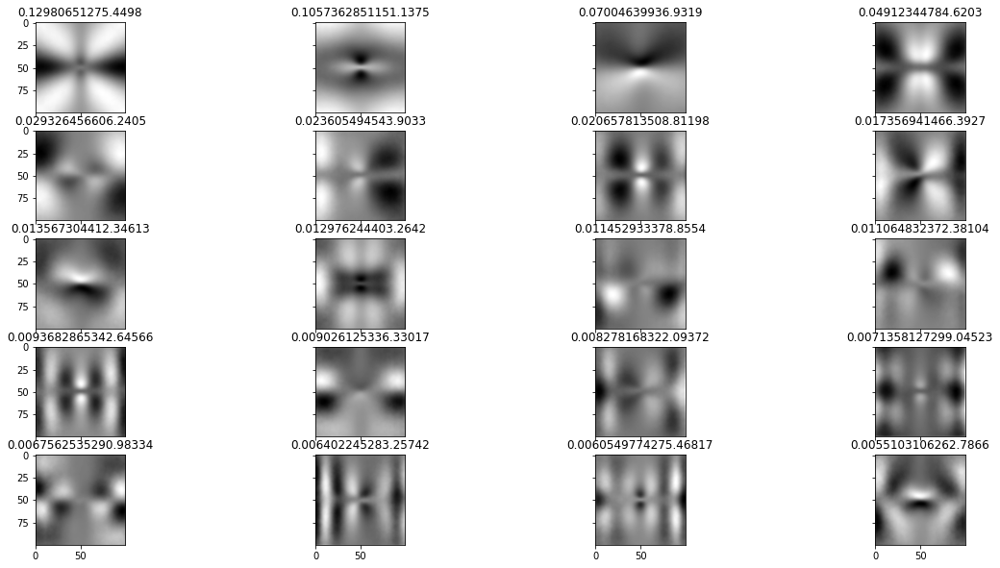

In [44]:
# plot PCA components
fig, axes = plt.subplots(5, 4, figsize=(20, 10), sharex=True, sharey=True)
ax = axes.ravel()

i = 0

for row, var, val in zip(pca_matrix, pca.explained_variance_ratio_, pca.singular_values_):
    
    component = row.reshape([100, 100])
    ax[i].set_title(str(var) + str(val))
    ax[i].imshow(component, cmap='gray', )

    print(i, end='\r')
    i += 1
    if i == 20:
        break


49.472062826156616


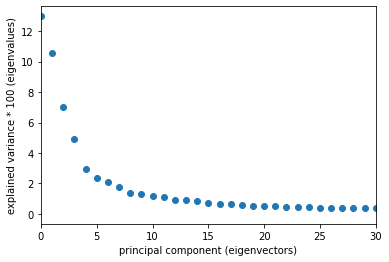

In [45]:
# reconstruct original images from components

y = (pca.explained_variance_ratio_*100).tolist()
x = list(range(0, len(y)))

print(sum(y[:12]))
plt.xlabel('principal component (eigenvectors)')
plt.ylabel('explained variance * 100 (eigenvalues)')
plt.xlim(0, 30)
plt.scatter(x, y)

In [47]:
# conduct PCA on residuals

NO_COMPONENTS = res_data_matrix.shape[0]

res_pca = decomposition.PCA()
res_pca.fit(res_data_matrix)

res_pca_matrix = res_pca.components_[:NO_COMPONENTS]

print(res_pca.explained_variance_ratio_)
print(res_pca.components_)

[7.57900052e-01 8.71420700e-02 5.83760737e-02 ... 4.00148625e-17
 3.85922138e-17 3.53124010e-17]
[[ 6.45039240e-03  6.45491009e-03  6.46489535e-03 ...  7.20254946e-03
   7.19694594e-03  7.19839461e-03]
 [-1.26258439e-02 -1.26156695e-02 -1.25891265e-02 ... -1.09012841e-02
  -1.09095548e-02 -1.09370902e-02]
 [-1.60427862e-04 -1.65002244e-04 -1.79651633e-04 ...  5.90219103e-03
   5.89411038e-03  5.90148864e-03]
 ...
 [-1.60136161e-06  1.43776702e-04 -4.05099293e-04 ... -2.44876383e-03
   5.37365218e-04  4.76183905e-07]
 [ 2.92418800e-06 -7.30231034e-04  2.55441837e-03 ...  2.99957593e-03
  -7.24565230e-04 -3.64529960e-06]
 [ 4.42489483e-07  3.97900523e-04 -1.89620271e-03 ... -3.11431531e-03
   7.65620836e-04 -7.57989157e-07]]


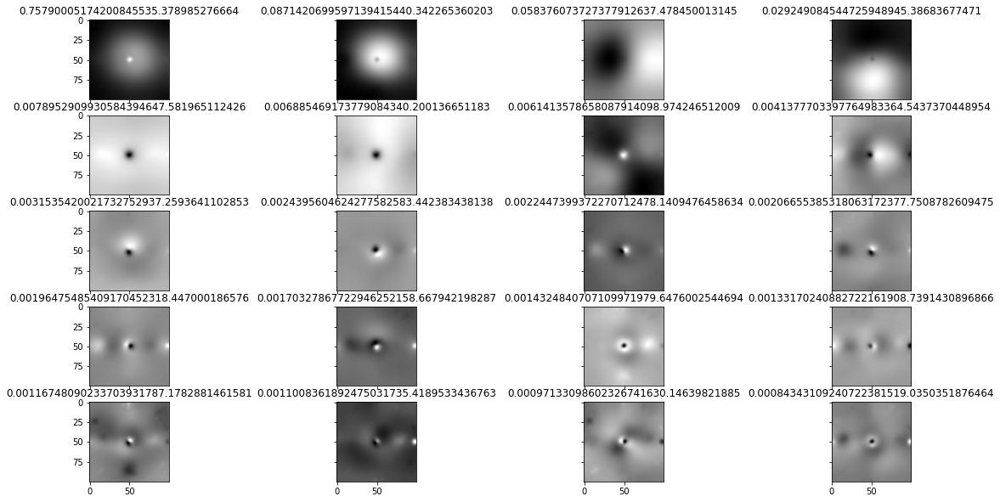

In [48]:
# plot PCA components
fig, axes = plt.subplots(5, 4, figsize=(20, 10), sharex=True, sharey=True)
ax = axes.ravel()

i = 0

for row, var, val in zip(res_pca_matrix, res_pca.explained_variance_ratio_, res_pca.singular_values_):
    component = row.reshape([100, 100])
    ax[i].set_title(str(var) + str(val))
    ax[i].imshow(component, cmap='gray')

    print(i, end='\r')
    i += 1
    if i == 20:
        break


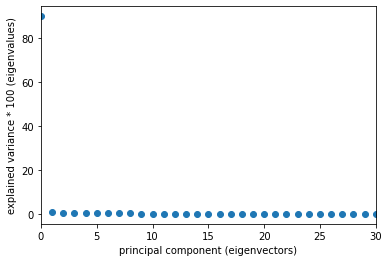

In [7]:
# reconstruct original images from components


yres = (res_pca.explained_variance_ratio_*100).tolist()
xres = list(range(0, len(yres)))

plt.xlabel('principal component (eigenvectors)')
plt.ylabel('explained variance * 100 (eigenvalues)')
plt.xlim(0, 30)
plt.scatter(xres, yres)

In [9]:
print(data_matrix[:10000].shape)

(10000, 10000)


In [8]:
# conduct NMF

# delete full_data to free up ram

print('start')
full_data = 0

NO_COMPONENTS = 15

nmf = decomposition.NMF(n_components=NO_COMPONENTS, init='random', verbose=1, max_iter=10000)
nmf.fit(data_matrix[:NO_COMPONENTS])

nmf_matrix = nmf.components_[:NO_COMPONENTS]



start
violation: 1.0
violation: 0.532247207591503
violation: 0.1786970100812046
violation: 0.0832480164837159
violation: 0.055293359379558905
violation: 0.03735342381831235
violation: 0.02830817252451675
violation: 0.024775163303945354
violation: 0.02269803149827035
violation: 0.021583062623297317
violation: 0.020109830939789304
violation: 0.017969871388712786
violation: 0.015709665771848798
violation: 0.01404057042786625
violation: 0.01275585547039677
violation: 0.011750675664752293
violation: 0.011010830912905951
violation: 0.010451196183029334
violation: 0.010011141397973754
violation: 0.009591989170282925
violation: 0.009032144924737529
violation: 0.008511985724064652
violation: 0.008101266808351644
violation: 0.007625542695408476
violation: 0.007313566513169307
violation: 0.006932755448658764
violation: 0.006632338976924714
violation: 0.006386169093249643
violation: 0.006144424360200736
violation: 0.005897111942250012
violation: 0.0056341381259548936
violation: 0.00540790429120370

violation: 0.000497767149757631
violation: 0.0004957322211668767
violation: 0.0004937303101830385
violation: 0.0004918125577225877
violation: 0.0004898350493921795
violation: 0.0004879868036527431
violation: 0.0004859624937898412
violation: 0.0004840411932448437
violation: 0.0004823058480662029
violation: 0.00048037038070880615
violation: 0.0004783759615437772
violation: 0.00047657073952019454
violation: 0.0004737990345815307
violation: 0.0004702361195518199
violation: 0.00046802043009258864
violation: 0.00046608432459048927
violation: 0.0004635644826030735
violation: 0.00045932685717923436
violation: 0.0004567849736737885
violation: 0.0004546765435761813
violation: 0.0004526458139775707
violation: 0.00045082281324257173
violation: 0.00044995366015754116
violation: 0.0004466141978769157
violation: 0.0004439856543208479
violation: 0.000441320455733059
violation: 0.0004381009774194288
violation: 0.00043520516609899055
violation: 0.0004332434327056321
violation: 0.000431440980230059
viola

violation: 0.0001882224137016641
violation: 0.00018803788139799428
violation: 0.00018757733874752753
violation: 0.00018724688827614618
violation: 0.0001869472857196917
violation: 0.00018649653220896383
violation: 0.00018626673630153394
violation: 0.00018596930981851556
violation: 0.00018544830933891825
violation: 0.0001852153609966572
violation: 0.00018486505784357594
violation: 0.00018461366711940784
violation: 0.00018426929871206136
violation: 0.00018390174012622
violation: 0.00018366253796587282
violation: 0.00018336714078300893
violation: 0.00018299139480063237
violation: 0.00018277084560994411
violation: 0.00018244241167582318
violation: 0.00018205713819303585
violation: 0.00018189159069427032
violation: 0.00018145019238488354
violation: 0.00018118042947472572
violation: 0.0001808214986052644
violation: 0.00018056939954047636
violation: 0.00018037945576972794
violation: 0.00018012718440587016
violation: 0.00017970268416820994
violation: 0.00017950590586769598
violation: 0.00017926

violation: 0.00013218556492165562
violation: 0.0001320596621625432
violation: 0.00013194363469270454
violation: 0.00013176036272482248
violation: 0.00013164778123637822
violation: 0.00013154481658860312
violation: 0.00013142751921080614
violation: 0.0001313381661895389
violation: 0.0001312055150501958
violation: 0.00013110344380500445
violation: 0.00013094786093577104
violation: 0.0001307958070067434
violation: 0.00013069975027537464
violation: 0.00013063940731229058
violation: 0.00013048905403889555
violation: 0.00013019165308166526
violation: 0.00012967548654819065
violation: 0.0001297020939915683
violation: 0.00012939354464638244
violation: 0.00012938666863721122
violation: 0.0001291987350222762
violation: 0.0001291189414086549
violation: 0.00012908181734057732
violation: 0.00012890948955434598
violation: 0.00012889873043465903
violation: 0.00012870712110623665
violation: 0.0001285678747413915
violation: 0.0001285331118087138
violation: 0.00012830928893570084
violation: 0.0001281455

violation: 0.00010463996268155917
violation: 0.00010451585949050828
violation: 0.00010455402373445119
violation: 0.00010436246545760502
violation: 0.00010428440759757496
violation: 0.0001042899690286587
violation: 0.00010417531676065428
violation: 0.00010399540462463176
violation: 0.00010405386506084296
violation: 0.00010391823059501489
violation: 0.00010394134100542192
violation: 0.00010382361607067417
violation: 0.00010387470274484607
violation: 0.00010365741128286492
violation: 0.0001036208264470611
violation: 0.00010355789580720772
violation: 0.00010358493718898317
violation: 0.00010343934128434651
violation: 0.00010333215530936328
violation: 0.00010330816744999007
violation: 0.00010328866893860013
violation: 0.00010310599044529155
violation: 0.00010309913038973789
violation: 0.00010297055061359779
violation: 0.00010292172616239686
violation: 0.00010294460364998741
violation: 0.00010276465960672976
violation: 0.0001026672085291857
violation: 0.00010268161145512486
violation: 0.0001

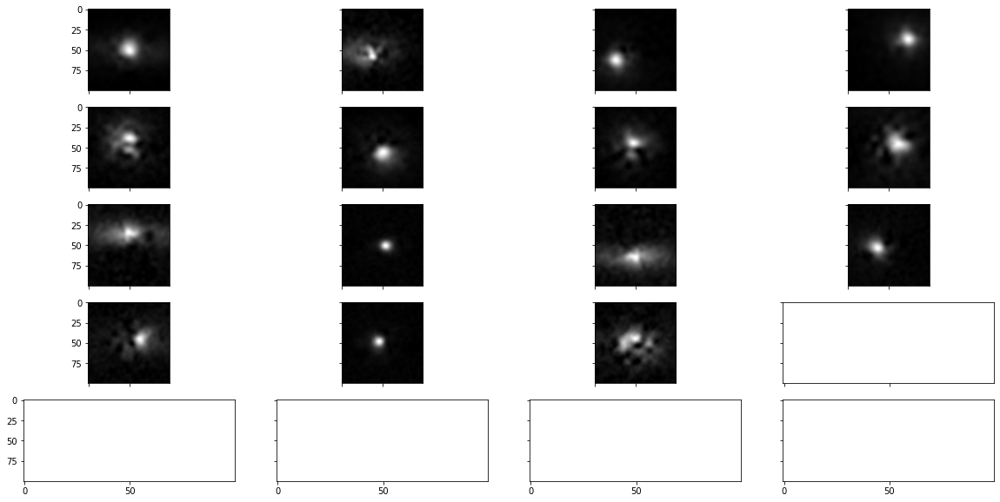

In [9]:
# plot NMF components
fig, axes = plt.subplots(5, 4, figsize=(20, 10), sharex=True, sharey=True)
ax = axes.ravel()

i = 0

for row in nmf_matrix:
    component = row.reshape([100, 100])
    ax[i].imshow(component, cmap='gray',)

    print(i, end='\r')
    i += 1
    
    if i == 20:
        break


In [32]:
# conduct SVD

# delete full_data to free up ram

print('start')
full_data = 0

NO_COMPONENTS = data_matrix.shape[0]

svd = decomposition.TruncatedSVD(n_components=100,)
svd.fit(data_matrix[:1000])

svd_matrix = svd.components_[:NO_COMPONENTS]

start


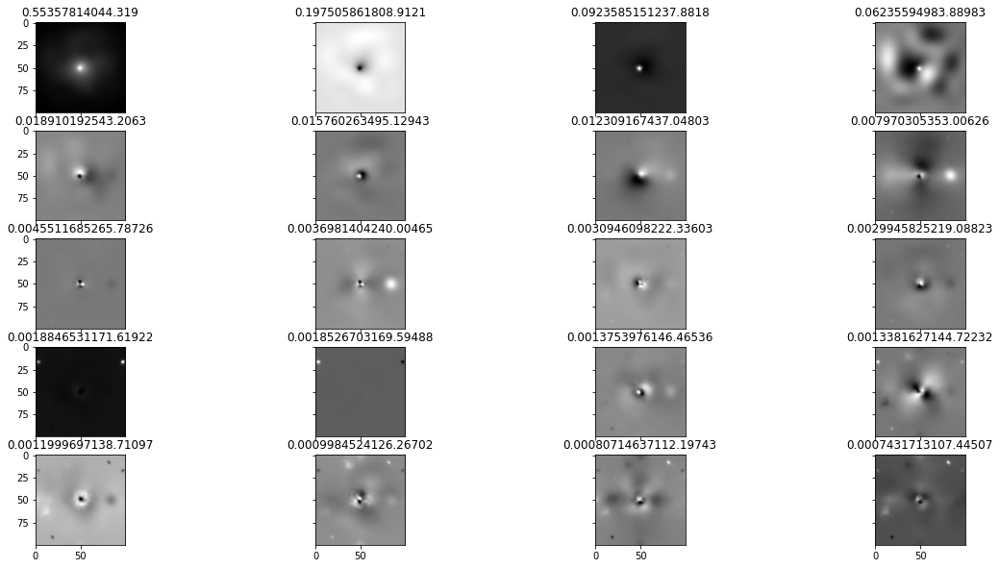

In [33]:
# plot SVD components
fig, axes = plt.subplots(5, 4, figsize=(20, 10), sharex=True, sharey=True)
ax = axes.ravel()

i = 0

for row, var, val in zip(svd_matrix, svd.explained_variance_ratio_, svd.singular_values_):
    
    component = row.reshape([100, 100])
    ax[i].set_title(str(var) + str(val))
    ax[i].imshow(component, cmap='gray', )

    print(i, end='\r')
    i += 1
    if i == 20:
        break

97.50868064165115


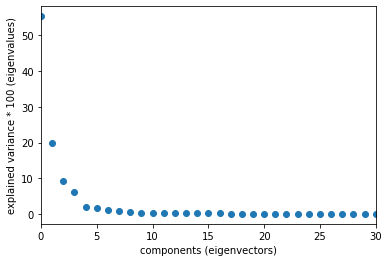

In [34]:
# reconstruct original images from components


ysvd = (svd.explained_variance_ratio_*100).tolist()
xsvd = list(range(0, len(ysvd)))

print(sum(ysvd[:12]))

plt.xlabel('components (eigenvectors)')
plt.ylabel('explained variance * 100 (eigenvalues)')
plt.xlim(0, 30)
plt.scatter(xsvd, ysvd)

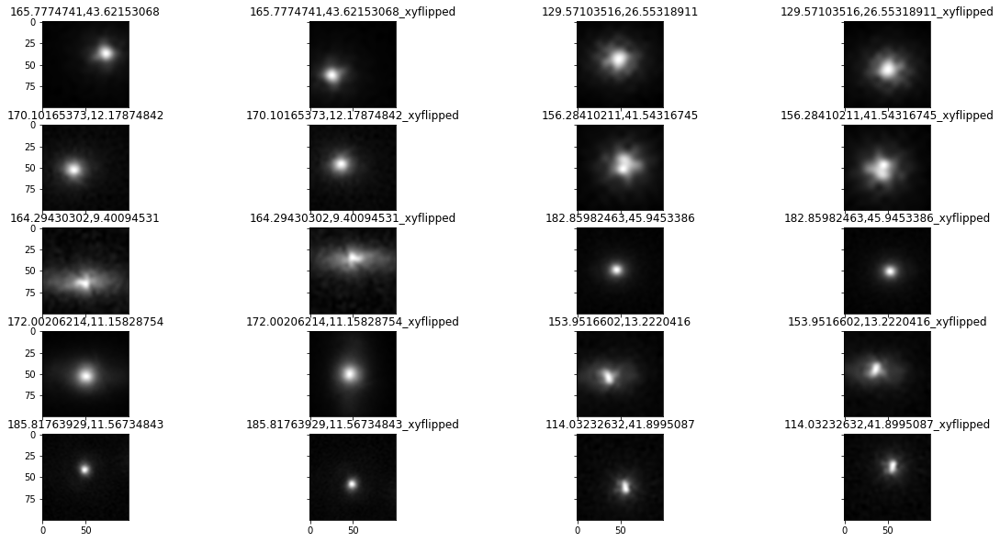

In [19]:
fig, axes = plt.subplots(5, 4, figsize=(20, 10), sharex=True, sharey=True)
ax = axes.ravel()

i = 0

for galaxy, item in full_data.items():
    ax[i].imshow(item, cmap='gray')
    ax[i].set_title(galaxy)
    i += 1
    if i ==20:
        break
    
    

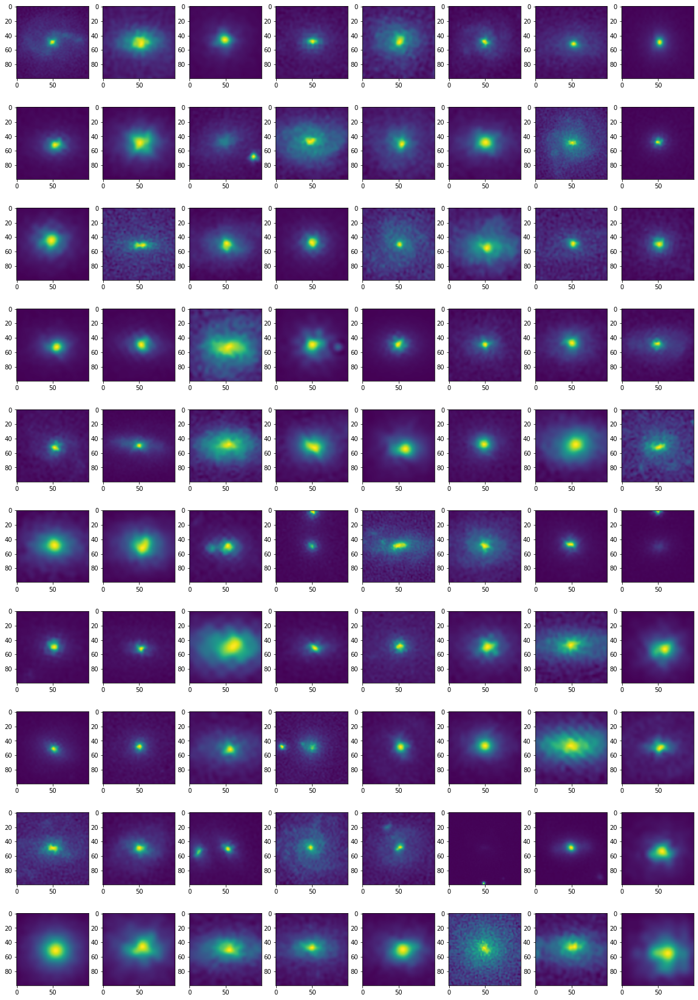

In [56]:
fig, axes = plt.subplots(10, 8, figsize=(20, 30), sharex=False, sharey=False)
ax = axes.ravel()

def crop_center(img, mask_constant, rad):
    y, x = img.shape
    rmask = mask_constant * rad
    
    while rmask > y/2 or rmask > x/2:
        mask_constant -= 1
        rmask = mask_constant * rad
         
    startx = x//2 - rmask
    starty = y//2 - rmask   

    endx = startx + (rmask * 2)
    endy = starty + (rmask * 2)
    return img[starty:endy, startx:endx]


MASK_CONSTANT = 1
FINAL_RESOLUTION_PIXELS = 100    


i = 0

for galaxy, model in sersic_fits.items():
    
    masked_image = model[0].copy()
    residual = model[4].copy()
    morph = model[2]
    
    # sersic_fits[galaxy] = [original_img_data, image_model, morph, best_cent, residual]
            
        
    # sigma clipping
    sigmean, sigmed, sigstd = sigma_clipped_stats(masked_image, sigma=3)
    masked_image = masked_image - sigmean
    sigmeanres, sigmedres, sigstdres = sigma_clipped_stats(residual, sigma=3)
    residual = residual - sigmeanres
    
    # translation to center
    sersic_xc = morph.sersic_xc
    sersic_yc = morph.sersic_yc
    xc, yc = model[3][0], model[3][1]

    transx = 150//2 - sersic_xc
    transy = 150//2 - sersic_yc

    masked_image = ndimage.shift(masked_image, (transy, transx), cval=0)
    residual = ndimage.shift(residual, (transy, transx), cval=0)
    

    # rotation
    angle = morph.sersic_theta
    masked_image = ndimage.rotate(masked_image, angle*180/math.pi, cval=0)
    residual = ndimage.rotate(residual, angle*180/math.pi, cval=0)

    # stretch image along y axis
    r80 = round(morph.r80)
    r50 = round(morph.rhalf_ellip)

#     ellipticity = morph.sersic_ellip
#     r80_minor = r80*(1 - ellipticity)
#     new_y = (masked_image.shape[1]**2)/r80_minor
#     y_factor = masked_image.shape[1]/r80_minor
#     masked_image = skimage.transform.rescale(masked_image, (1, 1))

#   # gaussian smoothing
#     masked_image = ndimage.gaussian_filter(masked_image, sigma=1)
    
    

    masked_image = crop_center(masked_image, MASK_CONSTANT, r80)
    
    residual = crop_center(residual, MASK_CONSTANT, r80)
    
    try:
        zoom_factor_x = FINAL_RESOLUTION_PIXELS/round(masked_image.shape[0])
    except:
        zoom_factor_x = 1
        
    try:
        zoom_factor_y = FINAL_RESOLUTION_PIXELS/round(masked_image.shape[1])
    except:
        zoom_factor_y = 1
    
    masked_image = ndimage.zoom(masked_image, (zoom_factor_x, zoom_factor_y))
    residual = ndimage.zoom(residual, (zoom_factor_x, zoom_factor_y))
    
    ax[i].imshow(masked_image)
    i+=1
    if i==80:
        break
    
# plt.tight_layout()
# plt.show()